# Analyis for the Dark Machines Collider Unsupervised Challenge
This notebook examines the results for the [hackathon dataset](https://zenodo.org/record/3961917#.X2tooJNKhQM). The methods were trained on background only samples and then applied to a mix of background and signal. In this step of the challenge, truth information was available. This was used to determine the receiver operating characteristic (ROC) curve, the area under the ROC curve (AUC), and the signal effeficency at different fixed background rejection working points.

There are 554 different models which were submitted. They are applied to 19 different dark matter signals across 4 channels, for a combined 34 unique channel + signature combinations.

Notebook author: Bryan Ostdiek (bostdiek at g.harvard.edu)

In [64]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gs
from matplotlib.patches import Patch

from scipy.interpolate import interp1d

from os import walk, path

from sklearn.metrics import roc_curve, auc
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import MinMaxScaler

In [2]:
plt.rcParams.update({'font.family': 'cmr10',
                     'font.size': 12,
                     'axes.unicode_minus': False,
                     'axes.labelsize': 12,
                     'axes.labelsize': 12,
                     'figure.figsize': (4, 4),
                     'figure.dpi': 160,
                     'mathtext.fontset': 'cm',
                     'mathtext.rm': 'serif',
                     'xtick.direction': 'in',
                     'ytick.direction': 'in',
                     'xtick.top': True,
                     'ytick.right': True
                     })

# Load Data Files
## Adam Leinweber - Traditional VAE

In [3]:
AL = pd.read_csv('../data/all_csv/Adam_Leinweber_latent_combined_scores_all.csv',
            names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
           )

## Pratik Jawahar - Normalizing Flows

In [4]:
PJ = pd.read_csv('../data/all_csv/VAEwNormFlows_Results.csv',
                 names=['Signal', 'Model', 'AUC', '1e-2', '1e-3', '1e-4']
           )
snames = list(PJ['Signal'])
chan = [s.split('/')[0].replace('chan', '').replace('_sig', '') for s in snames]
snames = [s.split('/')[-1] for s in snames]

snames = ['_'.join(s.split('_')[:-1]) for s in snames]
PJ['Signal'] = snames
PJ['Chan'] = chan

## Alessandro Morandini - Density based models

In [5]:
AM = pd.read_csv('../data/all_csv/DE_scores.csv',
                 names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                )

## Luc Hendrix - VAE_AUC

In [6]:
LH_VAE = pd.read_csv('../data/all_csv/vae_auc_scores.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_VAE['Model'] = LH_VAE['Modelt'] + '_' + LH_VAE['Metric']
LH_VAE['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_VAE['Model'])]

## Luc Hendrix - Flow

In [7]:
LH_Flow = pd.read_csv('../data/all_csv/flow_auc_scores.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Flow['Model'] = LH_Flow['Modelt'] + '_' + LH_Flow['Metric']
LH_Flow['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_Flow['Model'])]

## Luc Hendrix - Combined

In [8]:
LH_Combined = pd.read_csv('../data/all_csv/combined_scores.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Combined['Model'] = LH_Combined['Modelt'] + '_' + LH_Combined['Metric']
LH_Combined['Model'] = [s.replace('VAE Radius', 'Fixed target KL') for s in list(LH_Combined['Model'])]

## Luc Hendrix - Fixed Target

In [9]:
LH_Fixed = pd.read_csv('../data/all_csv/results-fixed-target.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Fixed['Model'] = LH_Fixed['Modelt'] + '_' + LH_Fixed['Metric']

In [10]:
LH_Fixed['Model'].unique().shape

(80,)

## Bryan Ostdiek - Deep Sets

In [11]:
BO = pd.read_csv('../data/all_csv/DeepSetsVAE_8d_results_combined.csv')
snames = list(BO['Signal'])
chan = [s.split('_')[-1].replace('chan', '') for s in snames]
sig = ['_'.join(s.split('_')[:-1]) for s in snames]
BO['Signal'] = sig
BO['Chan'] = chan
BO['Model'] = BO['ModelName']
BO['1e-2'] = BO['S1e-2']
BO['1e-3'] = BO['S1e-3']
BO['1e-4'] = BO['S1e-4']

In [12]:
BO['Model'] = [s.replace('VAE_beta_1.0_', ' Fixed target KL ') for s in list(BO['Model'])]

## Baptiste Ravina - Standard Autoencoder

In [13]:
BR = pd.read_csv('../data/all_csv/CrudeAE_data.csv')
snames = list(BR['Signal'])
chan = [s.split('_')[-1].replace('chan', '') for s in snames]
sig = ['_'.join(s.split('_')[:-1]) for s in snames]
BR['Signal'] = sig
BR['Chan'] = chan
BR['Model'] = BR['ModelName']
BR['1e-2'] = BR['S1e-2']
BR['1e-3'] = BR['S1e-3']
BR['1e-4'] = BR['S1e-4']

In [14]:
incomplete_models = []
for Chan in ['1', '2a' ,'2b', '3']:
    with open(f'Missing_BR_chan{Chan}.txt', 'w') as f:
        for mod in list(BR['Model'].unique()):
            if mod not in list(BR[BR['Chan'] == Chan]['Model']):
                print(f'Missing Chan {Chan} for {mod}')
                f.write(f'Missing Chan {Chan} for {mod}')
                f.write('\n')
                incomplete_models.append(mod)

## Roberto Ruiz - ALAD

In [15]:
RR_ALAD = pd.read_csv('../data/all_csv/alad_scores.csv',
                      names=['Signal', 'Modelt', 'Chan', 'Metric', 'AUC', '1e-2', '1e-3', '1e-4']
                     )
RR_ALAD['Model'] = RR_ALAD['Modelt'] + '_' + RR_ALAD['Metric']
chan = [s.split('_')[-1].replace('chan', '') for s in list(RR_ALAD['Chan'])]
RR_ALAD['Chan'] = chan
RR_ALAD.loc[RR_ALAD['Signal'] == 'monoV_Zp2000', 'Signal'] = 'monoV_Zp2000.0_DM_1.0'
RR_ALAD.loc[RR_ALAD['Signal'] == 'monojet_Zp2000.0_DM_50', 'Signal'] = 'monojet_Zp2000.0_DM_50.0'


In [16]:
RR_ALAD

,Signal,Modelt,Chan,Metric,AUC,1e-2,1e-3,1e-4,Model
0,glgl1400_neutralino1100,ld20_lr1e-5_bs100_epoch2000_enc512,1,L_1,0.679454,0.046875,0.003418,0.001709,ld20_lr1e-5_bs100_epoch2000_enc512_L_1
1,glgl1400_neutralino1100,ld20_lr1e-5_bs100_epoch2000_enc512,1,L_2,0.668250,0.061035,0.014404,0.003174,ld20_lr1e-5_bs100_epoch2000_enc512_L_2
2,glgl1400_neutralino1100,ld20_lr1e-5_bs100_epoch2000_enc512,1,L_sc,0.675525,0.061035,0.011475,0.002930,ld20_lr1e-5_bs100_epoch2000_enc512_L_sc
3,glgl1400_neutralino1100,ld20_lr1e-5_bs100_epoch2000_enc512,1,F_sc,0.680922,0.025635,0.003174,0.000977,ld20_lr1e-5_bs100_epoch2000_enc512_F_sc
4,glgl1600_neutralino800,ld20_lr1e-5_bs100_epoch2000_enc512,1,L_1,0.688415,0.044630,0.006137,0.003068,ld20_lr1e-5_bs100_epoch2000_enc512_L_1
...,...,...,...,...,...,...,...,...,...
1711,stlp_st1000,ld30_lr1e-5_bs10000_epoch2000_enc512,3,F_sc,0.979871,0.850675,0.471509,0.114112,ld30_lr1e-5_bs10000_epoch2000_enc512_F_sc
1712,stop2b1000_neutralino300,ld30_lr1e-5_bs10000_epoch2000_enc512,3,L_1,0.910065,0.197911,0.028858,0.004307,ld30_lr1e-5_bs10000_epoch2000_enc512_L_1
1713,stop2b1000_neutralino300,ld30_lr1e-5_bs10000_epoch2000_enc512,3,L_2,0.890675,0.141488,0.030903,0.007968,ld30_lr1e-5_bs10000_epoch2000_enc512_L_2
1714,stop2b1000_neutralino300,ld30_lr1e-5_bs10000_epoch2000_enc512,3,L_sc,0.900429,0.179283,0.029934,0.005492,ld30_lr1e-5_bs10000_epoch2000_enc512_L_sc


In [17]:
incomplete_models = []
for Chan in ['1', '2a' ,'2b', '3']:
    with open(f'Missing_ALAD_chan{Chan}.txt', 'w') as f:
        for mod in list(RR_ALAD['Model'].unique()):
            if mod not in list(RR_ALAD[RR_ALAD['Chan'] == Chan]['Model']):
                print(f'Missing Chan {Chan} for {mod}')
                f.write(f'Missing Chan {Chan} for {mod}')
                f.write('\n')
                incomplete_models.append(mod)

Missing Chan 1 for ld5_lr1e-5_bs500_epoch2000_enc512_L_1
Missing Chan 1 for ld5_lr1e-5_bs500_epoch2000_enc512_L_2
Missing Chan 1 for ld5_lr1e-5_bs500_epoch2000_enc512_L_sc
Missing Chan 1 for ld5_lr1e-5_bs500_epoch2000_enc512_F_sc
Missing Chan 1 for ld30_lr1e-5_bs50_epoch2000_enc512_L_1
Missing Chan 1 for ld30_lr1e-5_bs50_epoch2000_enc512_L_2
Missing Chan 1 for ld30_lr1e-5_bs50_epoch2000_enc512_L_sc
Missing Chan 1 for ld30_lr1e-5_bs50_epoch2000_enc512_F_sc
Missing Chan 1 for ld50_lr1e-5_bs50_epoch2000_enc512_L_1
Missing Chan 1 for ld50_lr1e-5_bs50_epoch2000_enc512_L_2
Missing Chan 1 for ld50_lr1e-5_bs50_epoch2000_enc512_L_sc
Missing Chan 1 for ld50_lr1e-5_bs50_epoch2000_enc512_F_sc
Missing Chan 1 for ld5_lr1e-5_bs100_epoch2000_enc512_L_1
Missing Chan 1 for ld5_lr1e-5_bs100_epoch2000_enc512_L_2
Missing Chan 1 for ld5_lr1e-5_bs100_epoch2000_enc512_L_sc
Missing Chan 1 for ld5_lr1e-5_bs100_epoch2000_enc512_F_sc
Missing Chan 1 for ld40_lr1e-5_bs50_epoch2000_enc512_L_1
Missing Chan 1 for ld40

Missing Chan 3 for ld20_lr1e-5_bs1000_epoch2000_enc512_L_1
Missing Chan 3 for ld20_lr1e-5_bs1000_epoch2000_enc512_L_2
Missing Chan 3 for ld20_lr1e-5_bs1000_epoch2000_enc512_L_sc
Missing Chan 3 for ld20_lr1e-5_bs1000_epoch2000_enc512_F_sc
Missing Chan 3 for ld30_lr1e-5_bs1000_epoch2000_enc512_L_1
Missing Chan 3 for ld30_lr1e-5_bs1000_epoch2000_enc512_L_2
Missing Chan 3 for ld30_lr1e-5_bs1000_epoch2000_enc512_L_sc
Missing Chan 3 for ld30_lr1e-5_bs1000_epoch2000_enc512_F_sc
Missing Chan 3 for ld5_lr1e-5_bs50_epoch2000_enc512_L_1
Missing Chan 3 for ld5_lr1e-5_bs50_epoch2000_enc512_L_2
Missing Chan 3 for ld5_lr1e-5_bs50_epoch2000_enc512_L_sc
Missing Chan 3 for ld5_lr1e-5_bs50_epoch2000_enc512_F_sc
Missing Chan 3 for ld10_lr1e-5_bs1000_epoch2000_enc512_L_1
Missing Chan 3 for ld10_lr1e-5_bs1000_epoch2000_enc512_L_2
Missing Chan 3 for ld10_lr1e-5_bs1000_epoch2000_enc512_L_sc
Missing Chan 3 for ld10_lr1e-5_bs1000_epoch2000_enc512_F_sc
Missing Chan 3 for ld40_lr1e-5_bs1000_epoch2000_enc512_L_1
M

## Roberto Ruiz - DAGMM

In [18]:
RR_DAGM = pd.read_csv('../data/all_csv/dagmm_scores.csv',
                      names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                     )
chan = [s.replace('chan', '') for s in list(RR_DAGM['Chan'])]
RR_DAGM['Chan'] = chan

In [19]:
incomplete_models = []
for Chan in ['1', '2a' ,'2b', '3']:
    with open(f'Missing_DAGM_chan{Chan}.txt', 'w') as f:
        for mod in list(RR_DAGM['Model'].unique()):
            if mod not in list(RR_DAGM[RR_DAGM['Chan'] == Chan]['Model']):
                print(f'Missing Chan {Chan} for {mod}')
                f.write(f'Missing Chan {Chan} for {mod}')
                f.write('\n')
                incomplete_models.append(mod)

Missing Chan 1 for 40_1e-05_500_0.001_0.0001_100_10_16
Missing Chan 1 for 40_0.0001_1000_0.0001_0.001_50_10_4
Missing Chan 1 for 40_1e-05_10000_0.0001_0.0001_50_30_16
Missing Chan 1 for 20_1e-05_1000_0.0001_0.0001_50_30_16
Missing Chan 1 for 40_1e-05_1000_0.001_0.0001_100_10_16
Missing Chan 1 for 40_1e-05_500_0.001_0.001_50_20_8
Missing Chan 1 for 20_1e-05_10000_0.0001_0.001_50_30_8
Missing Chan 1 for 30_1e-05_10000_0.0001_0.0001_100_20_4
Missing Chan 1 for 40_1e-05_500_0.0001_0.001_50_20_4
Missing Chan 1 for 30_1e-05_500_0.001_0.0001_50_10_4
Missing Chan 1 for 30_1e-05_1000_0.0001_0.001_100_20_8
Missing Chan 1 for 30_1e-05_500_0.0001_0.001_50_10_16
Missing Chan 1 for 40_1e-05_500_0.0001_0.0001_100_30_4
Missing Chan 1 for 40_0.0001_1000_0.0001_0.001_50_10_8
Missing Chan 1 for 40_1e-05_500_0.001_0.0001_50_10_8
Missing Chan 1 for 20_1e-05_500_0.001_0.0001_50_10_8
Missing Chan 1 for 30_1e-05_500_0.0001_0.001_50_20_4
Missing Chan 1 for 40_1e-05_500_0.0001_0.001_100_10_8
Missing Chan 1 for 

Missing Chan 1 for 40_1e-05_1000_0.001_0.001_50_10_4
Missing Chan 1 for 40_0.0001_10000_0.001_0.0001_50_10_16
Missing Chan 1 for 40_1e-05_500_0.0001_0.001_50_10_16
Missing Chan 1 for 20_1e-05_10000_0.0001_0.0001_50_20_4
Missing Chan 1 for 30_1e-05_500_0.0001_0.001_100_30_4
Missing Chan 1 for 40_0.0001_500_0.0001_0.0001_100_10_8
Missing Chan 1 for 20_1e-05_10000_0.0001_0.0001_50_10_4
Missing Chan 1 for 30_1e-05_1000_0.0001_0.0001_100_10_8
Missing Chan 1 for 40_0.0001_500_0.001_0.001_100_20_8
Missing Chan 1 for 20_1e-05_500_0.001_0.0001_100_30_4
Missing Chan 1 for 40_1e-05_1000_0.0001_0.0001_100_10_16
Missing Chan 1 for 30_1e-05_1000_0.001_0.001_50_20_8
Missing Chan 1 for 20_1e-05_10000_0.001_0.0001_100_30_16
Missing Chan 1 for 20_1e-05_10000_0.0001_0.001_50_20_16
Missing Chan 1 for 30_1e-05_10000_0.001_0.001_100_20_4
Missing Chan 1 for 40_0.0001_500_0.001_0.0001_100_30_4
Missing Chan 1 for 30_1e-05_1000_0.0001_0.001_100_10_8
Missing Chan 1 for 40_0.0001_1000_0.001_0.001_50_30_4
Missing 

Missing Chan 1 for 40_0.0001_10000_0.001_0.0001_50_10_8
Missing Chan 1 for 40_0.0001_1000_0.0001_0.0001_100_10_16
Missing Chan 1 for 30_1e-05_1000_0.001_0.0001_100_30_4
Missing Chan 1 for 20_1e-05_10000_0.001_0.001_100_10_16
Missing Chan 1 for 40_1e-05_10000_0.0001_0.001_100_30_8
Missing Chan 1 for 30_1e-05_500_0.0001_0.0001_50_20_8
Missing Chan 1 for 20_1e-05_500_0.001_0.0001_50_10_4
Missing Chan 1 for 30_1e-05_10000_0.001_0.0001_50_20_4
Missing Chan 1 for 20_1e-05_500_0.0001_0.001_50_10_8
Missing Chan 1 for 30_1e-05_1000_0.001_0.0001_50_10_8
Missing Chan 1 for 40_1e-05_500_0.0001_0.0001_100_20_8
Missing Chan 1 for 30_0.0001_500_0.0001_0.0001_100_20_4
Missing Chan 1 for 30_1e-05_10000_0.001_0.0001_100_10_4
Missing Chan 1 for 30_1e-05_1000_0.0001_0.0001_100_20_4
Missing Chan 1 for 40_0.0001_500_0.001_0.0001_50_20_16
Missing Chan 1 for 30_0.0001_500_0.0001_0.0001_50_30_8
Missing Chan 1 for 20_1e-05_1000_0.001_0.001_100_20_8
Missing Chan 1 for 20_1e-05_10000_0.001_0.0001_100_20_16
Missin

Missing Chan 1 for 40_1e-05_500_0.0001_0.0001_100_30_16
Missing Chan 1 for 20_1e-05_500_0.001_0.001_100_30_8
Missing Chan 1 for 20_1e-05_1000_0.001_0.0001_100_20_4
Missing Chan 1 for 30_1e-05_500_0.001_0.001_50_20_16
Missing Chan 1 for 30_1e-05_500_0.0001_0.0001_50_30_16
Missing Chan 1 for 20_1e-05_500_0.0001_0.001_50_20_4
Missing Chan 1 for 30_1e-05_500_0.0001_0.001_100_20_8
Missing Chan 1 for 40_0.0001_500_0.001_0.001_100_20_16
Missing Chan 1 for 40_0.0001_500_0.001_0.001_50_20_4
Missing Chan 1 for 40_0.0001_1000_0.001_0.0001_100_30_8
Missing Chan 1 for 20_1e-05_10000_0.001_0.001_50_20_16
Missing Chan 1 for 40_1e-05_10000_0.0001_0.0001_100_20_16
Missing Chan 1 for 40_0.0001_500_0.0001_0.001_50_30_16
Missing Chan 1 for 30_1e-05_1000_0.001_0.001_100_30_16
Missing Chan 1 for 40_0.0001_500_0.0001_0.0001_100_20_8
Missing Chan 1 for 40_1e-05_500_0.001_0.0001_100_10_4
Missing Chan 1 for 40_1e-05_10000_0.001_0.001_50_30_8
Missing Chan 1 for 40_1e-05_1000_0.001_0.0001_50_20_8
Missing Chan 1 f

Missing Chan 2a for 20_0.0001_70000_0.001_0.001_100_10_4
Missing Chan 2a for 30_1e-06_50000_0.001_0.001_50_30_4
Missing Chan 2a for 30_1e-06_50000_0.001_0.001_40_20_4
Missing Chan 2a for 30_1e-06_50000_0.001_0.0001_40_30_4
Missing Chan 2a for 30_1e-06_50000_0.001_0.0001_40_20_16
Missing Chan 2a for 40_1e-05_70000_0.001_0.001_50_10_8
Missing Chan 2a for 30_1e-06_50000_0.001_0.001_40_10_8
Missing Chan 2a for 30_1e-06_50000_0.001_0.0001_40_10_8
Missing Chan 2a for 30_1e-06_50000_0.001_0.001_100_10_8
Missing Chan 2a for 30_1e-06_50000_0.001_0.0001_50_10_8
Missing Chan 2a for 40_1e-06_30000_0.001_0.001_40_10_4
Missing Chan 2a for 20_0.0001_70000_0.001_0.001_50_10_16
Missing Chan 2a for 20_0.0001_70000_0.001_0.001_50_20_16
Missing Chan 2a for 40_1e-06_30000_0.001_0.001_40_10_8
Missing Chan 2a for 40_1e-05_70000_0.001_0.001_50_20_8
Missing Chan 2a for 20_0.0001_50000_0.001_0.001_50_10_8
Missing Chan 2a for 30_1e-06_50000_0.001_0.001_100_30_16
Missing Chan 2a for 30_1e-06_50000_0.001_0.001_50_

Missing Chan 2b for 20_1e-05_10000_0.001_0.001_50_20_8
Missing Chan 2b for 30_1e-05_500_0.001_0.001_50_10_16
Missing Chan 2b for 40_0.0001_1000_0.0001_0.0001_50_30_4
Missing Chan 2b for 30_1e-05_10000_0.001_0.001_50_30_4
Missing Chan 2b for 40_1e-05_1000_0.0001_0.0001_50_20_8
Missing Chan 2b for 40_1e-05_10000_0.001_0.0001_50_10_16
Missing Chan 2b for 20_1e-05_1000_0.0001_0.0001_50_10_4
Missing Chan 2b for 30_1e-05_500_0.001_0.001_100_10_8
Missing Chan 2b for 40_0.0001_500_0.0001_0.0001_50_30_8
Missing Chan 2b for 40_0.0001_500_0.0001_0.001_100_20_16
Missing Chan 2b for 40_0.0001_1000_0.0001_0.0001_100_10_8
Missing Chan 2b for 40_1e-05_1000_0.0001_0.001_50_30_8
Missing Chan 2b for 30_1e-05_10000_0.001_0.001_100_30_4
Missing Chan 2b for 20_1e-05_500_0.001_0.0001_100_30_16
Missing Chan 2b for 30_1e-05_1000_0.0001_0.0001_50_20_16
Missing Chan 2b for 40_0.0001_10000_0.001_0.001_50_30_4
Missing Chan 2b for 40_0.0001_500_0.001_0.0001_50_20_8
Missing Chan 2b for 20_1e-05_1000_0.0001_0.0001_50

Missing Chan 2b for 40_0.0001_1000_0.0001_0.0001_50_10_8
Missing Chan 2b for 30_1e-05_10000_0.001_0.001_100_10_8
Missing Chan 2b for 40_0.0001_500_0.0001_0.0001_100_10_4
Missing Chan 2b for 40_0.0001_10000_0.0001_0.0001_100_10_8
Missing Chan 2b for 40_0.0001_1000_0.001_0.001_50_20_4
Missing Chan 2b for 40_1e-05_1000_0.0001_0.001_100_10_16
Missing Chan 2b for 20_1e-05_10000_0.001_0.0001_50_10_4
Missing Chan 2b for 40_1e-05_1000_0.001_0.0001_100_10_4
Missing Chan 2b for 40_1e-05_500_0.001_0.001_100_30_16
Missing Chan 2b for 30_1e-05_500_0.001_0.0001_50_20_16
Missing Chan 2b for 40_0.0001_10000_0.0001_0.0001_100_30_8
Missing Chan 2b for 40_0.0001_500_0.001_0.0001_50_30_8
Missing Chan 2b for 40_1e-05_500_0.001_0.001_100_20_8
Missing Chan 2b for 40_0.0001_500_0.0001_0.0001_50_20_16
Missing Chan 2b for 20_1e-05_10000_0.0001_0.001_100_20_4
Missing Chan 2b for 30_1e-05_1000_0.0001_0.001_100_30_4
Missing Chan 2b for 20_1e-05_1000_0.001_0.001_50_10_8
Missing Chan 2b for 40_0.0001_500_0.001_0.000

Missing Chan 2b for 30_1e-05_500_0.0001_0.001_50_10_4
Missing Chan 2b for 20_1e-05_500_0.0001_0.001_100_30_4
Missing Chan 2b for 20_1e-05_500_0.001_0.001_50_20_16
Missing Chan 2b for 20_1e-05_10000_0.001_0.001_100_30_4
Missing Chan 2b for 40_1e-05_1000_0.001_0.001_100_30_4
Missing Chan 2b for 40_0.0001_10000_0.0001_0.0001_50_20_4
Missing Chan 2b for 30_1e-05_500_0.001_0.0001_50_20_8
Missing Chan 2b for 20_1e-05_500_0.0001_0.001_50_30_4
Missing Chan 2b for 30_1e-05_1000_0.001_0.001_50_30_4
Missing Chan 2b for 20_1e-05_500_0.001_0.0001_50_30_16
Missing Chan 2b for 20_1e-05_500_0.001_0.0001_100_20_16
Missing Chan 2b for 20_1e-05_10000_0.001_0.0001_50_10_8
Missing Chan 2b for 30_1e-05_500_0.0001_0.0001_100_30_8
Missing Chan 2b for 40_1e-05_1000_0.0001_0.001_100_10_8
Missing Chan 2b for 40_0.0001_1000_0.001_0.0001_100_10_8
Missing Chan 2b for 30_1e-05_10000_0.0001_0.0001_100_10_8
Missing Chan 2b for 40_1e-05_1000_0.0001_0.001_50_30_16
Missing Chan 2b for 40_0.0001_500_0.001_0.0001_100_10_8


Missing Chan 2b for 40_1e-05_1000_0.0001_0.001_100_20_8
Missing Chan 2b for 40_0.0001_10000_0.001_0.0001_100_10_8
Missing Chan 2b for 20_1e-05_10000_0.001_0.001_50_10_4
Missing Chan 2b for 30_1e-05_1000_0.001_0.001_100_10_4
Missing Chan 2b for 20_1e-05_10000_0.0001_0.0001_50_30_8
Missing Chan 2b for 30_1e-05_10000_0.001_0.0001_50_30_16
Missing Chan 2b for 30_1e-05_1000_0.001_0.0001_50_10_4
Missing Chan 2b for 20_1e-05_1000_0.001_0.0001_100_30_8
Missing Chan 2b for 30_1e-05_1000_0.001_0.001_100_10_8
Missing Chan 2b for 30_1e-05_10000_0.0001_0.0001_100_10_4
Missing Chan 2b for 20_1e-05_1000_0.001_0.0001_100_10_8
Missing Chan 2b for 40_0.0001_1000_0.0001_0.0001_100_30_8
Missing Chan 2b for 40_1e-05_10000_0.0001_0.0001_100_30_8
Missing Chan 2b for 40_0.0001_1000_0.0001_0.001_100_10_4
Missing Chan 2b for 20_1e-05_1000_0.001_0.001_50_30_8
Missing Chan 2b for 20_1e-05_500_0.0001_0.0001_100_30_16
Missing Chan 2b for 40_0.0001_1000_0.0001_0.001_100_20_16
Missing Chan 2b for 40_1e-05_1000_0.0001

Missing Chan 3 for 20_0.0001_500_0.001_0.001_100_10_4
Missing Chan 3 for 30_0.0001_1000_0.001_0.001_100_10_4
Missing Chan 3 for 20_0.0001_500_0.001_0.001_100_20_8
Missing Chan 3 for 30_0.0001_1000_0.0001_0.001_100_20_4
Missing Chan 3 for 30_0.0001_500_0.001_0.001_100_30_16
Missing Chan 3 for 20_0.0001_10000_0.001_0.0001_50_20_4
Missing Chan 3 for 20_0.0001_1000_0.0001_0.001_50_30_4
Missing Chan 3 for 20_0.0001_10000_0.001_0.0001_100_30_4
Missing Chan 3 for 20_0.0001_500_0.0001_0.001_50_20_16
Missing Chan 3 for 30_0.0001_10000_0.001_0.001_50_30_8
Missing Chan 3 for 20_0.0001_1000_0.001_0.001_50_10_16
Missing Chan 3 for 30_0.0001_1000_0.001_0.0001_50_30_16
Missing Chan 3 for 20_0.0001_10000_0.001_0.001_100_30_16
Missing Chan 3 for 20_0.0001_500_0.0001_0.001_50_10_4
Missing Chan 3 for 30_0.0001_10000_0.001_0.001_100_10_8
Missing Chan 3 for 30_0.0001_10000_0.001_0.0001_100_20_16
Missing Chan 3 for 30_0.0001_1000_0.0001_0.001_50_20_8
Missing Chan 3 for 20_0.0001_10000_0.001_0.001_50_30_4
Mi

Missing Chan 3 for 30_0.0001_1000_0.001_0.001_100_30_16
Missing Chan 3 for 30_0.0001_10000_0.001_0.0001_100_20_8
Missing Chan 3 for 20_0.0001_1000_0.001_0.001_100_20_4
Missing Chan 3 for 30_0.0001_1000_0.001_0.001_50_20_8
Missing Chan 3 for 30_0.0001_10000_0.0001_0.001_100_10_8
Missing Chan 3 for 30_0.0001_1000_0.001_0.0001_100_30_16
Missing Chan 3 for 30_0.0001_500_0.001_0.001_100_20_8
Missing Chan 3 for 20_0.0001_1000_0.001_0.001_100_20_16
Missing Chan 3 for 30_0.0001_500_0.0001_0.001_100_10_4
Missing Chan 3 for 20_0.0001_10000_0.001_0.0001_50_20_8
Missing Chan 3 for 30_0.0001_1000_0.001_0.0001_100_10_8
Missing Chan 3 for 20_0.0001_1000_0.001_0.0001_100_30_8
Missing Chan 3 for 30_0.0001_10000_0.001_0.0001_50_10_16
Missing Chan 3 for 30_0.0001_500_0.001_0.001_100_30_8
Missing Chan 3 for 20_0.0001_500_0.0001_0.001_100_10_8
Missing Chan 3 for 20_0.0001_10000_0.0001_0.0001_100_20_16
Missing Chan 3 for 20_0.0001_10000_0.001_0.0001_100_30_8
Missing Chan 3 for 20_0.0001_500_0.0001_0.001_50_

Missing Chan 3 for 20_1e-05_1000_0.0001_0.0001_50_30_4
Missing Chan 3 for 40_1e-05_1000_0.001_0.001_50_30_16
Missing Chan 3 for 30_0.0001_500_0.0001_0.0001_50_30_4
Missing Chan 3 for 40_0.0001_1000_0.0001_0.001_100_30_8
Missing Chan 3 for 30_1e-05_10000_0.001_0.0001_50_30_8
Missing Chan 3 for 30_0.0001_1000_0.0001_0.0001_50_10_8
Missing Chan 3 for 40_1e-05_500_0.0001_0.001_100_30_4
Missing Chan 3 for 30_0.0001_1000_0.0001_0.0001_100_20_4
Missing Chan 3 for 30_0.0001_1000_0.0001_0.0001_100_10_4
Missing Chan 3 for 20_1e-05_10000_0.0001_0.001_50_10_16
Missing Chan 3 for 20_1e-05_1000_0.001_0.001_100_10_16
Missing Chan 3 for 30_1e-05_10000_0.001_0.001_50_30_8
Missing Chan 3 for 20_1e-05_1000_0.001_0.001_100_30_16
Missing Chan 3 for 20_1e-05_1000_0.001_0.001_100_20_16
Missing Chan 3 for 40_1e-05_10000_0.001_0.001_100_30_8
Missing Chan 3 for 30_1e-05_1000_0.0001_0.001_50_10_4
Missing Chan 3 for 20_1e-05_1000_0.001_0.001_50_10_4
Missing Chan 3 for 30_1e-05_10000_0.0001_0.001_100_10_16
Missing

Missing Chan 3 for 20_1e-05_10000_0.001_0.001_100_10_4
Missing Chan 3 for 30_1e-05_10000_0.0001_0.0001_50_30_4
Missing Chan 3 for 20_1e-05_1000_0.0001_0.0001_50_20_4
Missing Chan 3 for 30_1e-05_1000_0.0001_0.001_50_20_16
Missing Chan 3 for 40_0.0001_1000_0.0001_0.0001_50_10_16
Missing Chan 3 for 30_1e-05_500_0.0001_0.001_50_30_8
Missing Chan 3 for 20_1e-05_500_0.001_0.0001_50_30_8
Missing Chan 3 for 20_1e-05_500_0.001_0.0001_100_10_4
Missing Chan 3 for 30_1e-05_10000_0.001_0.001_50_20_4
Missing Chan 3 for 30_1e-05_1000_0.0001_0.001_100_30_8
Missing Chan 3 for 40_1e-05_10000_0.001_0.001_100_10_8
Missing Chan 3 for 40_0.0001_1000_0.0001_0.0001_50_30_16
Missing Chan 3 for 40_0.0001_10000_0.001_0.0001_50_10_4
Missing Chan 3 for 40_0.0001_1000_0.001_0.001_100_20_8
Missing Chan 3 for 40_0.0001_10000_0.001_0.001_50_10_4
Missing Chan 3 for 30_1e-05_500_0.001_0.0001_50_30_16
Missing Chan 3 for 20_1e-05_1000_0.001_0.001_50_20_4
Missing Chan 3 for 20_1e-05_500_0.001_0.001_100_20_4
Missing Chan 3 

Missing Chan 3 for 20_1e-05_10000_0.0001_0.0001_100_20_16
Missing Chan 3 for 30_1e-05_1000_0.001_0.0001_50_10_16
Missing Chan 3 for 40_0.0001_10000_0.0001_0.001_100_30_4
Missing Chan 3 for 20_1e-05_500_0.001_0.001_100_20_8
Missing Chan 3 for 30_1e-05_500_0.001_0.0001_100_20_8
Missing Chan 3 for 30_1e-05_10000_0.0001_0.001_100_30_16
Missing Chan 3 for 40_1e-05_10000_0.001_0.0001_100_30_4
Missing Chan 3 for 20_1e-05_1000_0.001_0.0001_50_30_8
Missing Chan 3 for 30_1e-05_500_0.001_0.0001_100_30_4
Missing Chan 3 for 30_1e-05_10000_0.0001_0.001_50_10_8
Missing Chan 3 for 40_1e-05_1000_0.001_0.001_50_30_8
Missing Chan 3 for 30_1e-05_500_0.001_0.001_50_30_16
Missing Chan 3 for 20_1e-05_10000_0.0001_0.001_100_10_8
Missing Chan 3 for 40_0.0001_500_0.0001_0.001_100_20_4
Missing Chan 3 for 40_1e-05_10000_0.0001_0.001_50_30_4
Missing Chan 3 for 20_1e-05_10000_0.001_0.0001_100_10_4
Missing Chan 3 for 20_1e-05_500_0.001_0.0001_100_20_8
Missing Chan 3 for 40_0.0001_1000_0.0001_0.0001_50_10_8
Missing C

Missing Chan 3 for 40_1e-05_1000_0.0001_0.001_50_30_4
Missing Chan 3 for 40_1e-05_500_0.001_0.0001_50_30_4
Missing Chan 3 for 40_1e-05_10000_0.001_0.0001_100_20_16
Missing Chan 3 for 40_0.0001_1000_0.001_0.001_100_30_8
Missing Chan 3 for 40_1e-05_10000_0.0001_0.0001_50_30_4
Missing Chan 3 for 40_0.0001_1000_0.001_0.0001_50_30_8
Missing Chan 3 for 40_1e-05_10000_0.001_0.001_50_30_16
Missing Chan 3 for 40_0.0001_500_0.001_0.001_100_10_4
Missing Chan 3 for 40_0.0001_10000_0.0001_0.001_50_20_16
Missing Chan 3 for 40_1e-05_500_0.001_0.001_50_30_8
Missing Chan 3 for 30_1e-05_10000_0.001_0.0001_100_20_4
Missing Chan 3 for 30_1e-05_1000_0.0001_0.0001_50_20_4
Missing Chan 3 for 30_1e-05_1000_0.001_0.0001_100_20_4
Missing Chan 3 for 40_0.0001_10000_0.001_0.001_100_10_4
Missing Chan 3 for 20_1e-05_1000_0.001_0.0001_50_10_4
Missing Chan 3 for 30_1e-05_500_0.0001_0.0001_50_10_4
Missing Chan 3 for 40_1e-05_1000_0.001_0.0001_100_30_4
Missing Chan 3 for 20_1e-05_10000_0.0001_0.0001_50_30_4
Missing Cha

Missing Chan 3 for 40_0.0001_10000_0.001_0.0001_100_20_16
Missing Chan 3 for 40_1e-05_10000_0.001_0.0001_50_10_8
Missing Chan 3 for 20_1e-05_500_0.0001_0.0001_50_20_8
Missing Chan 3 for 40_0.0001_1000_0.001_0.001_50_10_8
Missing Chan 3 for 30_1e-05_1000_0.001_0.001_50_10_16
Missing Chan 3 for 20_1e-05_10000_0.0001_0.0001_100_20_8
Missing Chan 3 for 40_1e-05_500_0.0001_0.0001_100_10_16
Missing Chan 3 for 40_1e-05_500_0.0001_0.001_100_20_16
Missing Chan 3 for 30_1e-05_500_0.001_0.001_50_10_8
Missing Chan 3 for 30_1e-05_1000_0.0001_0.0001_100_10_16
Missing Chan 3 for 40_0.0001_1000_0.001_0.001_100_10_16
Missing Chan 3 for 40_0.0001_1000_0.0001_0.001_100_30_4
Missing Chan 3 for 20_1e-05_500_0.001_0.001_100_10_8
Missing Chan 3 for 40_0.0001_1000_0.0001_0.001_50_10_16
Missing Chan 3 for 40_0.0001_10000_0.001_0.001_100_30_4
Missing Chan 3 for 30_1e-05_1000_0.001_0.0001_50_20_16
Missing Chan 3 for 20_1e-05_500_0.0001_0.0001_50_20_16
Missing Chan 3 for 40_0.0001_500_0.001_0.001_100_10_8
Missing

Missing Chan 3 for 40_0.0001_500_0.0001_0.0001_100_20_16
Missing Chan 3 for 40_1e-05_500_0.0001_0.0001_50_30_16
Missing Chan 3 for 30_1e-05_10000_0.0001_0.0001_50_20_16
Missing Chan 3 for 40_1e-05_10000_0.001_0.0001_100_30_16
Missing Chan 3 for 30_1e-05_10000_0.0001_0.0001_100_30_4
Missing Chan 3 for 30_0.0001_1000_0.0001_0.0001_50_30_16
Missing Chan 3 for 40_0.0001_500_0.0001_0.001_50_30_8
Missing Chan 3 for 30_1e-05_10000_0.0001_0.0001_50_10_8
Missing Chan 3 for 20_1e-05_500_0.001_0.001_50_20_4
Missing Chan 3 for 40_0.0001_1000_0.0001_0.001_50_30_16
Missing Chan 3 for 30_1e-05_1000_0.0001_0.001_50_10_8
Missing Chan 3 for 30_0.0001_1000_0.0001_0.0001_50_10_4
Missing Chan 3 for 40_0.0001_1000_0.001_0.0001_100_30_16
Missing Chan 3 for 30_1e-05_500_0.0001_0.001_100_20_16
Missing Chan 3 for 30_0.0001_10000_0.0001_0.0001_100_20_4
Missing Chan 3 for 40_1e-05_500_0.001_0.0001_50_10_4
Missing Chan 3 for 30_1e-05_1000_0.0001_0.001_50_20_4
Missing Chan 3 for 40_1e-05_500_0.001_0.001_50_30_4
Mis

## Combine All Submissions

In [20]:
names = ['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
AllCombined = np.array(AL[names])
AllCombined = np.vstack([AllCombined, PJ[names]])
AllCombined = np.vstack([AllCombined, AM[names]])
AllCombined = np.vstack([AllCombined, LH_VAE[names]])
AllCombined = np.vstack([AllCombined, LH_Flow[names]])
AllCombined = np.vstack([AllCombined, LH_Combined[names]])
AllCombined = np.vstack([AllCombined, LH_Fixed[names]])
AllCombined = np.vstack([AllCombined, BO[names]])
# AllCombined = np.vstack([AllCombined, RR_ALAD[names]])  # THESE MODELS ARE INCOMPLETE
# AllCombined = np.vstack([AllCombined, RR_DAGM[names]])  # THESE MODELS ARE INCOMPLETE
AllCombined = np.vstack([AllCombined, BR[names]])
AllCombined = pd.DataFrame(AllCombined, columns=names)

Check for models which were not applied to all of the signals.

In [21]:
incomplete_models = []
for Chan in ['1', '2a', '2b', '3']:
    for mod in list(AllCombined['Model'].unique()):
        if mod not in list(AllCombined[AllCombined['Chan'] == Chan]['Model']):
            print(f'Missing Chan {Chan} for {mod}')
            incomplete_models.append(mod)

Missing Chan 3 for Fixed-combined-z377_MSE
Missing Chan 3 for Fixed-MSE0-z377_MSE
Missing Chan 3 for Fixed-MSE1-z377_MSE
Missing Chan 3 for Fixed-MSE2-z377_MSE
Missing Chan 3 for Fixed-MSE3-z377_MSE
Missing Chan 3 for Fixed-MSE4-z377_MSE
Missing Chan 3 for Fixed-MSE10-z377_MSE
Missing Chan 3 for Fixed-MSE25-z377_MSE


Remove the incomplete models

In [22]:
AllCombined = AllCombined[~AllCombined['Model'].isin(incomplete_models)]

In [23]:
AllCombined.Model.unique().shape

(555,)

There are over 550 models which are being analyzed

In [24]:
AllCombined['Signal'].unique().shape

(19,)

In [25]:
(AllCombined['Chan'] + AllCombined['Signal']).unique().shape

(34,)

In [27]:
l1 = list(RR_ALAD['Signal'].unique())
lall = list(BO['Signal'].unique())

In [28]:
for s in lall:
    if s not in l1:
        print(f'New signal {s}')
        
for s in l1:
    if s not in lall:
        print(f'New signal {s}')

In [29]:
print(l1)
print(lall)

['glgl1400_neutralino1100', 'glgl1600_neutralino800', 'monojet_Zp2000.0_DM_50.0', 'monotop_200_A', 'sqsq1_sq1400_neut800', 'sqsq_sq1800_neut800', 'stlp_st1000', 'stop2b1000_neutralino300', 'chaneut_cha200_neut50', 'chaneut_cha250_neut150', 'chaneut_cha300_neut100', 'chaneut_cha400_neut200', 'pp23mt_50', 'pp24mt_50', 'gluino_1000.0_neutralino_1.0', 'chacha_cha300_neut140', 'chacha_cha400_neut60', 'chacha_cha600_neut200', 'monoV_Zp2000.0_DM_1.0']
['glgl1400_neutralino1100', 'glgl1600_neutralino800', 'monojet_Zp2000.0_DM_50.0', 'monotop_200_A', 'sqsq1_sq1400_neut800', 'sqsq_sq1800_neut800', 'stlp_st1000', 'stop2b1000_neutralino300', 'chaneut_cha200_neut50', 'chaneut_cha250_neut150', 'chaneut_cha300_neut100', 'chaneut_cha400_neut200', 'gluino_1000.0_neutralino_1.0', 'pp23mt_50', 'pp24mt_50', 'chacha_cha300_neut140', 'chacha_cha400_neut60', 'chacha_cha600_neut200', 'monoV_Zp2000.0_DM_1.0']


There are 19 different signals across the 4 channels, with 34 unique chan + signal combinations.

# Build Analysis Function
It is not obvious what the best metric is to use for quantifying which model performs the best. This will examine the area under the ROC curve (AUC), and the signal efficiency at three different background efficiencies $\epsilon_{s}\big(\epsilon_b = 10^{-2(-3)[-4]}\big)$. For each metric, we will then find the model which has the highest score for each signal, the models which have the top 5 scores for each signal, the average rank, the average score, and the minimum score.

In [30]:
def Analyze(CombinedDataFrame, Chan, Metric, MetricNumberDict, Plot):
    """
    Inputs:
        CombineedDataFrame: Pandas dataframe with columns ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
        Chan: String with which signal chanel is being analyzed. Must be one of ['1', '2a', '2b', '3', 'All']
        Metric: String indicating the metric to use, must be one of ['AUC', '1e-2', '1e-3', '1e-4']
        MetricNumberDict: The number of models to include for each sorting. Will usually include 5, 
            but some of the rankings need different numbers.
            example: MetricNumberDict = {'top1': 5, 
                                         'top5': 5,
                                         'AverageRank': 5,
                                         'MeanScore': 5,
                                         'MedianScore': 5,
                                         'MinScore': 5}
        Plot: Boolean if to make bar plots or not
        
    """
    for col in ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']:
        if col not in CombinedDataFrame.columns:
            print(f'CombinedDataFrame is missing column {col}')
            return 0
    if Chan not in ['1', '2a', '2b', '3', 'All']:
        print(f'Invalid "Chan" selection: {Chan}')
        return 0
    if Metric not in ['AUC', '1e-2', '1e-3', '1e-4']:
        print(f'Invalid "Metric" selection: {Metric}')
        return 0
    
    if Chan != 'All':
        AnalyzeFrame = CombinedDataFrame[CombinedDataFrame['Chan'] == Chan]
    else:
        AnalyzeFrame = CombinedDataFrame
    
    # This helper variable combines the channel and signal since some signals appear in multiple channels
    chansig = AnalyzeFrame['Chan'] + '/' + AnalyzeFrame['Signal']
    chansig = np.unique(chansig)
    sigs = AnalyzeFrame.Signal.unique()
    mods = AnalyzeFrame.Model.unique()
    SortedScores = pd.DataFrame()
    SortedScores['Model'] = mods
    
    # Go through each of the signals to find the ranking of the models
    for sig in chansig:
        chan, sig = sig.split('/')
        print(chan, sig )
        cs = AnalyzeFrame[(AnalyzeFrame['Signal'] == sig) & (AnalyzeFrame['Chan']==chan)]
        scorelist = cs[Metric]
        score_ranking = np.zeros_like(scorelist)
        for i, score in enumerate(np.argsort(-scorelist)):  # argsort gives the ordering to sort them, we want the orthogonal information
            score_ranking[score] = i
        SortedScores[sig] = score_ranking
    SortedScores['AverageRank'] = SortedScores[[col for col in SortedScores.columns if 'Model' not in col]].mean(axis=1)
    SortedScores['top1'] = (SortedScores[[col for col in SortedScores.columns if (('AverageRank' not in col)
                                                                                  and ('Model' not in col)
                                                                                 )]] < 1).sum(axis=1)
    SortedScores['top5'] = (SortedScores[[col for col in SortedScores.columns if (('AverageRank' not in col) and 
                                                                                  ('top1' not in col) and
                                                                                  ('Model' not in col)
                                                                                 )]] < 5).sum(axis=1)

    meanscore = []
    medianscore = []
    minscore = []
    for m in mods:
        tmpdf = AnalyzeFrame[AnalyzeFrame['Model'] == m]
        tmpscores = tmpdf[Metric]
        meanscore.append(tmpscores.mean())
        medianscore.append(tmpscores.median())
        minscore.append(tmpscores.min())
    SortedScores['MeanScore'] = meanscore
    SortedScores['MedianScore'] = medianscore
    SortedScores['MinScore'] = minscore
    
    BestC = []
    TopDict = {}

    for key in ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']:
        num = MetricNumberDict[key]
        if num == 0: continue
        TopDict[key] = SortedScores.sort_values(by=key,ascending=True if key =='AverageRank' else False)[['Model']][:num].to_numpy().reshape(num)
        BestC += list(TopDict[key])
        print('*'*40)
        print(f'Models from chan={Chan} ranked by metric={Metric} sorted by {key}')
        print(SortedScores.sort_values(by=key,ascending=True if key =='AverageRank' else False)[['Model', key]][:num])
        print('*'*40)
        print()
        
    if Plot:
        BestC = np.array(BestC).flatten()
        BestCU = np.unique(BestC)
        
        Criteria = [['Top score on a signal', TopDict['top1']],
                    ['Top 5 score on a signal', TopDict['top5']],
                    ['Average Rank', TopDict['AverageRank']],
                    ['Mean Score', TopDict['MeanScore']],
                    ['Median Score', TopDict['MedianScore']],
                    ['Minimum Score', TopDict['MinScore'] if MetricNumberDict['MinScore'] else []]
                   ]
        if MetricNumberDict['MinScore'] == 0:
            Criteria=Criteria[:-1]

        for (name, crit) in Criteria:
            plt.figure(figsize=(8, 5))
            colors = ['grey' if m not in crit else 'C0' for m in BestCU]

            for colnum, col in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
                ax = plt.subplot(1, 4, colnum + 1)
                if col == Metric:
                    ax.set_facecolor('lavenderblush')
                yvs=[]
                names = []
                data_all = []
                for i,m in enumerate(BestCU):
                    tmp_data = []
                    tmpdf = AnalyzeFrame[AnalyzeFrame['Model']==m].copy()
                    for s in chansig:
                        chan, s = s.split('/')
                        tmpauc = tmpdf[(tmpdf['Signal'] == s) & (tmpdf['Chan']==chan)][col]
                        tmp_data.append(tmpauc)
                    data_all.append(np.array([float(x) for x in tmp_data]).reshape(len(chansig)))
                    yvs.append(i)
                    names.append(m)
                databp = np.array(data_all).reshape(len(BestCU), len(chansig))
                databp[databp == 0] = 1e-10
                bbox1 = plt.boxplot(databp.T,
                            vert=False,
                            manage_ticks=False,
                            patch_artist=True,
                            medianprops={'color':'k'},
                            positions=yvs
                           )

                if colnum == 0:
                    plt.yticks(yvs, [n.replace('_', r'$\_$') for n in names])
                    plt.xlim(0, 1)
                else:
                    plt.yticks(yvs, [])
                    plt.xscale('log')
                    plt.xlim(1e-4, 1)
                    plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1e0])


                for patch, color in zip(bbox1['boxes'], colors):
                    patch.set_facecolor(color)
                    plt.minorticks_on()
                plt.grid()
                plt.xlabel(col)

            plt.suptitle(f'Best Models on Chan:{Chan} based on {Metric}: {name}')
            plt.savefig(f'../reports/Plots/TopChan{Chan}_{Metric}_{name.replace(" ", "_")}_boxplot.pdf', bbox_inches='tight')   

# Do the analysis
## Chan 1
### AUC

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=AUC sorted by top1
                                              Model  top1
477  Combined-AVG_Fixed target KL + Flow Likelihood     3
554                                        crude_AE     2
509                              Fixed-MSE2-z34_MSE     1
294                           VAE_ConvolutionalFlow     1
****************************************

****************************************
Models from chan=1 ranked by metric=AUC sorted by top5
                                               Model  top5
476  Combined-PROD_Fixed target KL + Flow Likelihood     5
477   Combined-AVG_Fixed target KL + Flow Likelihood     5
474   Combined-AND_Fixed target KL + Flow Likelihood     3
475    Combined-OR_Fixed target KL + Flow Likelihood     3
2

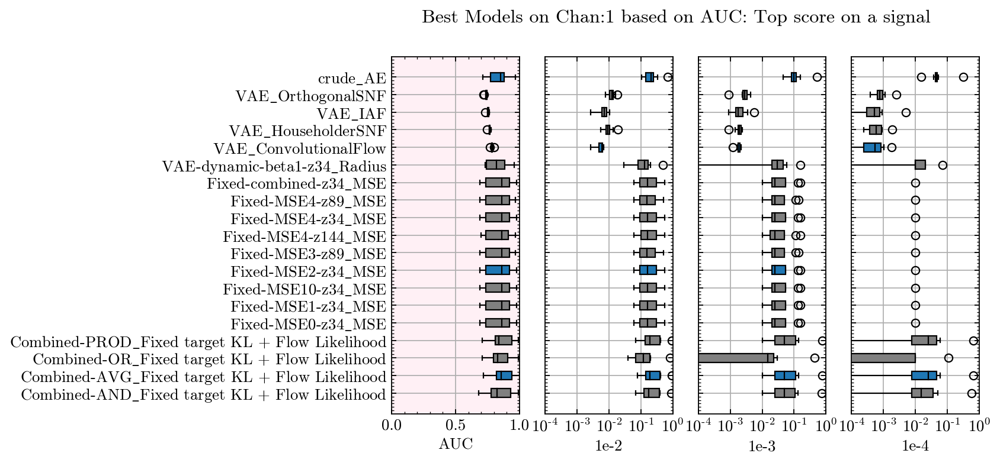

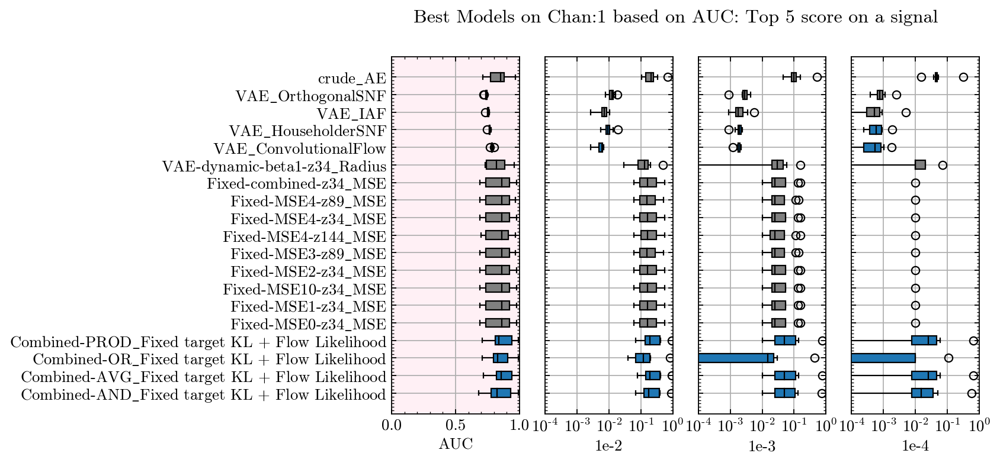

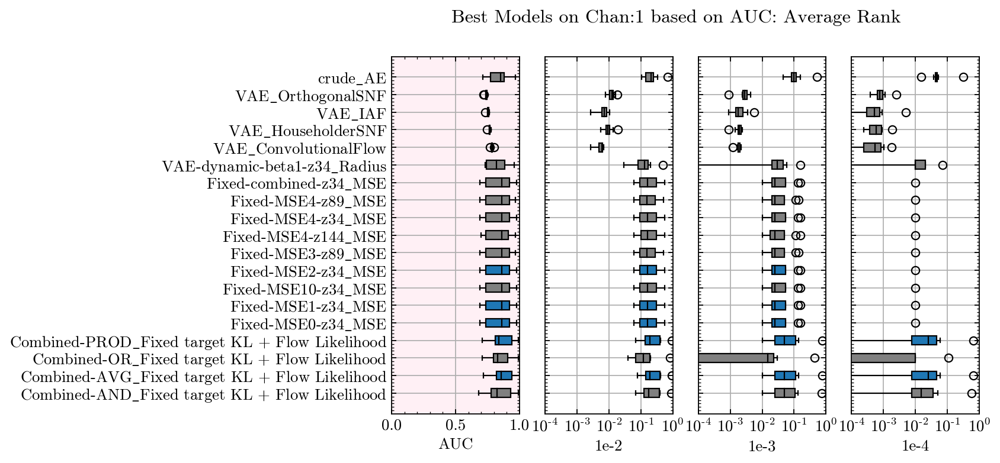

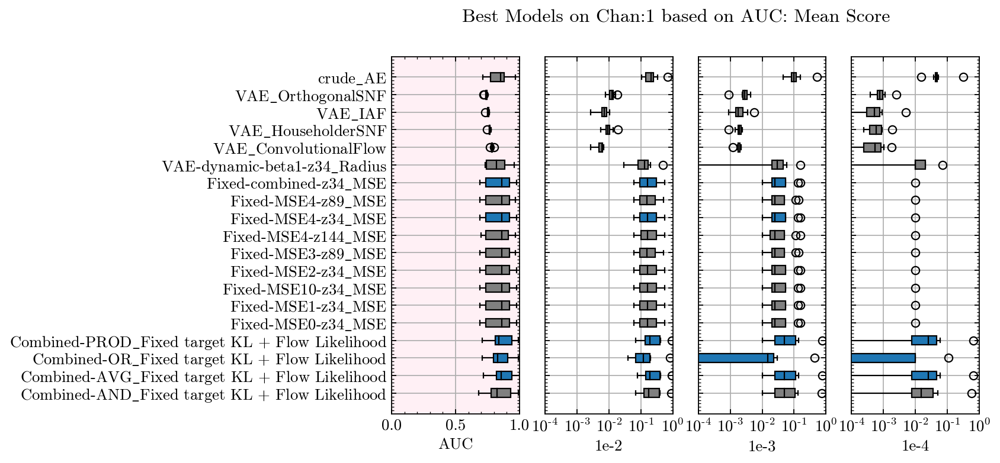

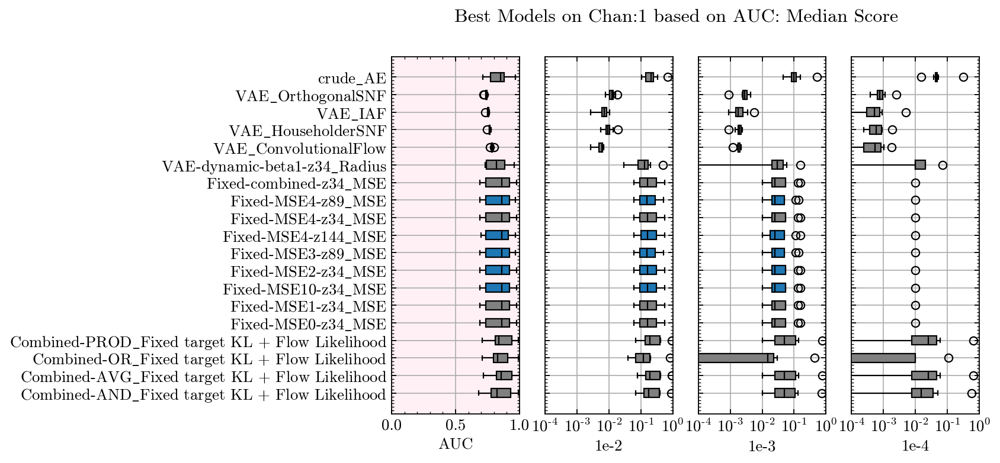

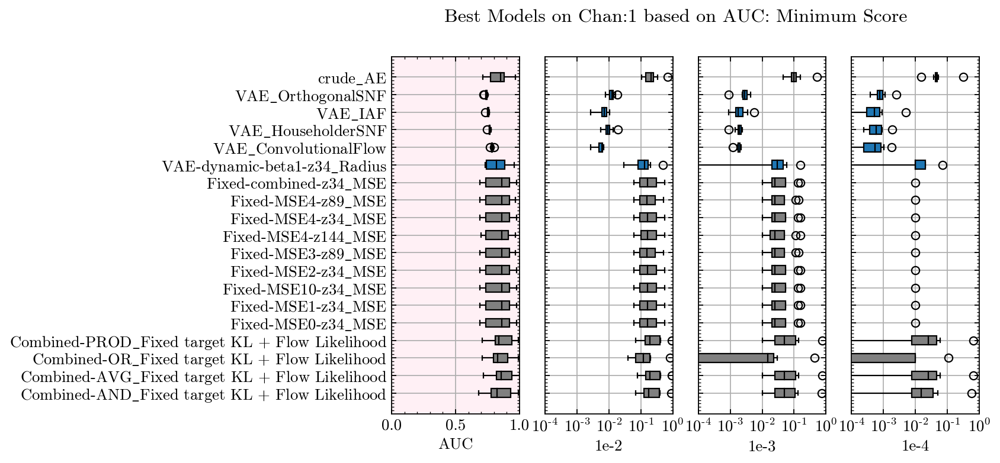

In [31]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='AUC',
        MetricNumberDict = {'top1': 4,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=1e-2 sorted by top1
                                               Model  top1
476  Combined-PROD_Fixed target KL + Flow Likelihood     2
477   Combined-AVG_Fixed target KL + Flow Likelihood     2
554                                         crude_AE     1
303                                         PCA_D=10     1
503                              Fixed-MSE1-z144_MSE     1
****************************************

****************************************
Models from chan=1 ranked by metric=1e-2 sorted by top5
                                               Model  top5
476  Combined-PROD_Fixed target KL + Flow Likelihood     4
477   Combined-AVG_Fixed target KL + Flow Likelihood     4
474   Combined-AND_Fixed target KL + Flow Likelihood 

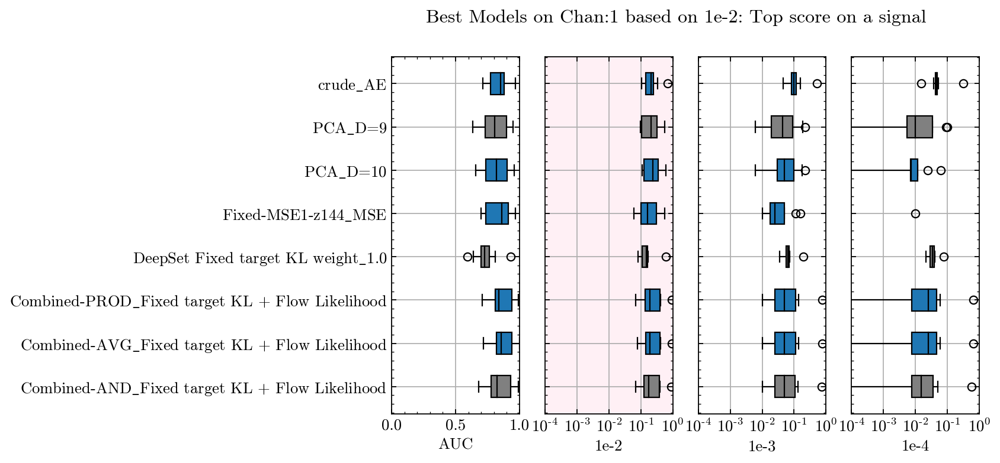

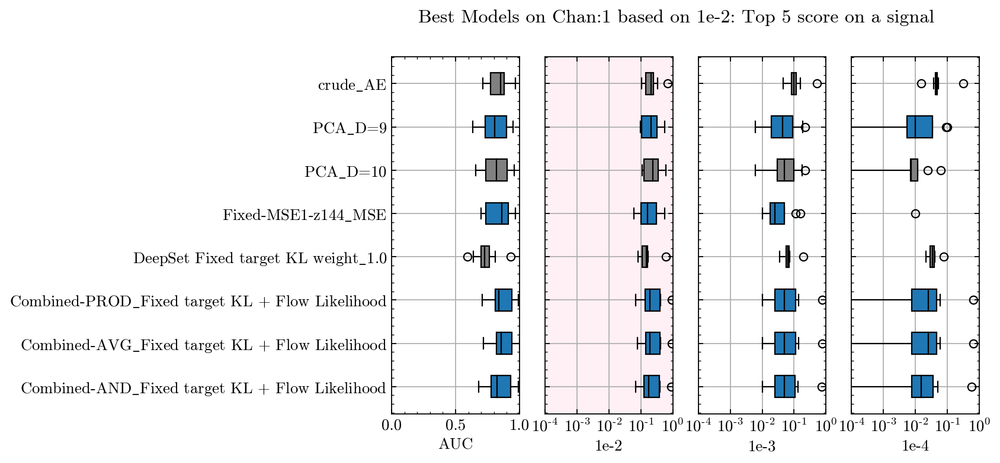

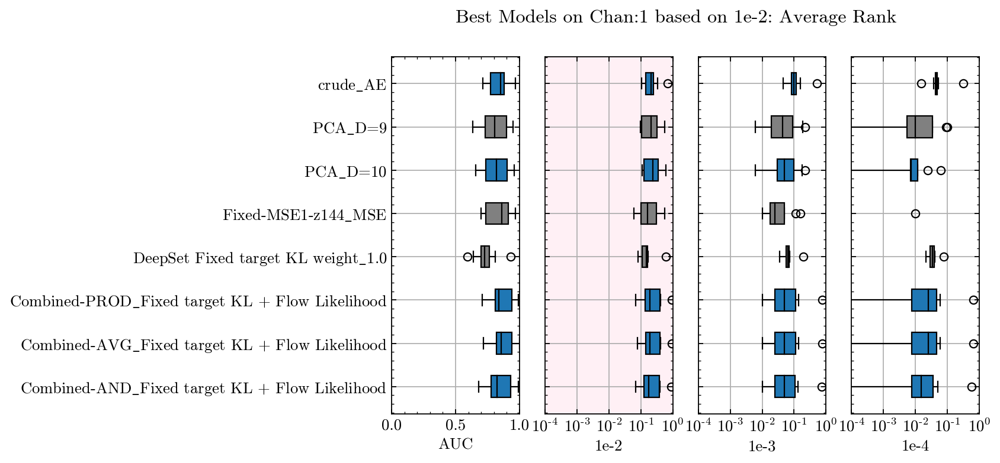

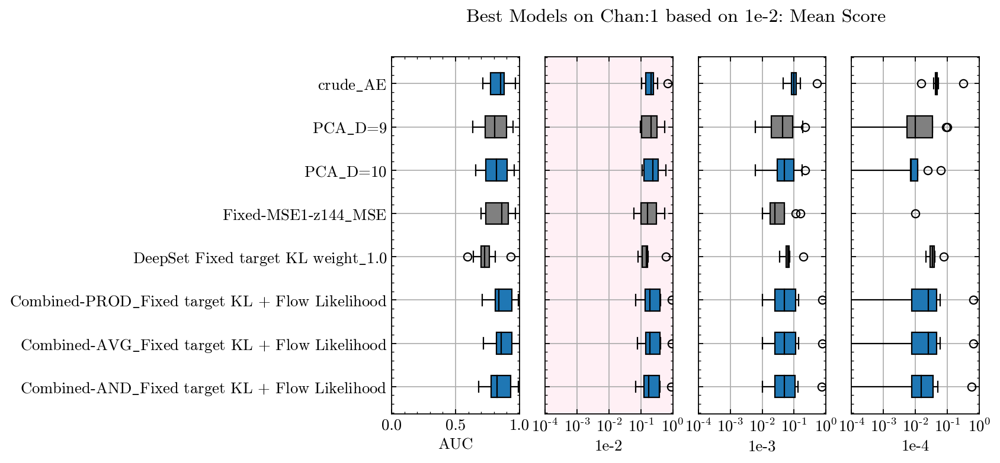

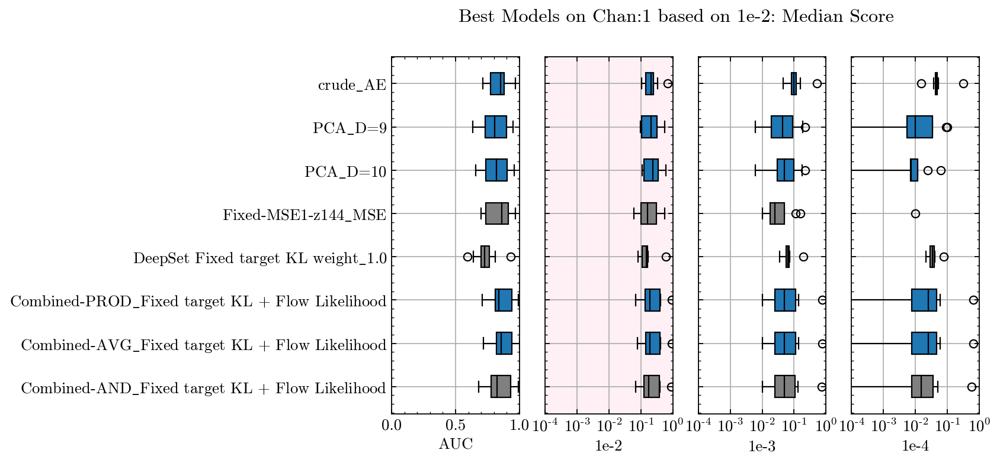

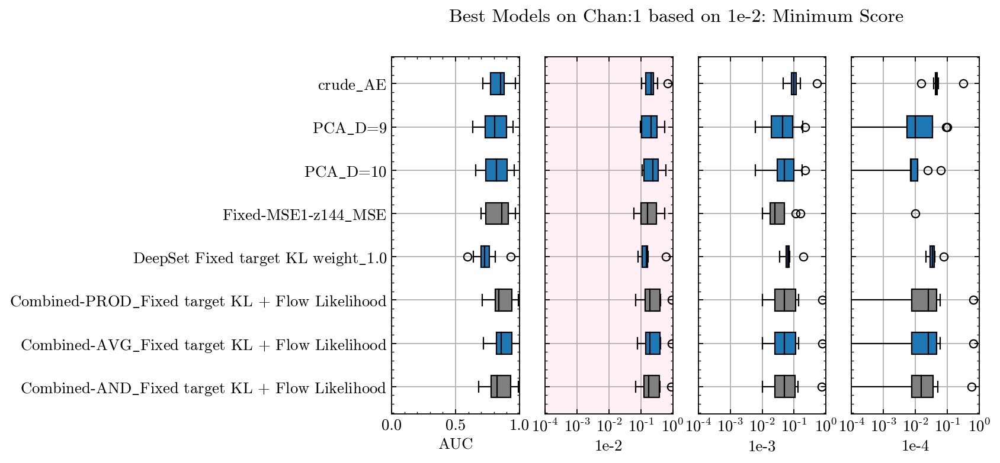

In [32]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 5,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=1e-3 sorted by top1
                                               Model  top1
554                                         crude_AE     5
477   Combined-AVG_Fixed target KL + Flow Likelihood     1
302                                          PCA_D=9     1
476  Combined-PROD_Fixed target KL + Flow Likelihood     1
376                     VAE-static-beta0.1-z8_Radius     0
375                         VAE-static-beta0.1-z8_RL     0
****************************************

****************************************
Models from chan=1 ranked by metric=1e-3 sorted by top5
                                               Model  top5
554                                         crude_AE     7
550               DeepSet Fixed target KL weight_1.0 

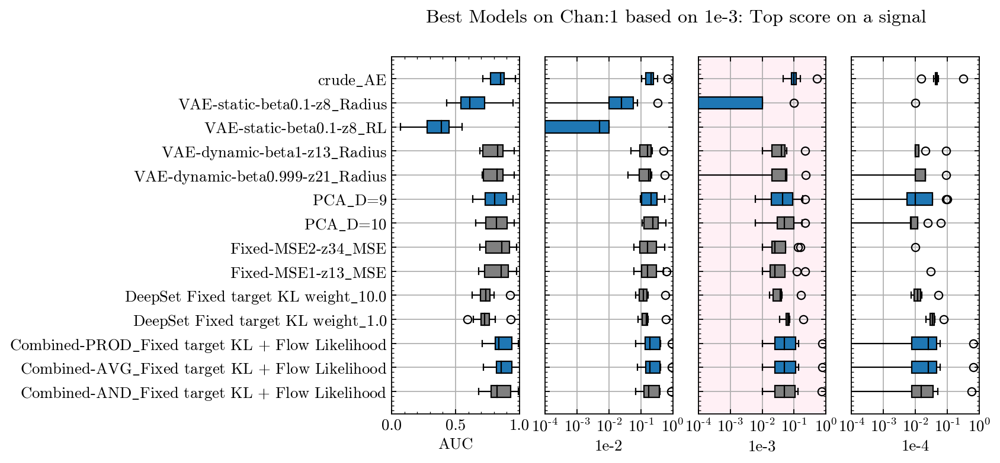

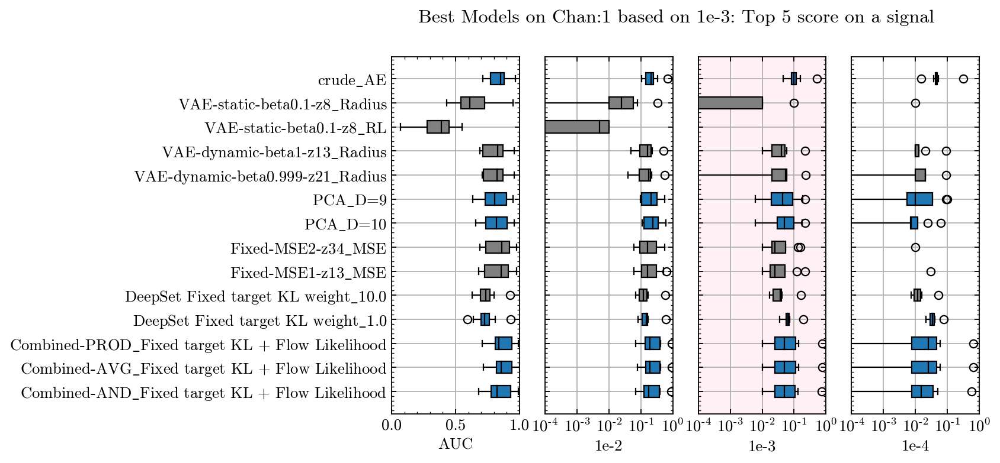

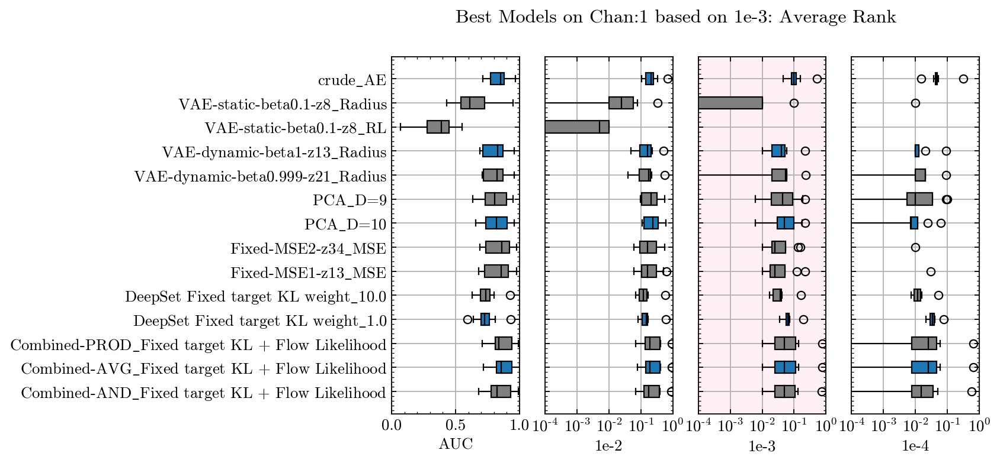

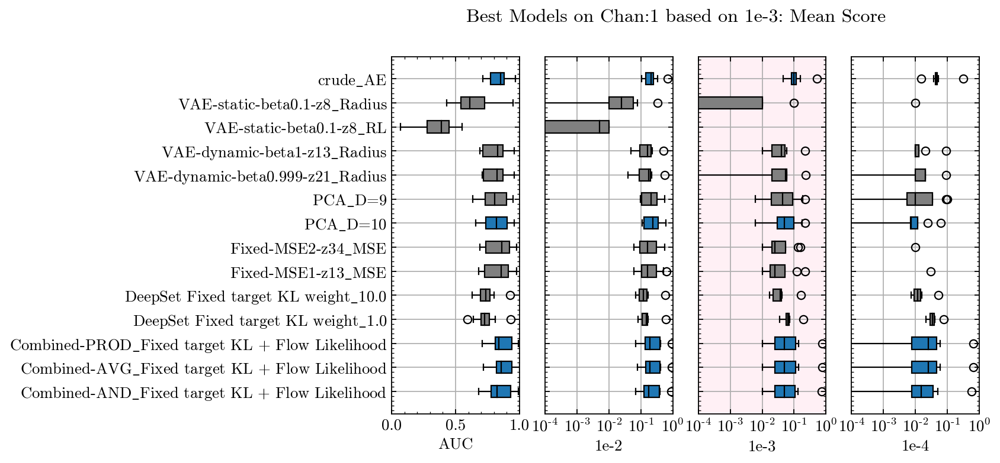

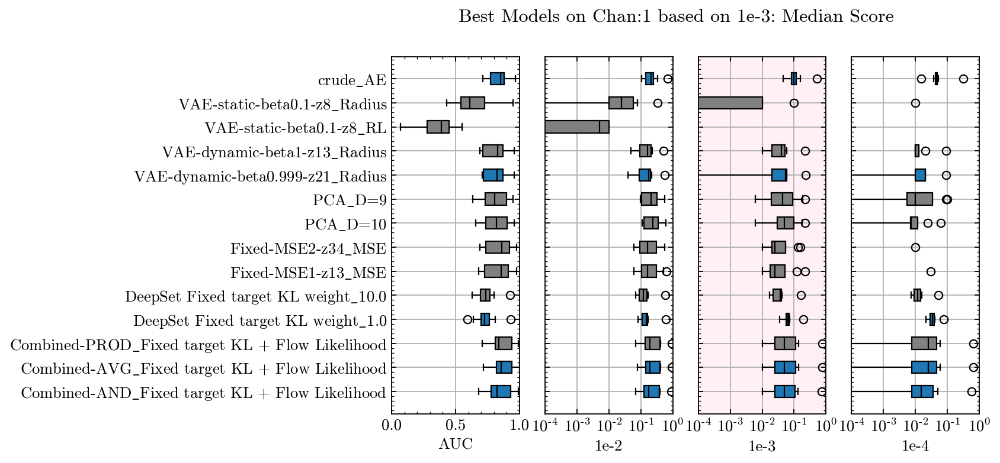

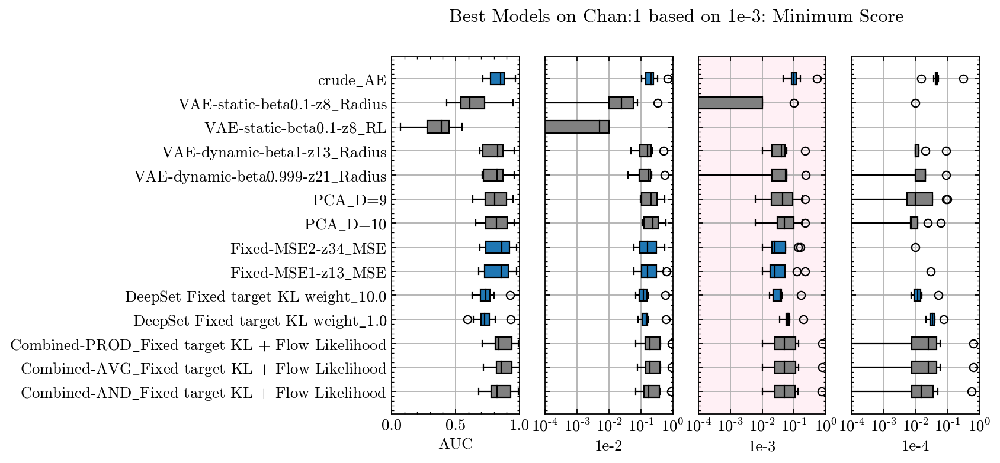

In [33]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 6,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
****************************************
Models from chan=1 ranked by metric=1e-4 sorted by top1
                                              Model  top1
554                                        crude_AE     3
550              DeepSet Fixed target KL weight_1.0     2
477  Combined-AVG_Fixed target KL + Flow Likelihood     2
302                                         PCA_D=9     1
****************************************

****************************************
Models from chan=1 ranked by metric=1e-4 sorted by top5
                                               Model  top5
554                                         crude_AE     8
550               DeepSet Fixed target KL weight_1.0     6
477   Combined-AVG_Fixed target KL + Flow Likelihood     5
476  Combined-PROD_Fixed target KL + Flow Likelihood     5

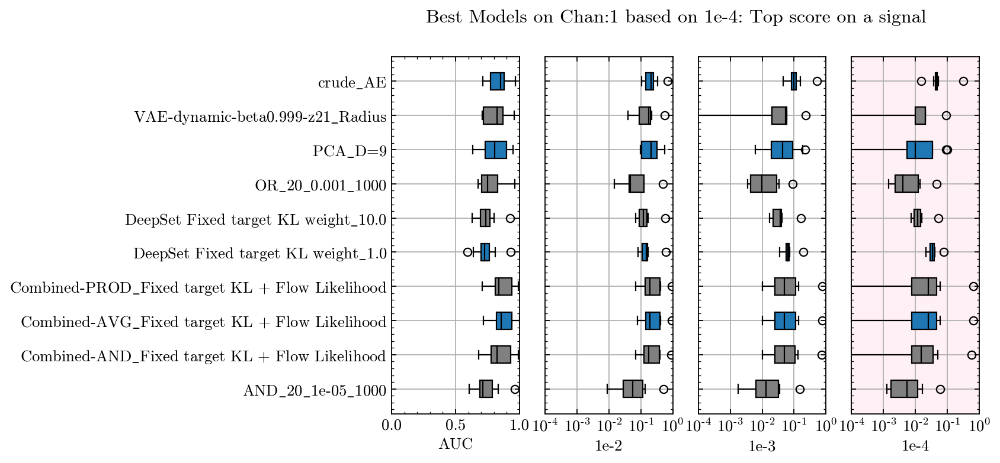

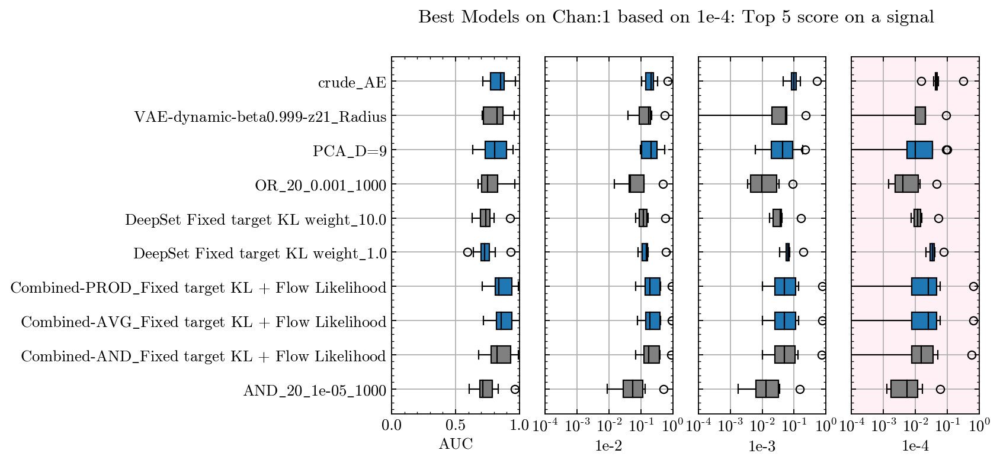

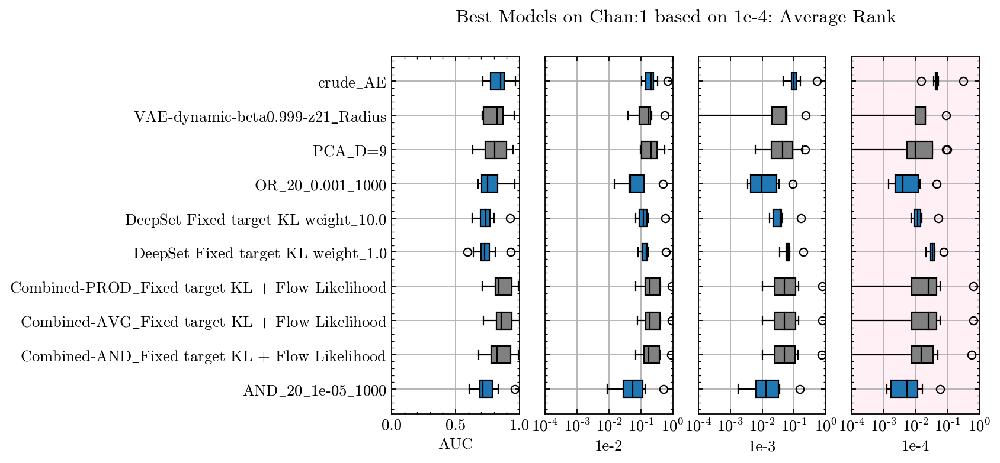

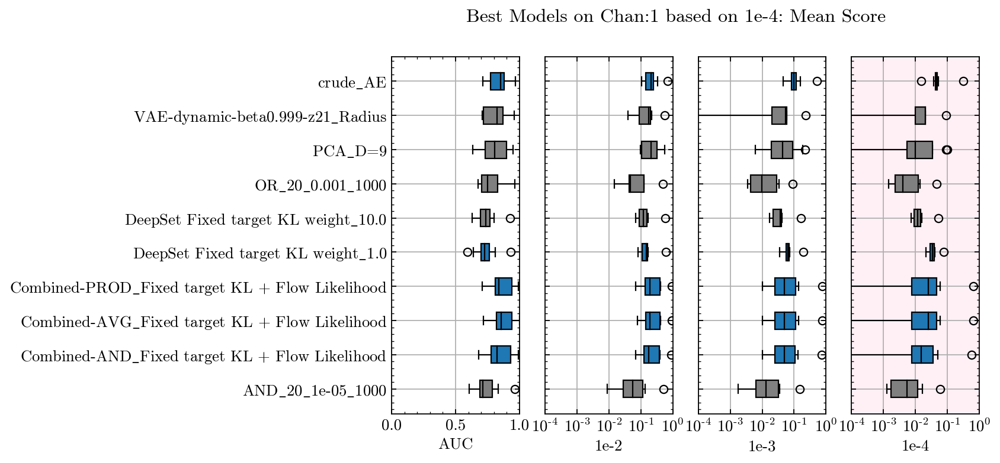

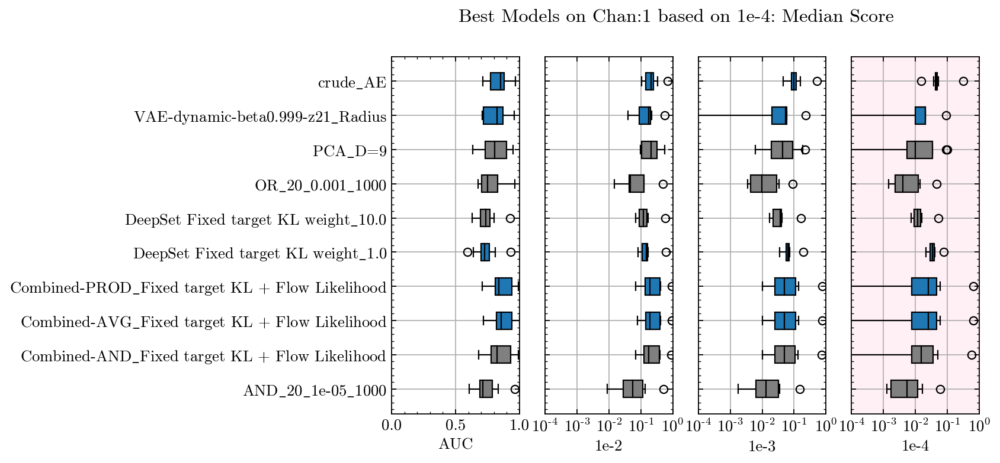

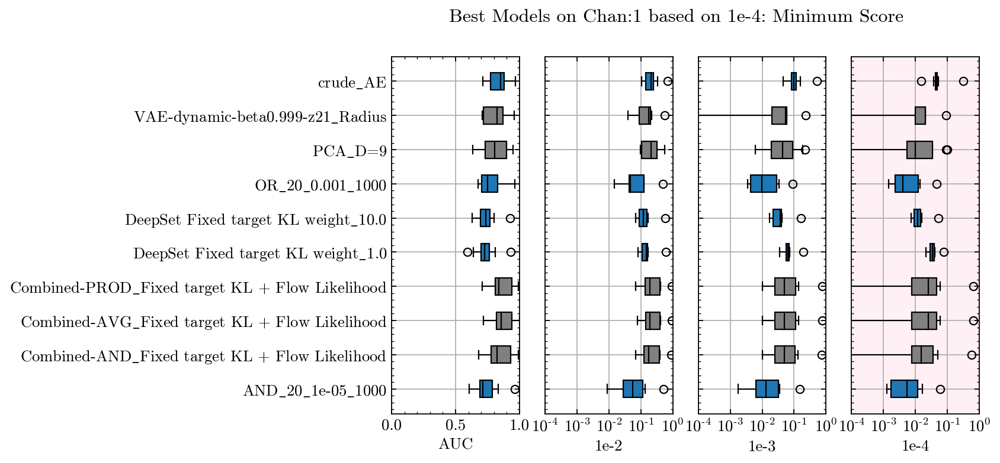

In [34]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## Chan 2a
### AUC

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=AUC sorted by top1
                                              Model  top1
291                               VAE_OrthogonalSNF     2
391                        VAE-static-beta0.5-z5_RL     2
474  Combined-AND_Fixed target KL + Flow Likelihood     1
395                        VAE-static-beta0.5-z8_RL     1
312                                 VAE_b=1e-5_D=10     1
****************************************

****************************************
Models from chan=2a ranked by metric=AUC sorted by top5
                 Model  top5
291  VAE_OrthogonalSNF     5
292  VAE_TriangularSNF     4
293            VAE_IAF     4
****************************************

****************************************
Models from chan=2a ranked by metric=AUC sorted by Avera

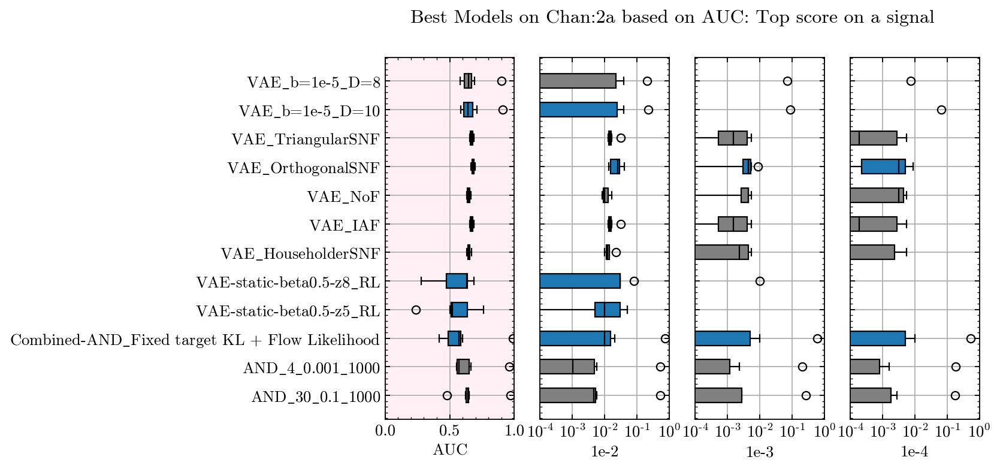

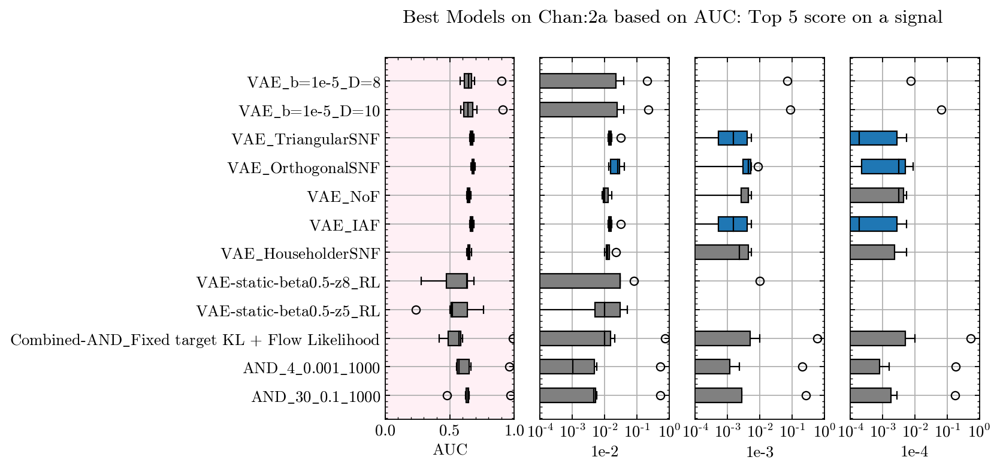

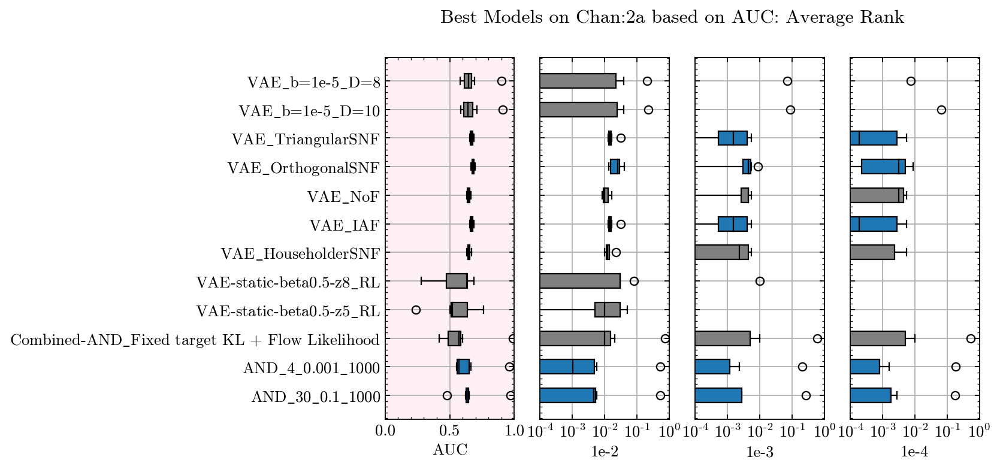

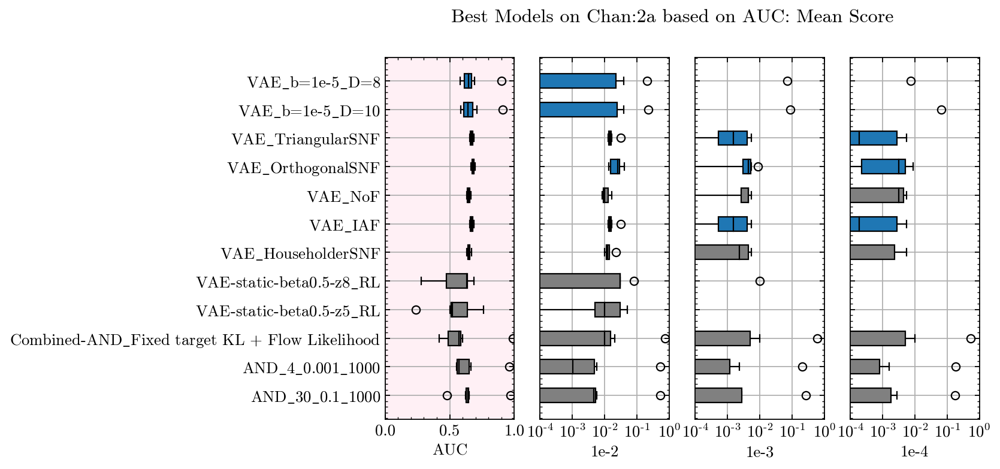

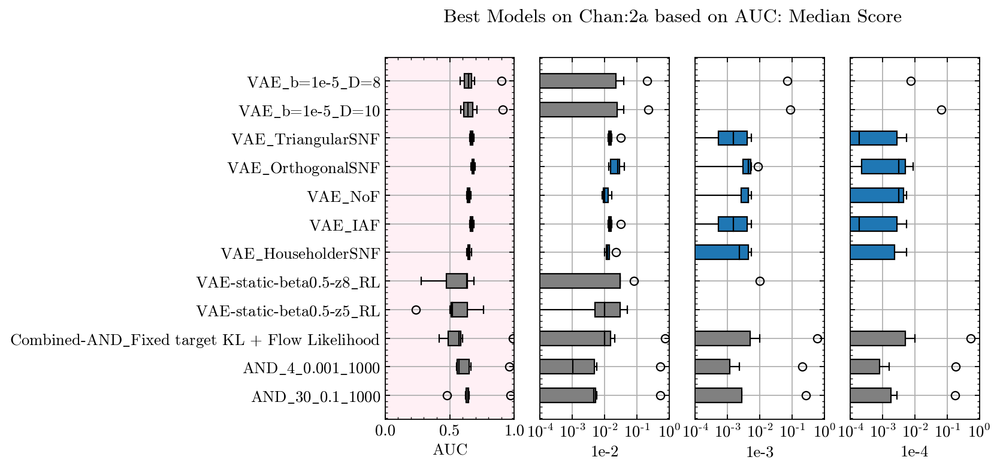

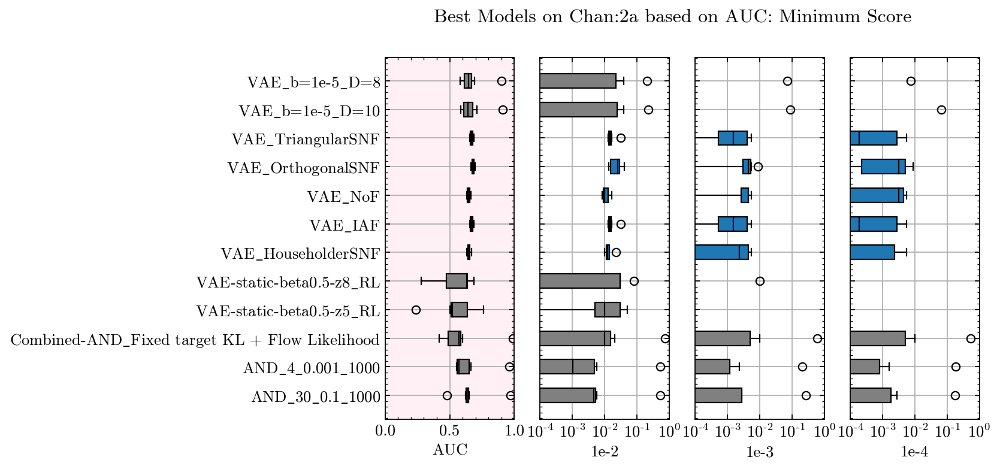

In [35]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='AUC',
        MetricNumberDict = {'top1': 5,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=1e-2 sorted by top1
                           Model  top1
395     VAE-static-beta0.5-z8_RL     1
28                 IF_4_1.0_1000     1
504          Fixed-MSE1-z233_MSE     1
391     VAE-static-beta0.5-z5_RL     1
333  VAE-dynamic-beta1e-06-z5_RL     1
407    VAE-static-beta0.5-z34_RL     1
496            Fixed-MSE1-z5_MSE     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by top5
                         Model  top5
531        Fixed-MSE4-z233_MSE     2
407  VAE-static-beta0.5-z34_RL     2
391   VAE-static-beta0.5-z5_RL     2
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by Averag

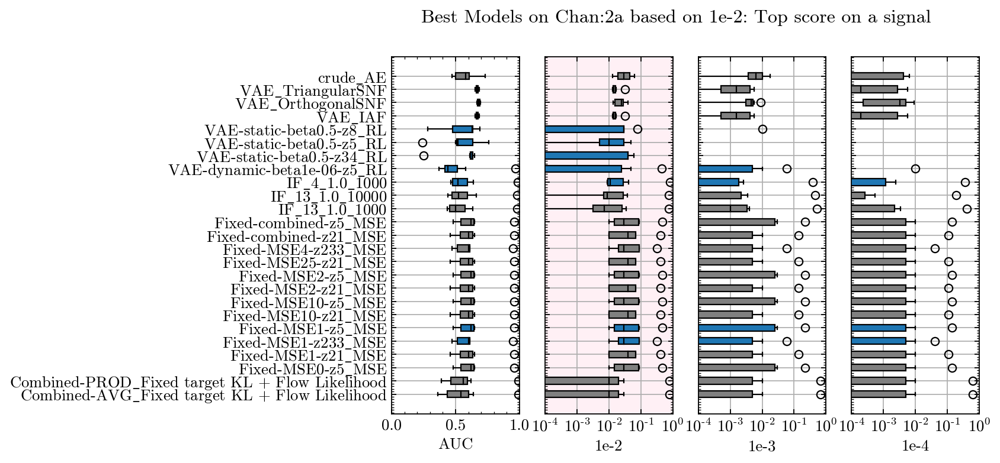

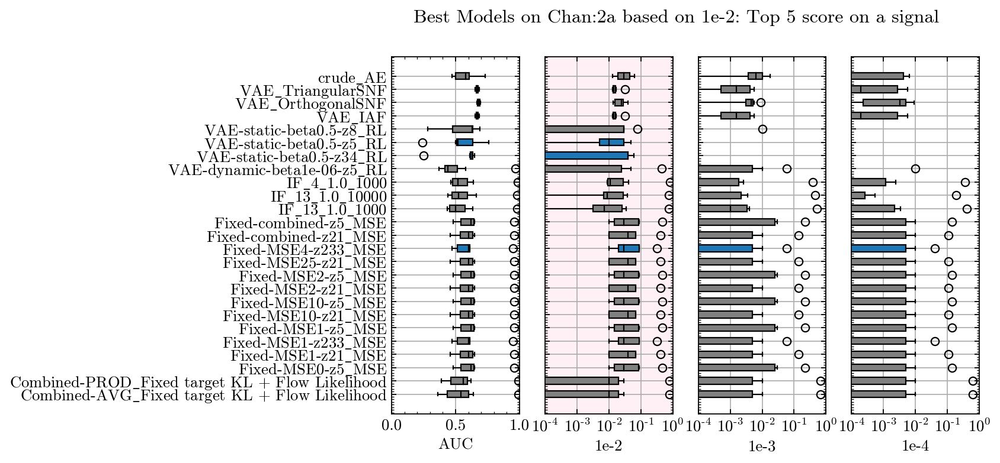

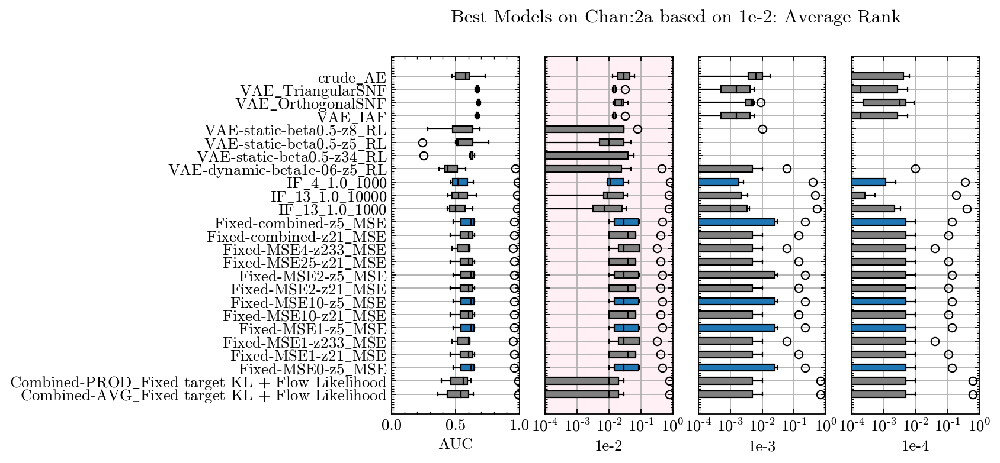

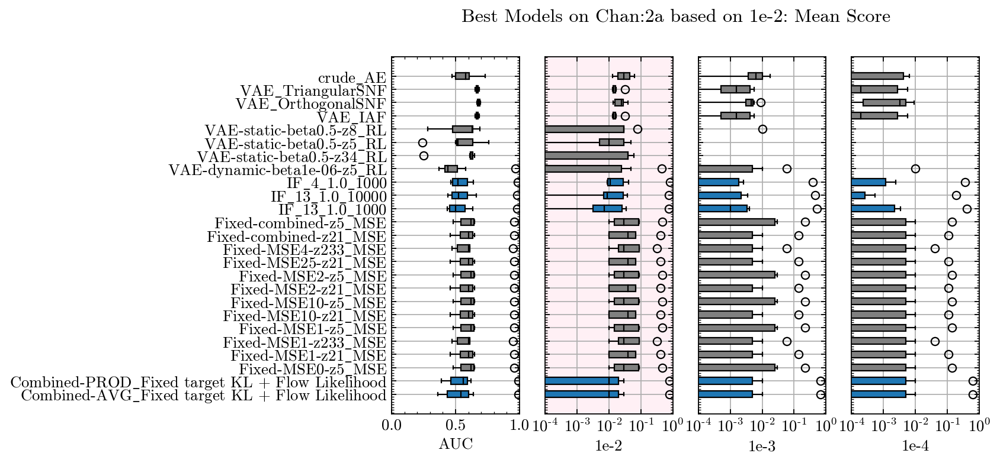

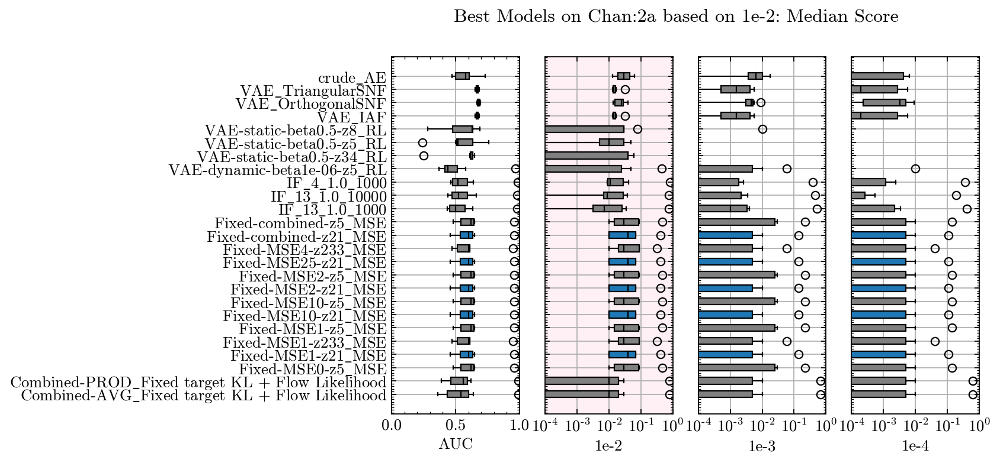

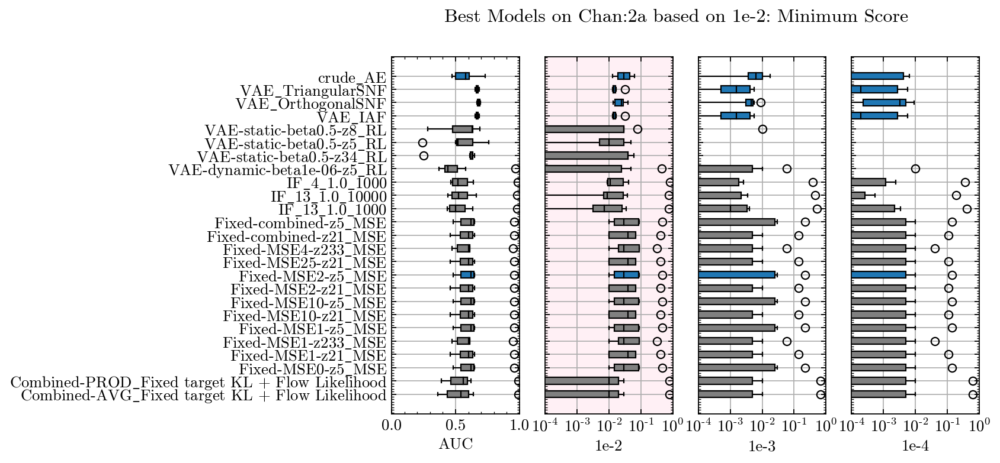

In [36]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 7,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=1e-3 sorted by top1
                                               Model  top1
500                               Fixed-MSE1-z34_MSE     1
427                        VAE-static-beta0.8-z34_RL     1
345                     VAE-dynamic-beta1e-06-z21_RL     1
505                                Fixed-MSE2-z5_MSE     1
476  Combined-PROD_Fixed target KL + Flow Likelihood     1
298                                          PCA_D=5     1
324                                   VAE_b=1e-1_D=4     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-3 sorted by top5
                            Model  top5
341  VAE-dynamic-beta1e-06-z13_RL     2
298                       PCA_D=5     2
505      

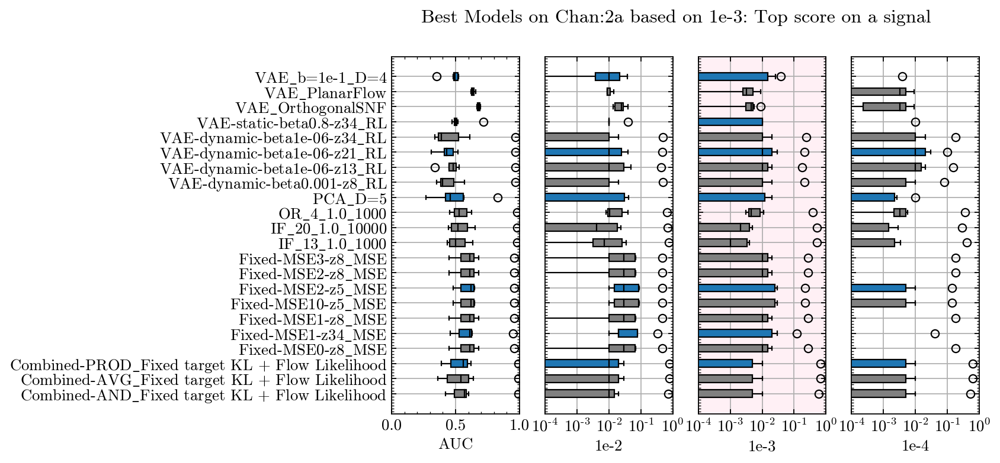

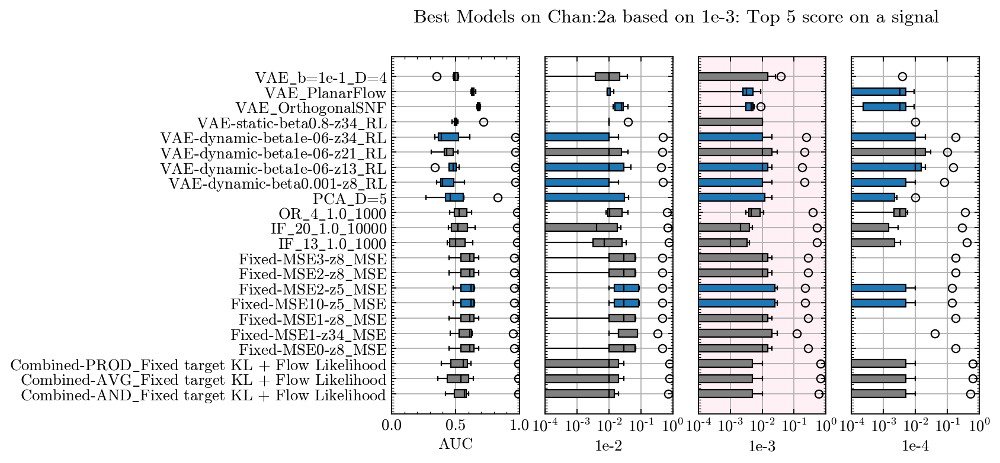

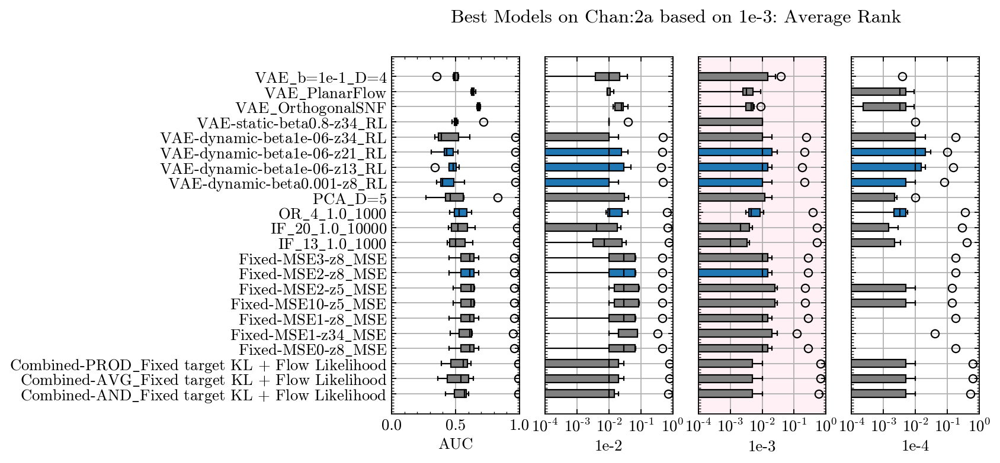

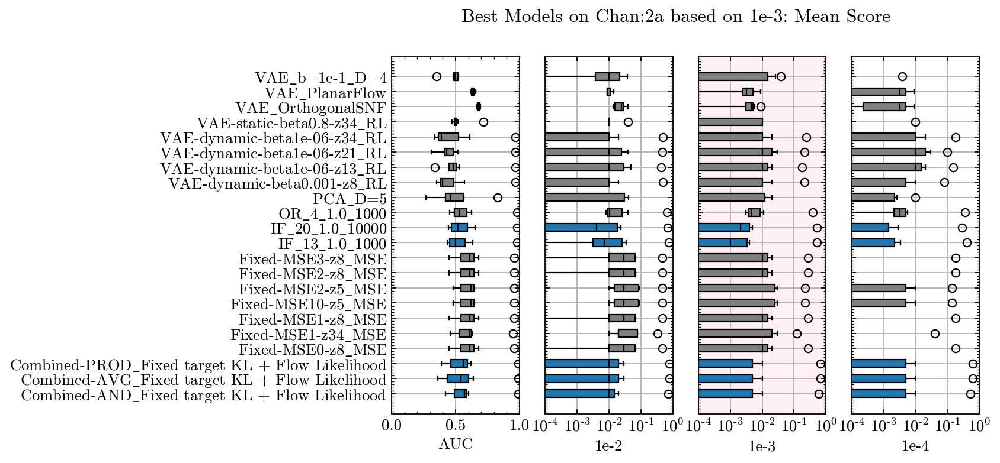

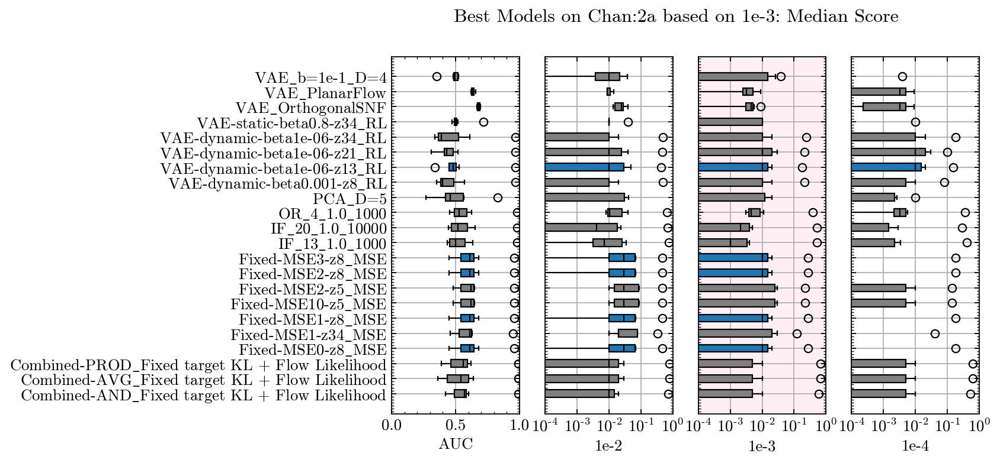

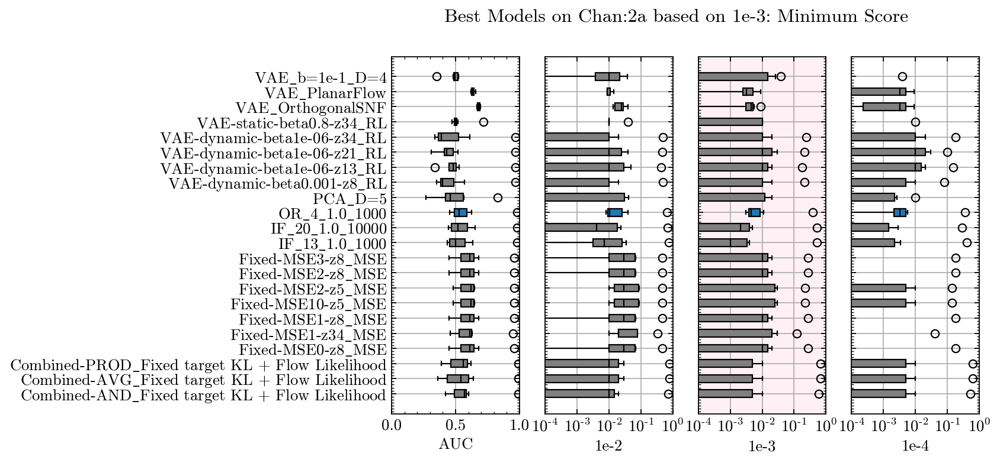

In [37]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 7,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 1},
        Plot=True
       )

### 1e-4

2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
****************************************
Models from chan=2a ranked by metric=1e-4 sorted by top1
                                               Model  top1
476  Combined-PROD_Fixed target KL + Flow Likelihood     1
490                               Fixed-MSE0-z21_MSE     1
293                                          VAE_IAF     1
387                        VAE-static-beta0.1-z34_RL     1
341                     VAE-dynamic-beta1e-06-z13_RL     1
300                                          PCA_D=7     1
345                     VAE-dynamic-beta1e-06-z21_RL     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-4 sorted by top5
                                               Model  top5
291                                VAE_OrthogonalSNF     3
341        

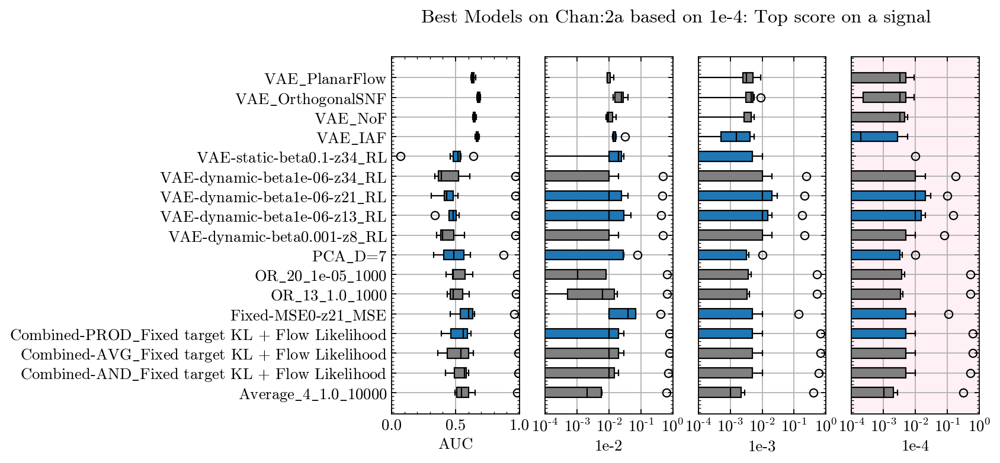

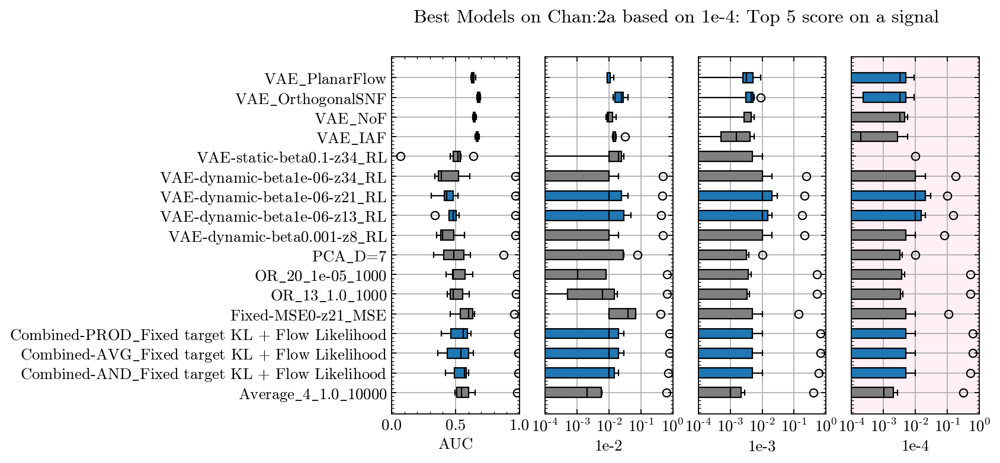

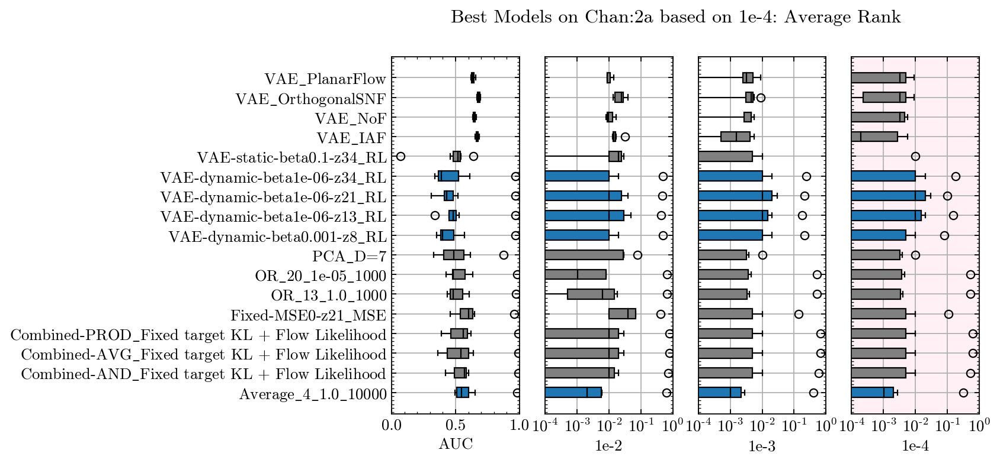

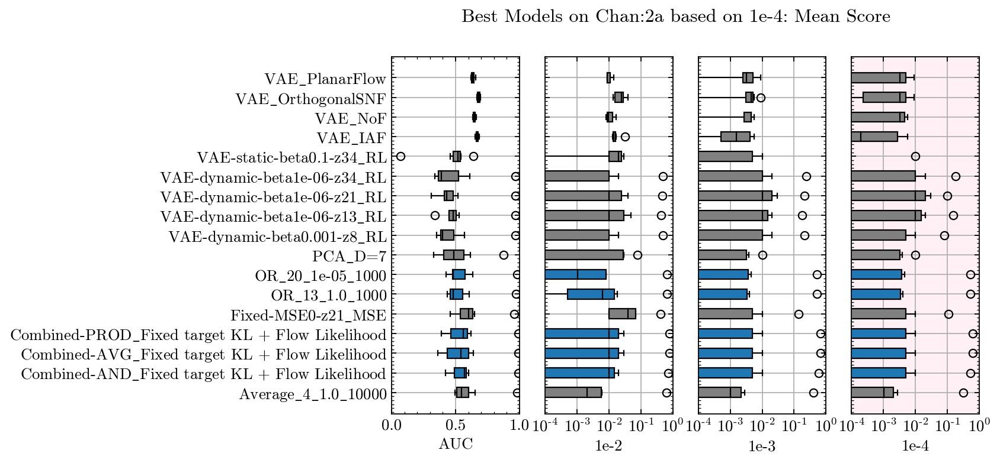

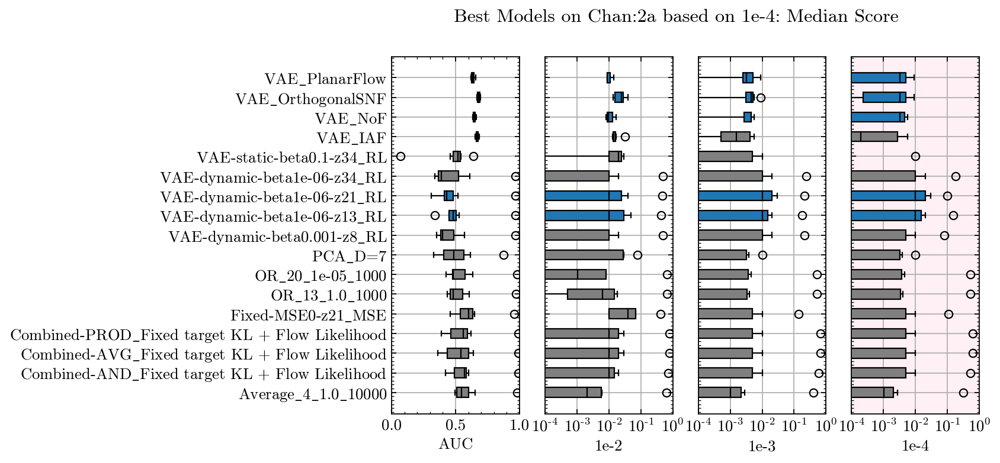

In [38]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 7,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

## Chan 2b
### AUC

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=AUC sorted by top1
                                               Model  top1
291                                VAE_OrthogonalSNF     3
477   Combined-AVG_Fixed target KL + Flow Likelihood     2
476  Combined-PROD_Fixed target KL + Flow Likelihood     2
484                           Fixed-combined-z89_MSE     1
475    Combined-OR_Fixed target KL + Flow Likelihood     1
****************************************

****************************************
Models from chan=2b ranked by metric=AUC sorted by top5
                                               Model  top5
475    Combined-OR_Fixed target KL + Flow Likelihood     5
291                                VAE_OrthogonalSNF     5
476  Combined-PROD_Fixed target KL 

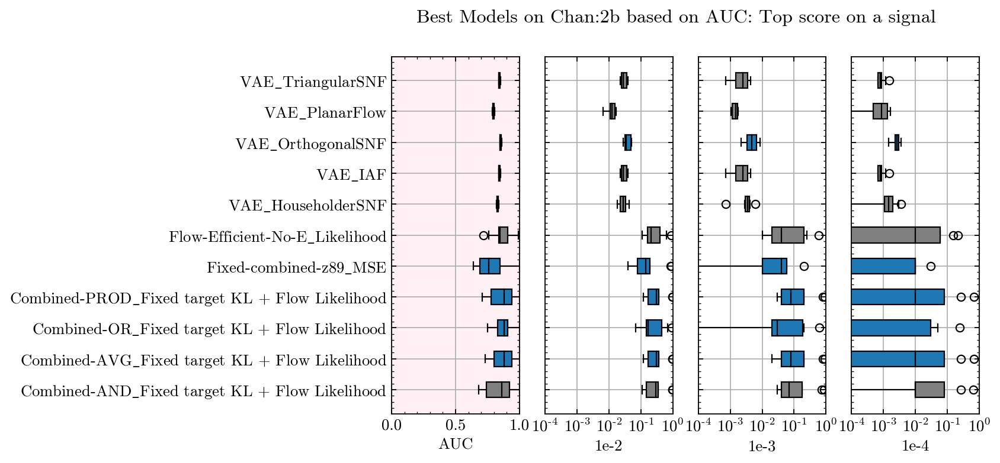

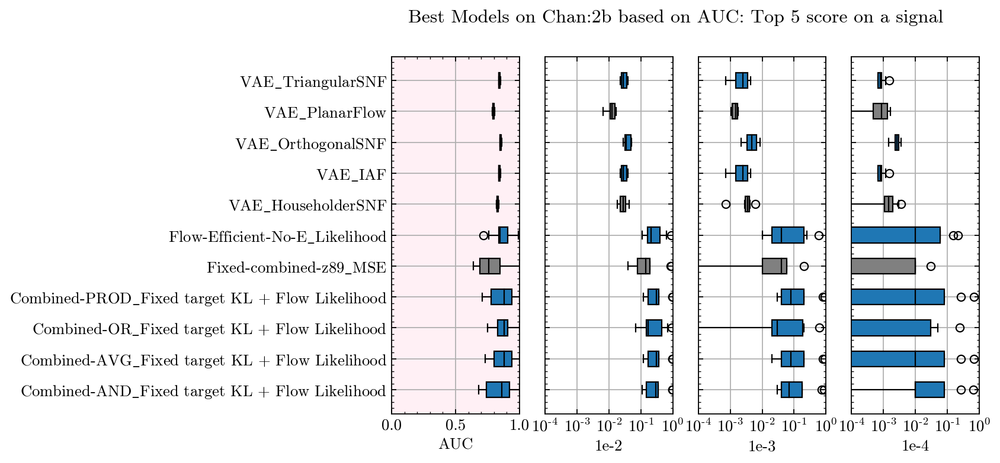

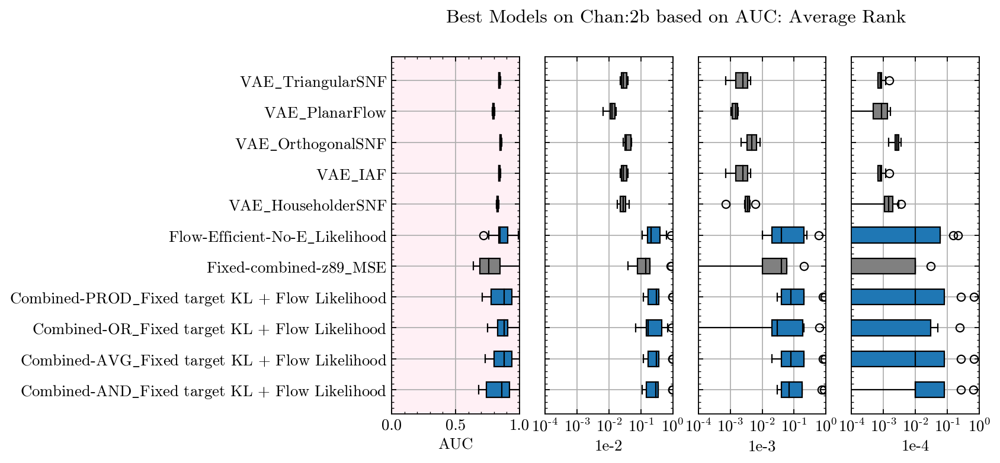

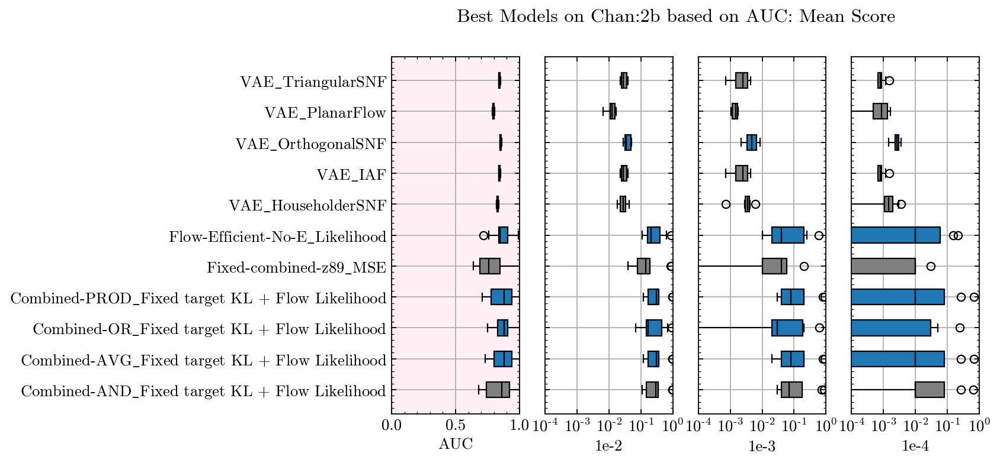

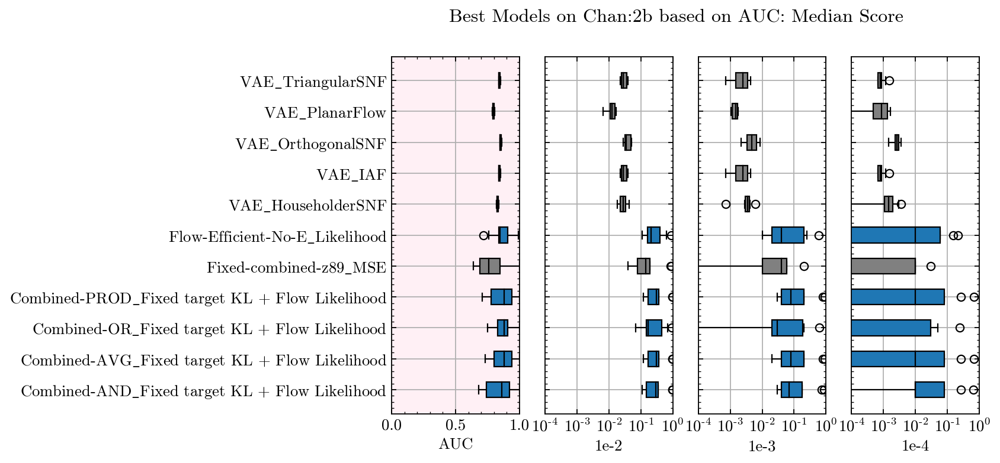

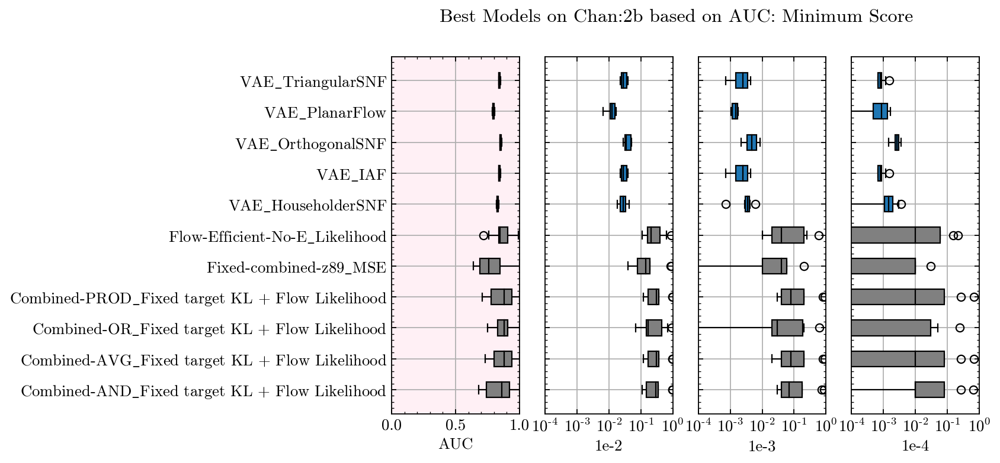

In [39]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='AUC',
        MetricNumberDict = {'top1': 5,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=1e-2 sorted by top1
                                               Model  top1
477   Combined-AVG_Fixed target KL + Flow Likelihood     3
177                                OR_30_0.001_10000     2
476  Combined-PROD_Fixed target KL + Flow Likelihood     2
475    Combined-OR_Fixed target KL + Flow Likelihood     1
10                                    IF_20_0.1_1000     1
****************************************

****************************************
Models from chan=2b ranked by metric=1e-2 sorted by top5
                                               Model  top5
477   Combined-AVG_Fixed target KL + Flow Likelihood     5
476  Combined-PROD_Fixed target KL + Flow Likelihood     5
474   Combined-AND_Fixed target K

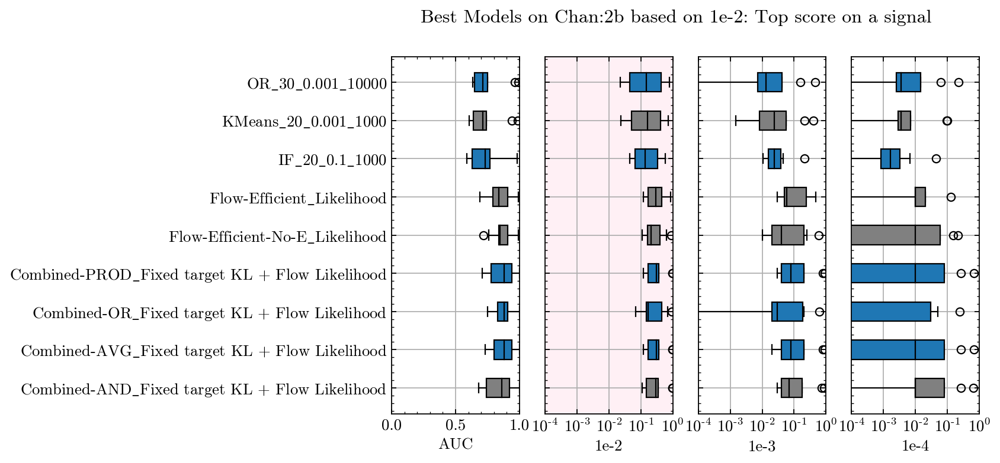

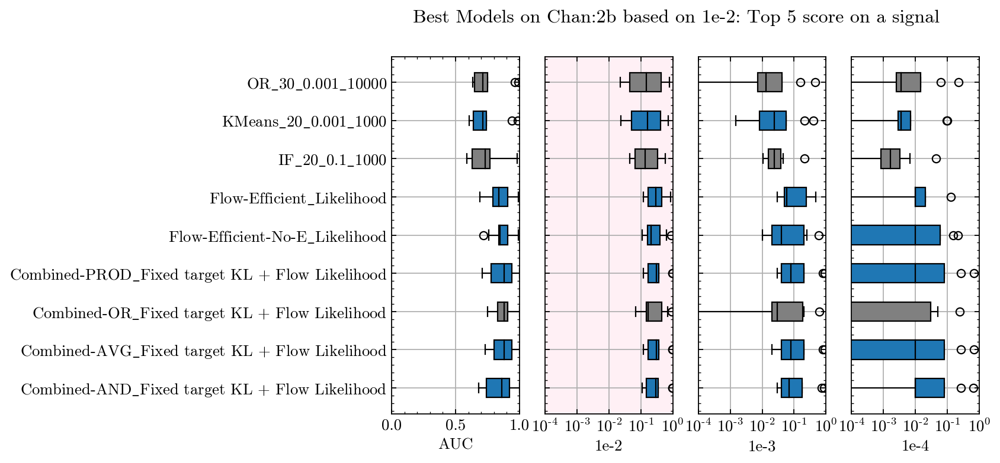

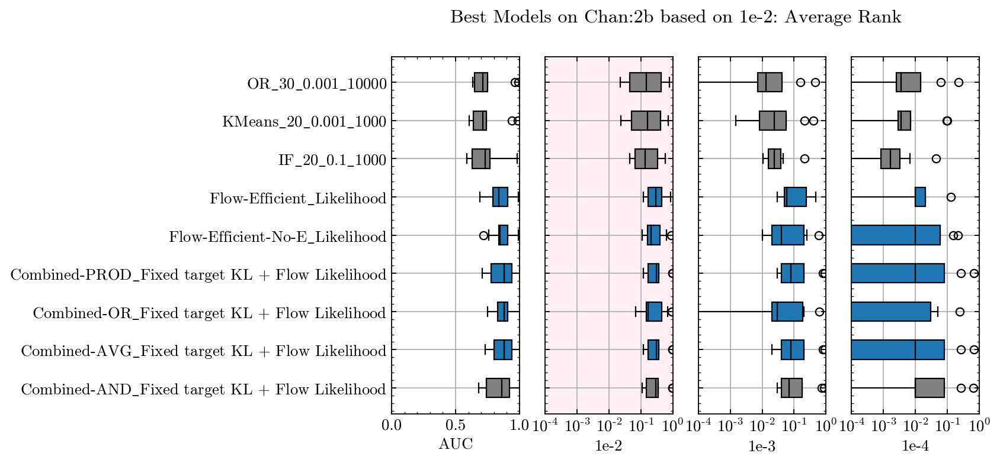

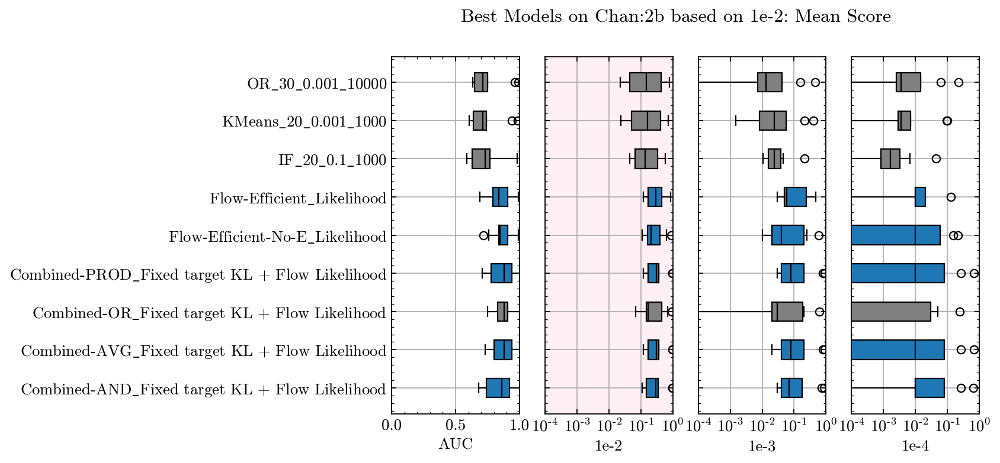

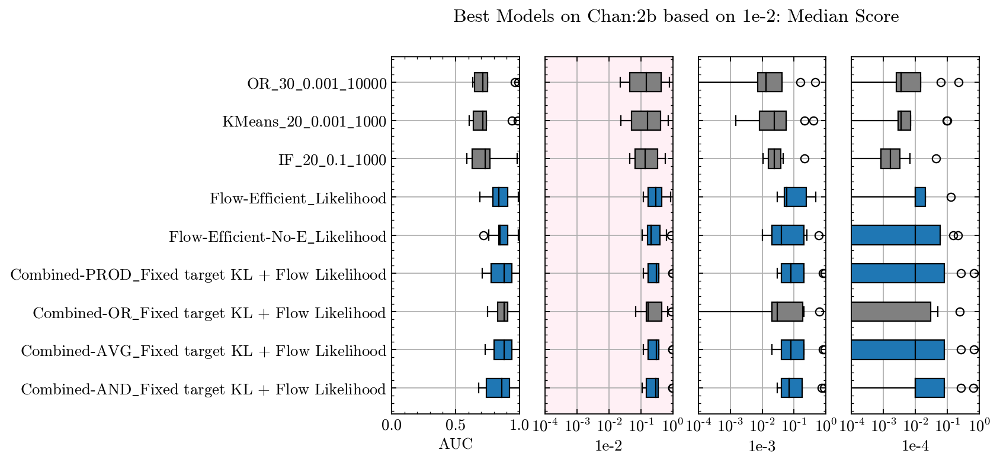

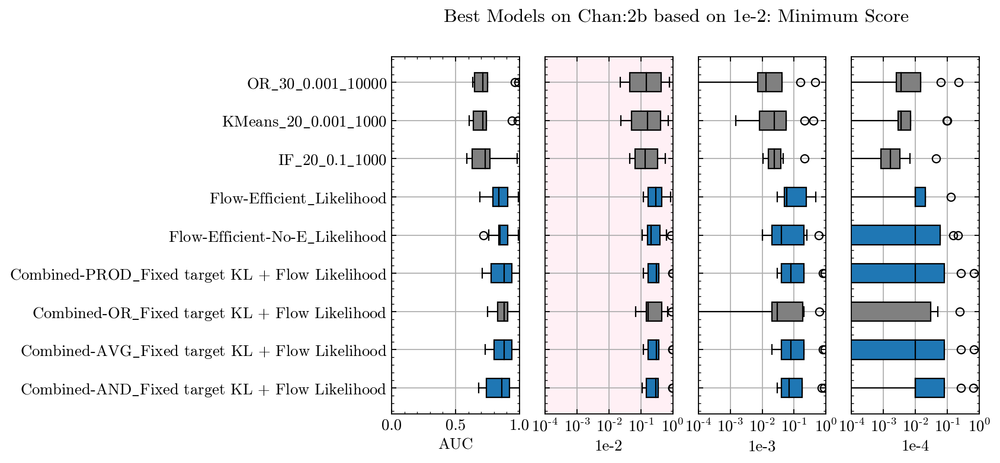

In [40]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 5,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=1e-3 sorted by top1
                                               Model  top1
477   Combined-AVG_Fixed target KL + Flow Likelihood     3
551              DeepSet Fixed target KL weight_10.0     2
341                     VAE-dynamic-beta1e-06-z13_RL     2
476  Combined-PROD_Fixed target KL + Flow Likelihood     1
353                      VAE-dynamic-beta0.001-z5_RL     1
****************************************

****************************************
Models from chan=2b ranked by metric=1e-3 sorted by top5
                                               Model  top5
476  Combined-PROD_Fixed target KL + Flow Likelihood     5
474   Combined-AND_Fixed target KL + Flow Likelihood     5
477   Combined-AVG_Fixed target K

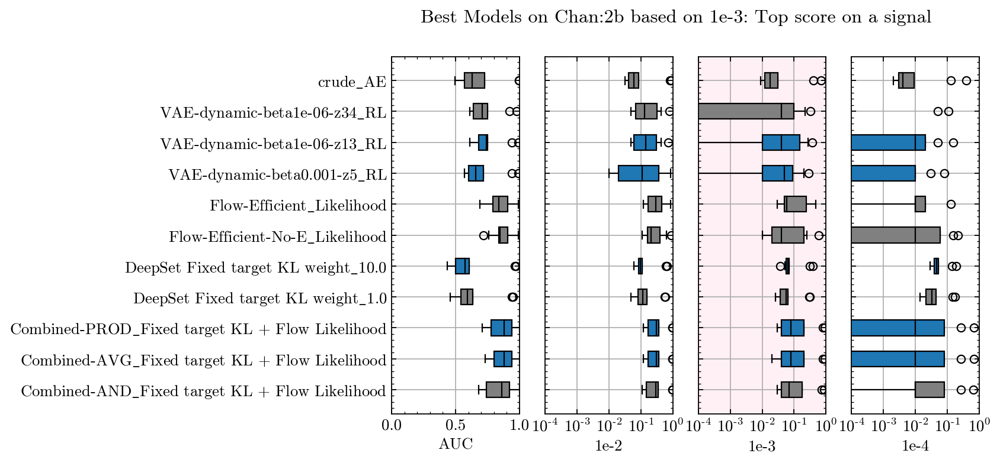

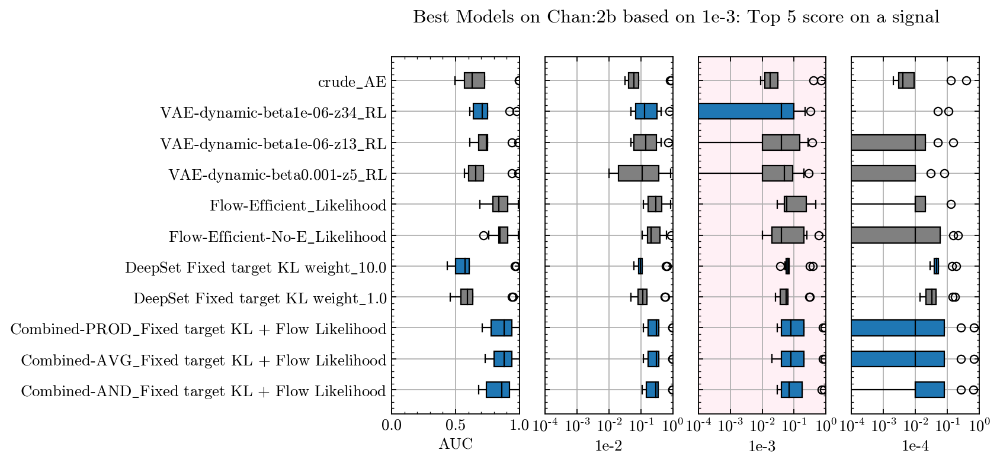

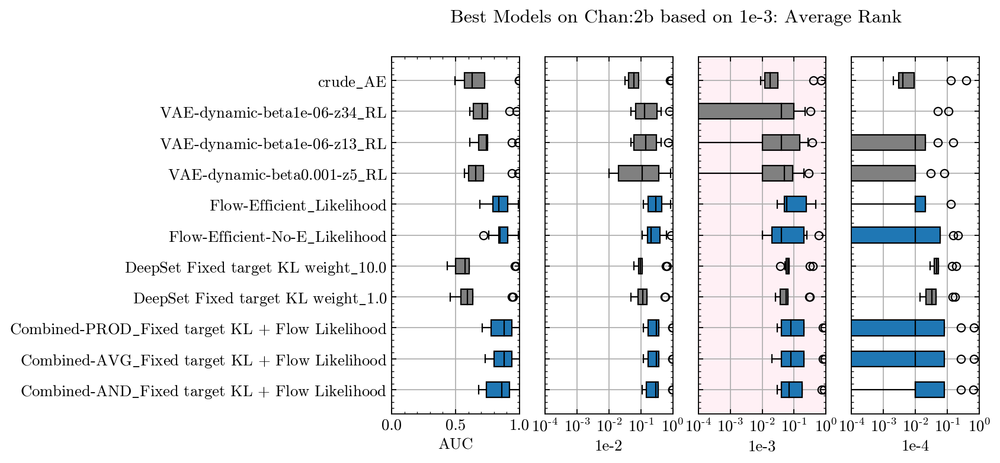

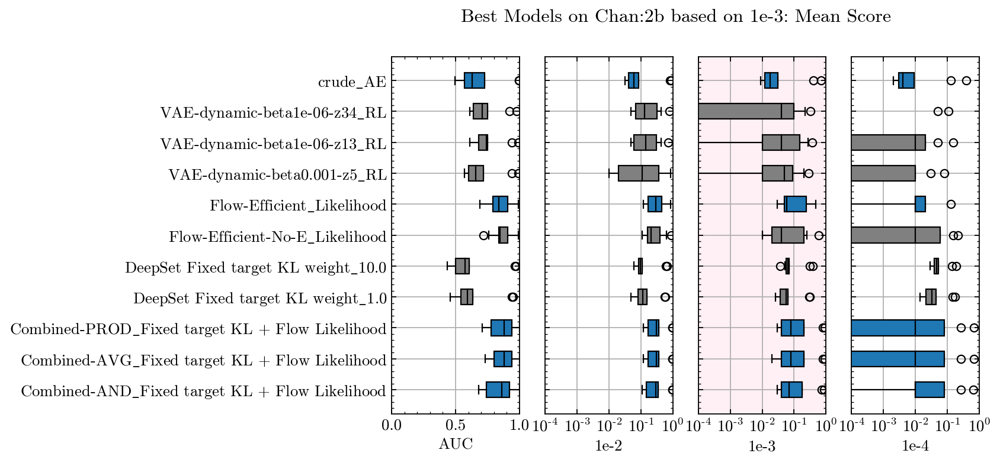

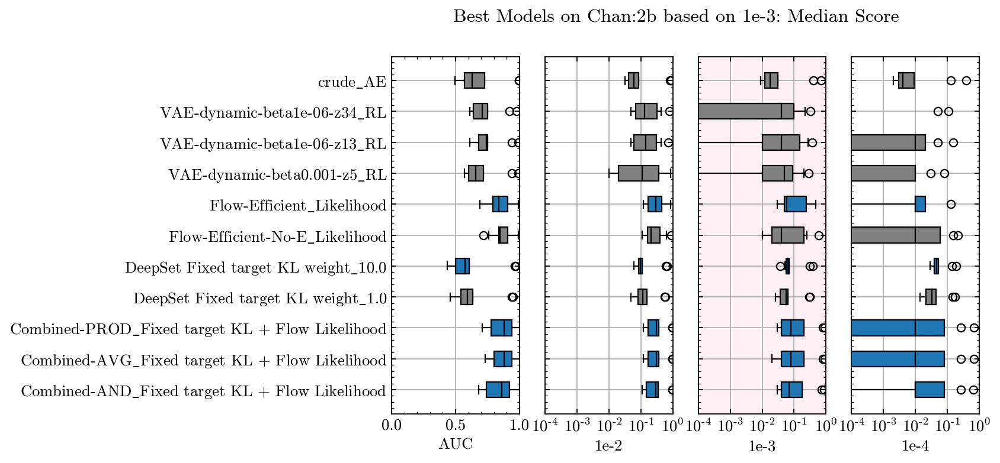

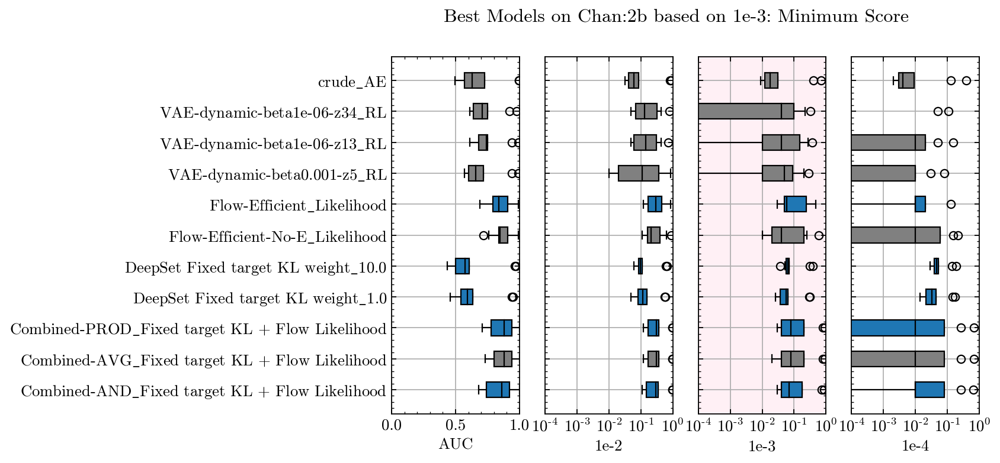

In [41]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 5,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
****************************************
Models from chan=2b ranked by metric=1e-4 sorted by top1
                                              Model  top1
551             DeepSet Fixed target KL weight_10.0     6
554                                        crude_AE     1
388                   VAE-static-beta0.1-z34_Radius     1
477  Combined-AVG_Fixed target KL + Flow Likelihood     1
****************************************

****************************************
Models from chan=2b ranked by metric=1e-4 sorted by top5
                                   Model  top5
551  DeepSet Fixed target KL weight_10.0     6
550   DeepSet Fixed target KL weight_1.0     5
****************************************

****************************************
Models from chan=2b ranked by metric=1e-4 sorted b

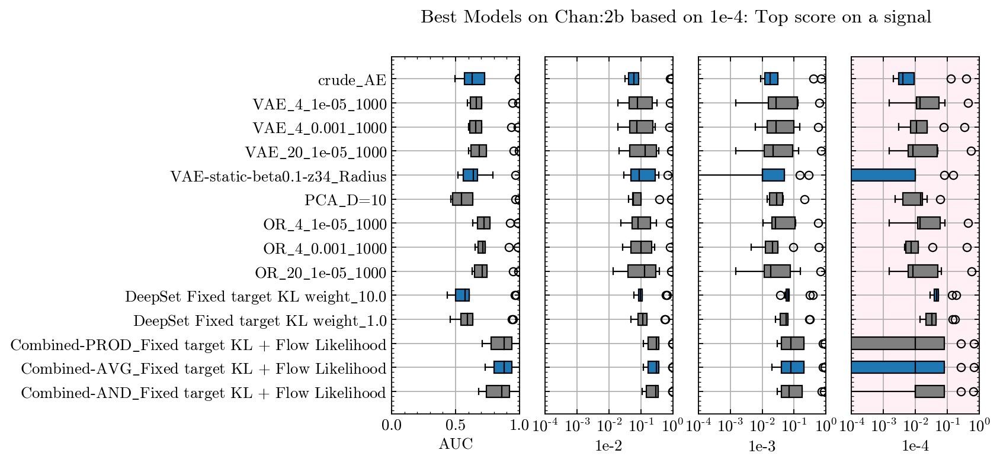

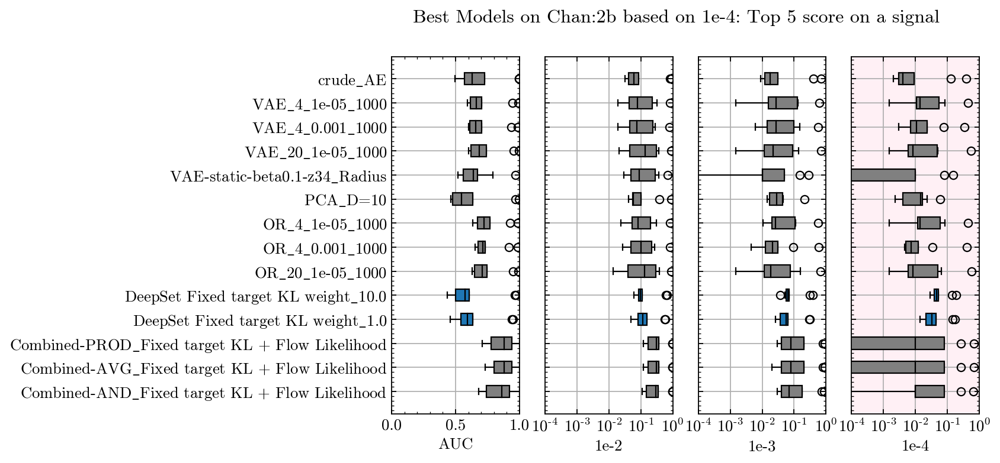

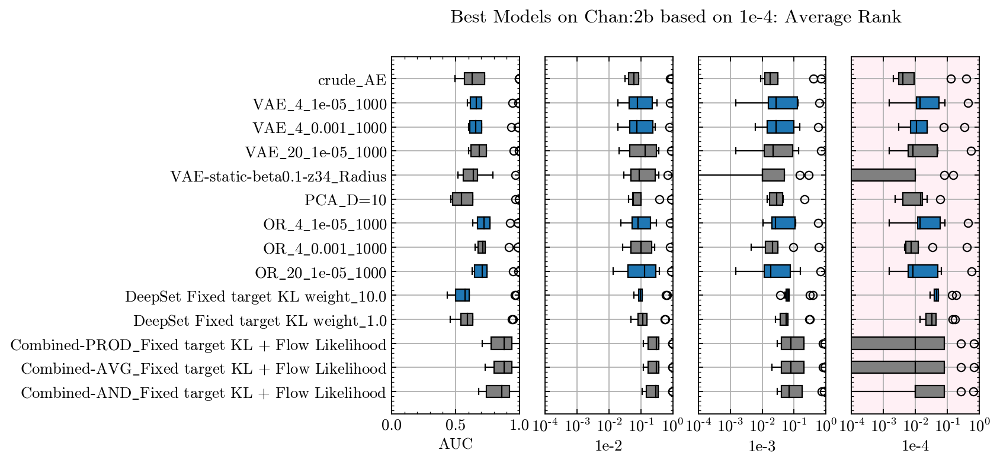

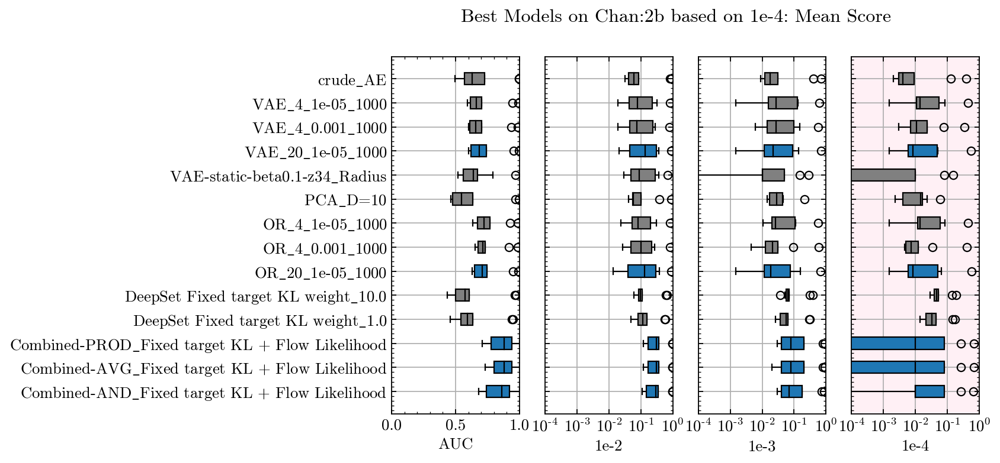

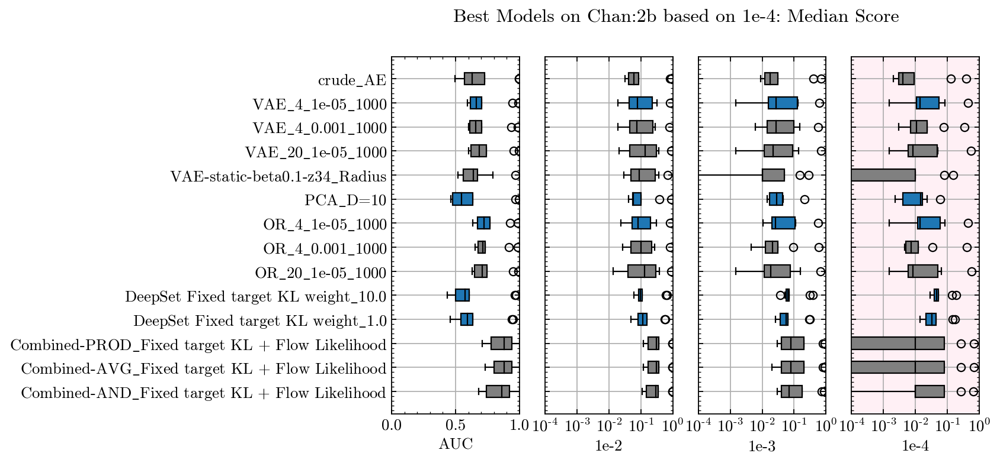

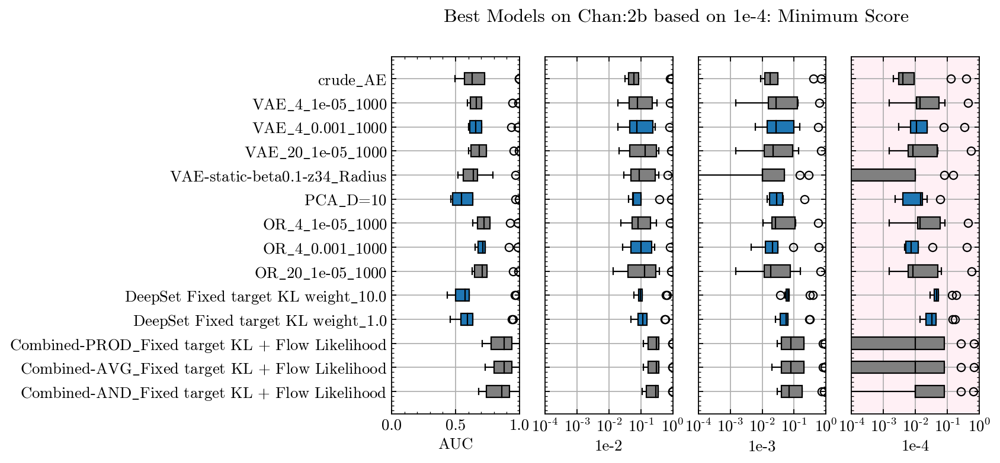

In [42]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 2,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## Chan 3
### AUC

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=AUC sorted by top1
                  Model  top1
290  VAE_HouseholderSNF     6
****************************************

****************************************
Models from chan=3 ranked by metric=AUC sorted by top5
                                               Model  top5
477   Combined-AVG_Fixed target KL + Flow Likelihood     8
290                               VAE_HouseholderSNF     8
289                                   VAE_PlanarFlow     7
292                                VAE_TriangularSNF     6
476  Combined-PROD_Fixed target KL + Flow Likelihood     4
291                                VAE_OrthogonalSNF     4
294                            VAE_ConvolutionalFlow     1

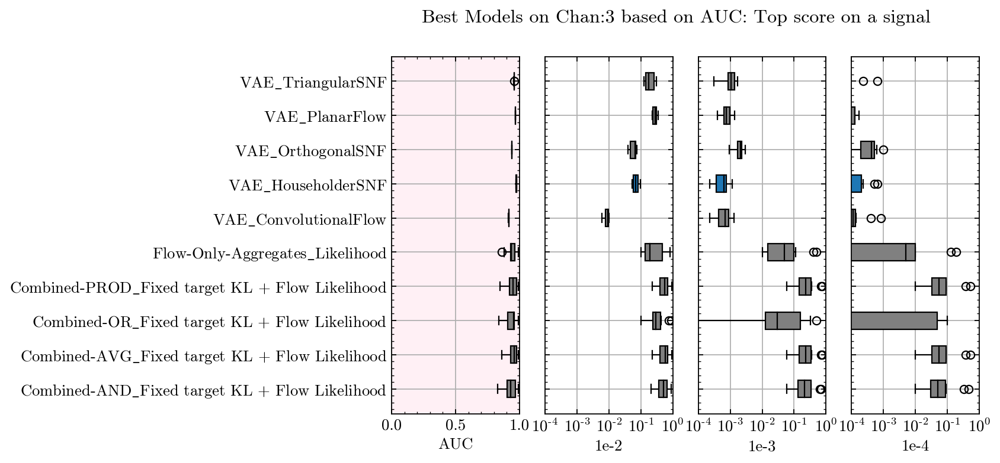

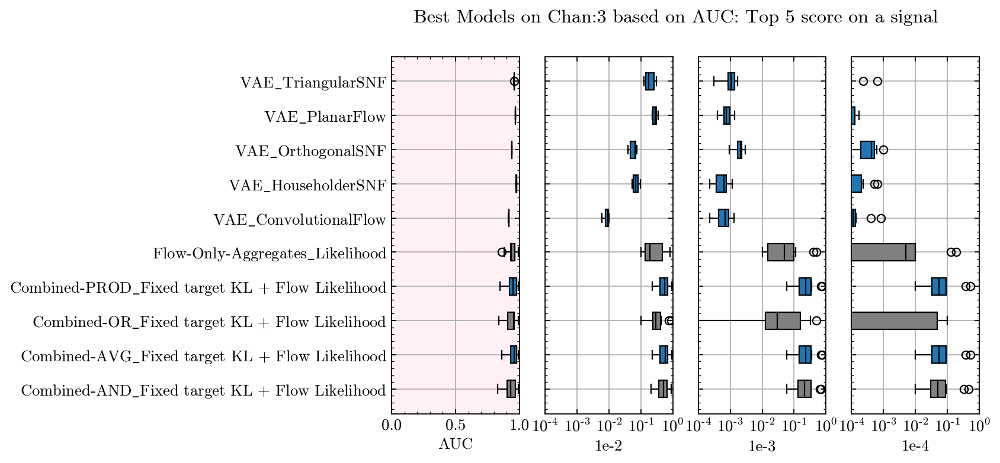

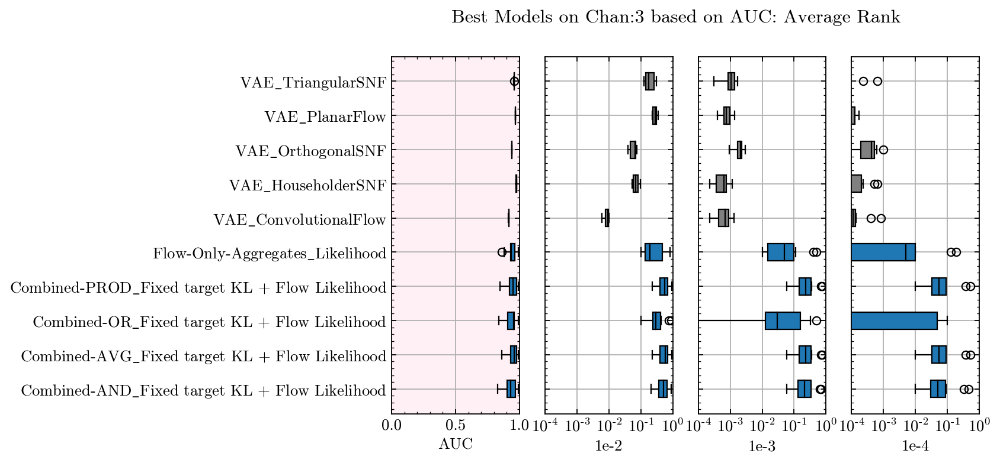

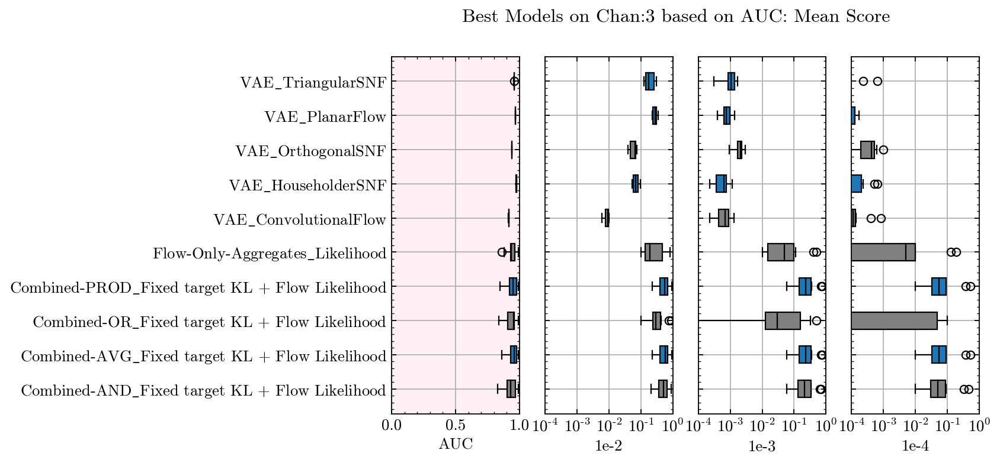

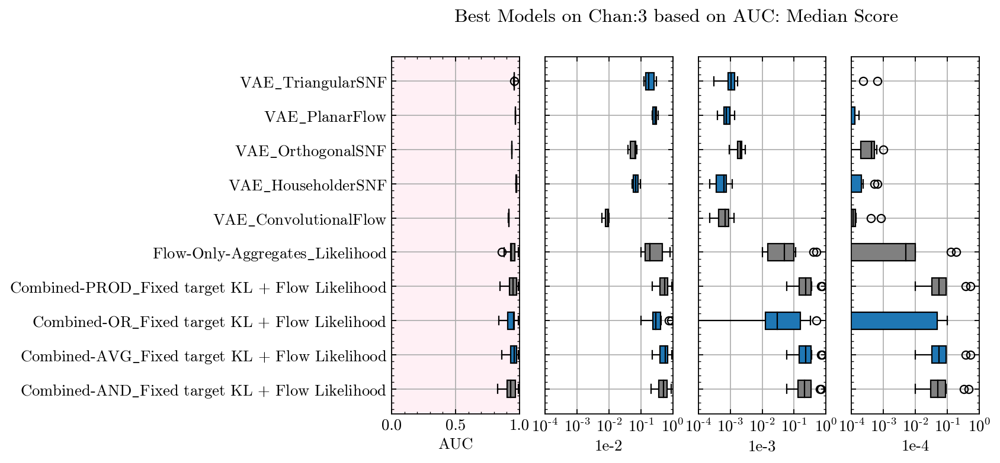

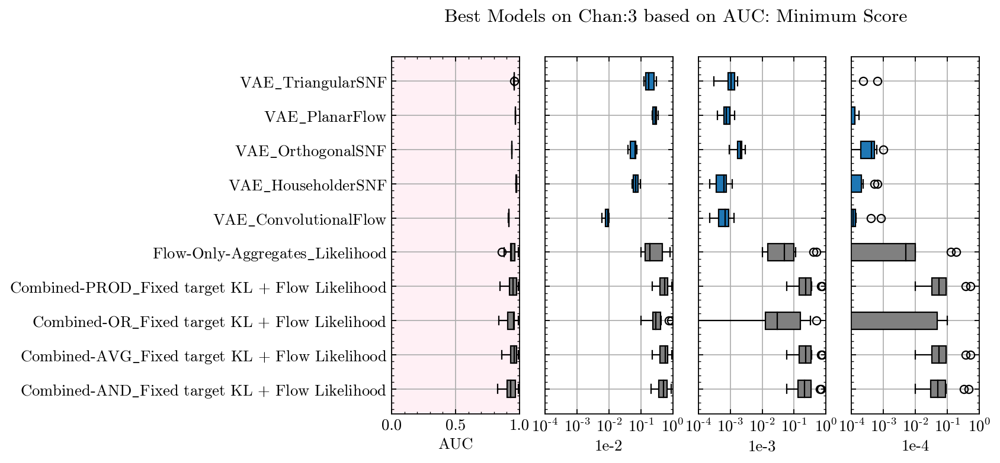

In [43]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='AUC',
        MetricNumberDict = {'top1': 1,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=1e-2 sorted by top1
                                               Model  top1
477   Combined-AVG_Fixed target KL + Flow Likelihood     5
476  Combined-PROD_Fixed target KL + Flow Likelihood     4
289                                   VAE_PlanarFlow     1
****************************************

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by top5
                                               Model  top5
477   Combined-AVG_Fixed target KL + Flow Likelihood    10
474   Combined-AND_Fixed target KL + Flow Likelihood    10
476  Combined-PROD_Fixed target KL + Flow Likelihood    10
****************************************

***************

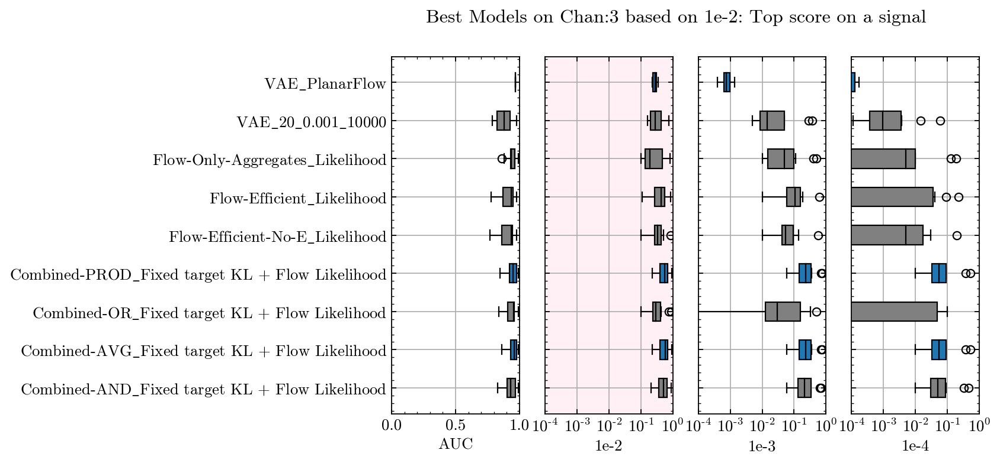

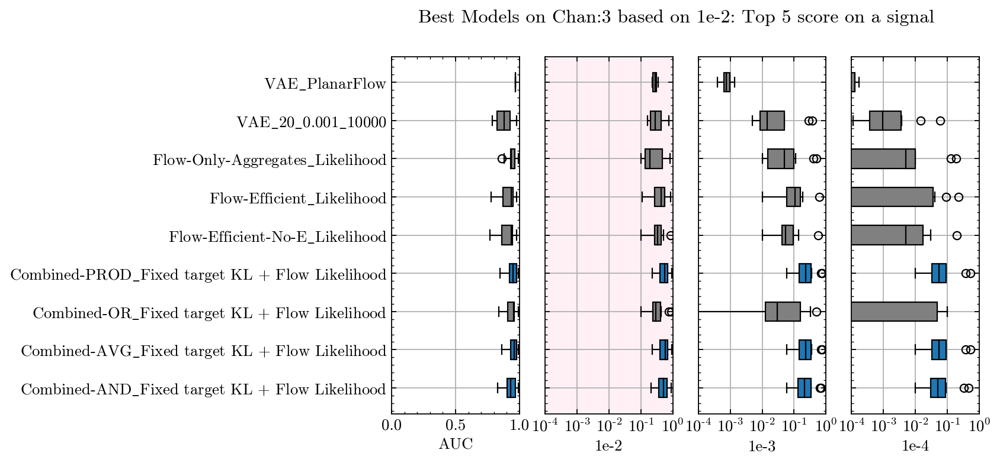

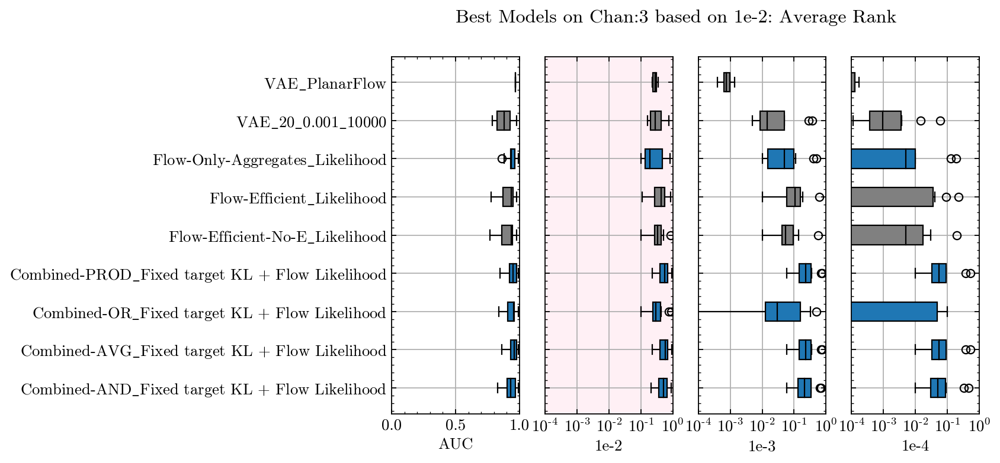

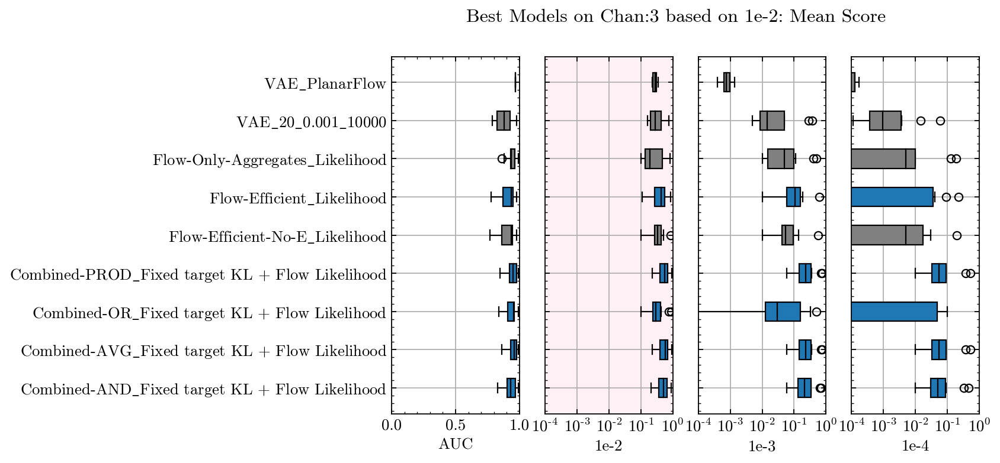

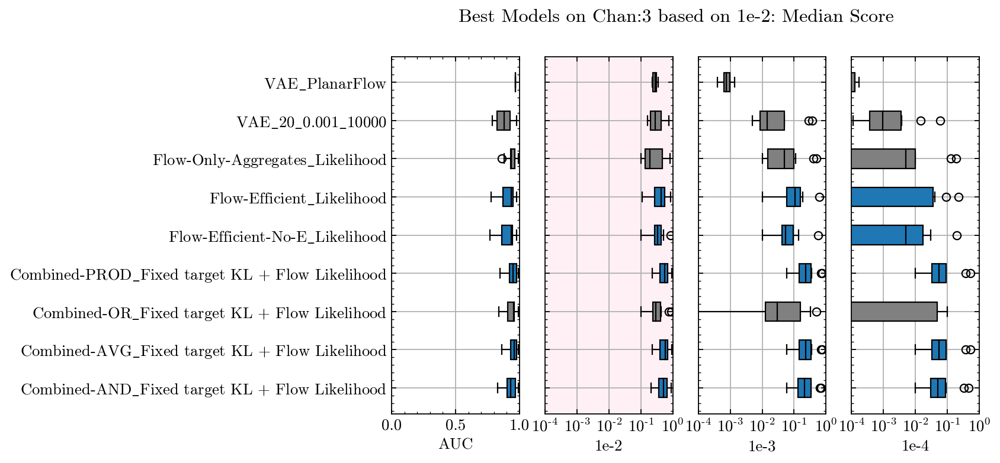

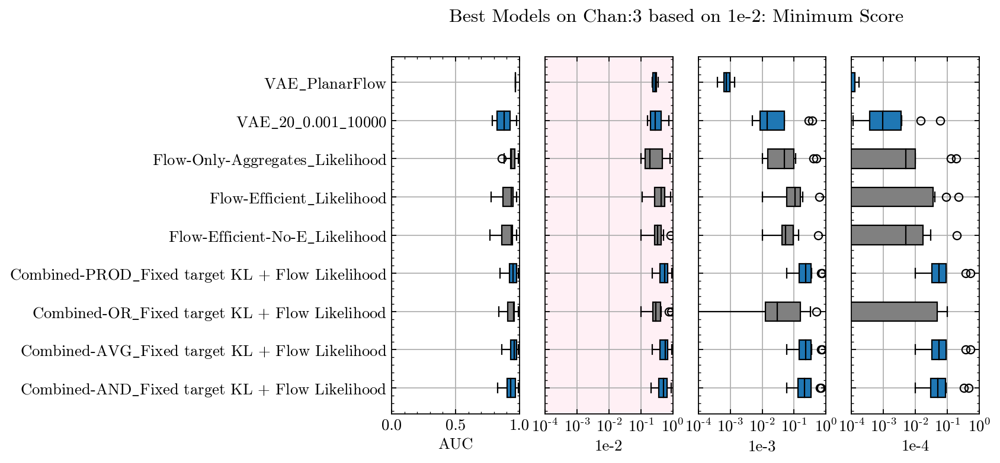

In [44]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 3,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=1e-3 sorted by top1
                                               Model  top1
477   Combined-AVG_Fixed target KL + Flow Likelihood     5
476  Combined-PROD_Fixed target KL + Flow Likelihood     3
****************************************

****************************************
Models from chan=3 ranked by metric=1e-3 sorted by top5
                                               Model  top5
474   Combined-AND_Fixed target KL + Flow Likelihood    10
477   Combined-AVG_Fixed target KL + Flow Likelihood    10
476  Combined-PROD_Fixed target KL + Flow Likelihood    10
****************************************

****************************************
Models from chan=3 ranked by metr

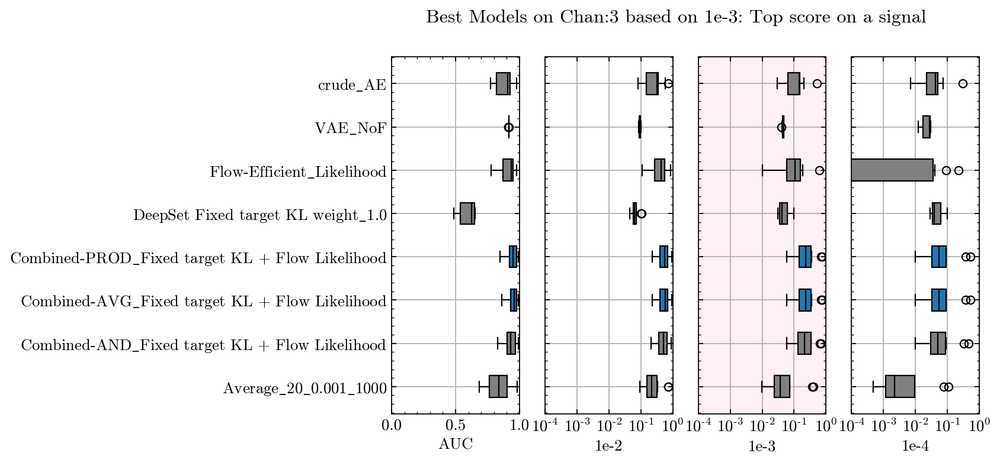

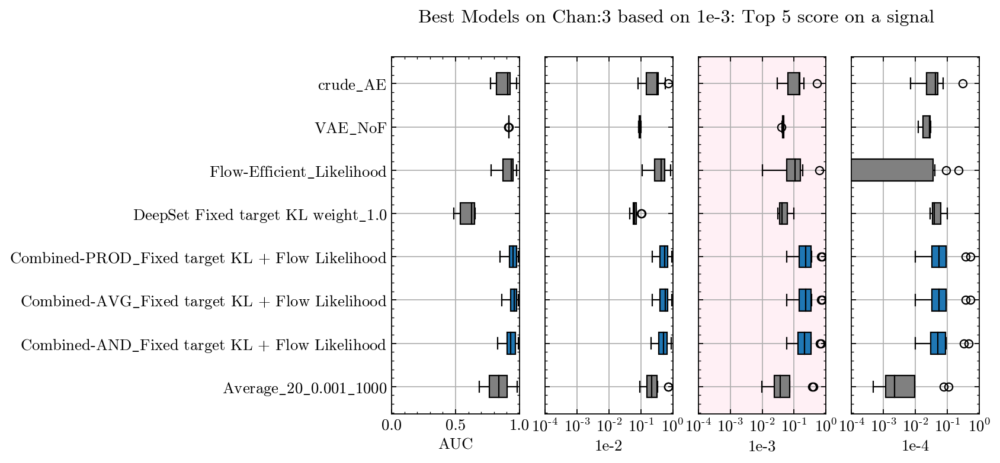

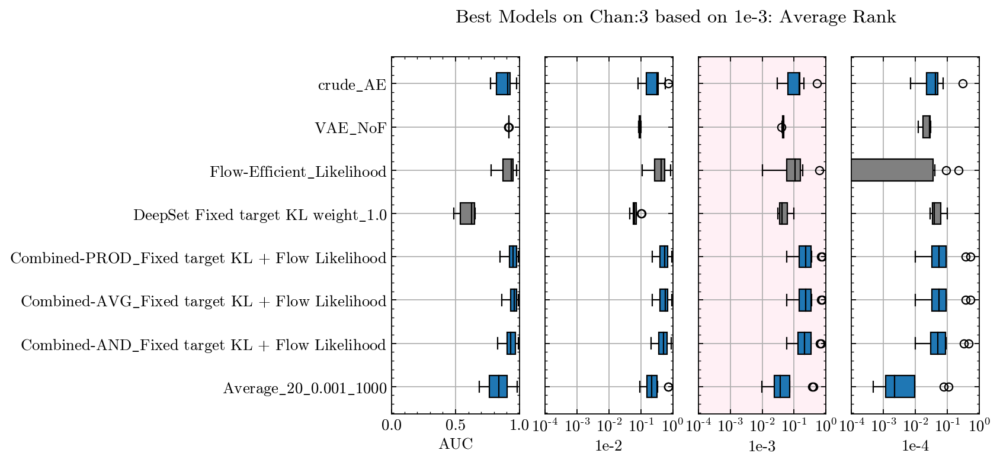

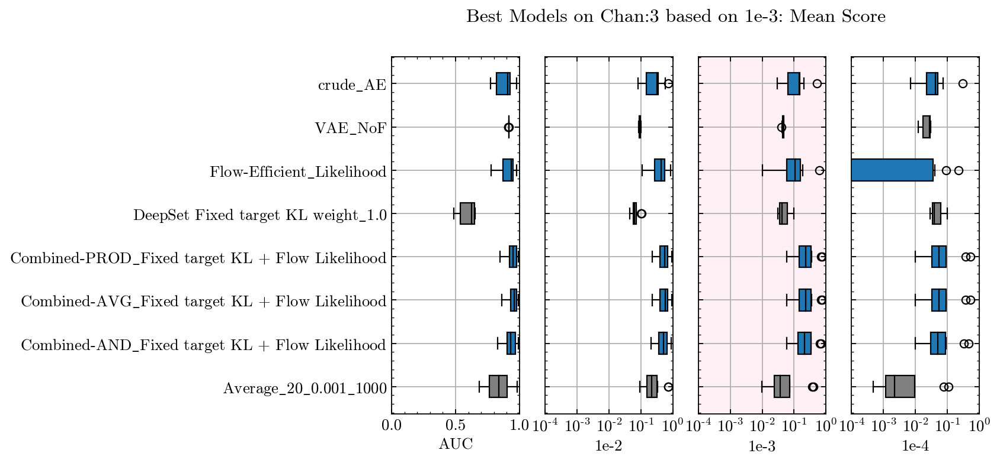

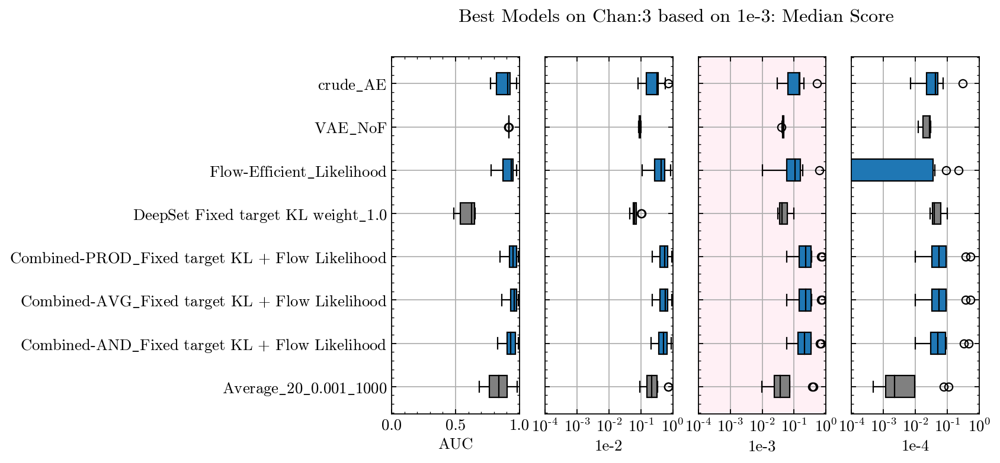

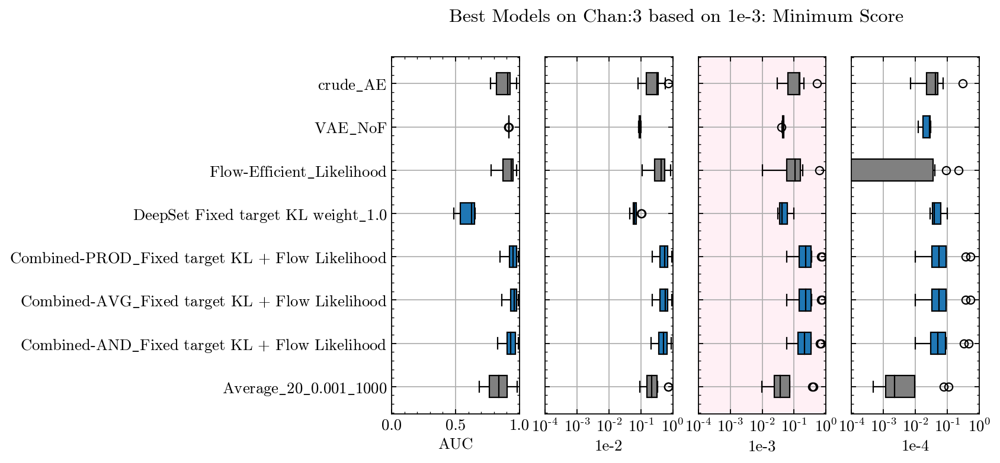

In [45]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 2,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=3 ranked by metric=1e-4 sorted by top1
                                              Model  top1
554                                        crude_AE     3
550              DeepSet Fixed target KL weight_1.0     3
477  Combined-AVG_Fixed target KL + Flow Likelihood     2
474  Combined-AND_Fixed target KL + Flow Likelihood     1
****************************************

****************************************
Models from chan=3 ranked by metric=1e-4 sorted by top5
                                               Model  top5
550               DeepSet Fixed target KL weight_1.0     7
476  Combined-PROD_Fixed target KL + Flow Likelihood     7
474   Combined-AND_Fixed target KL + Flow Likelihood     7
477

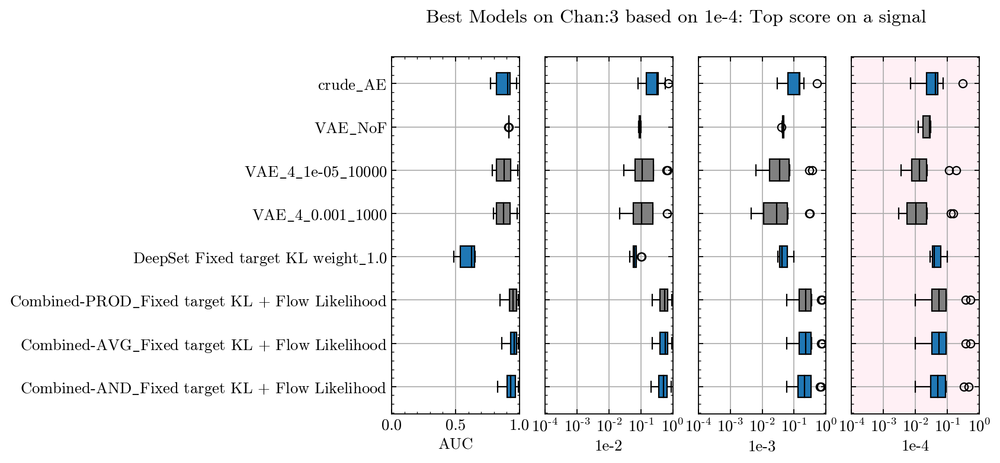

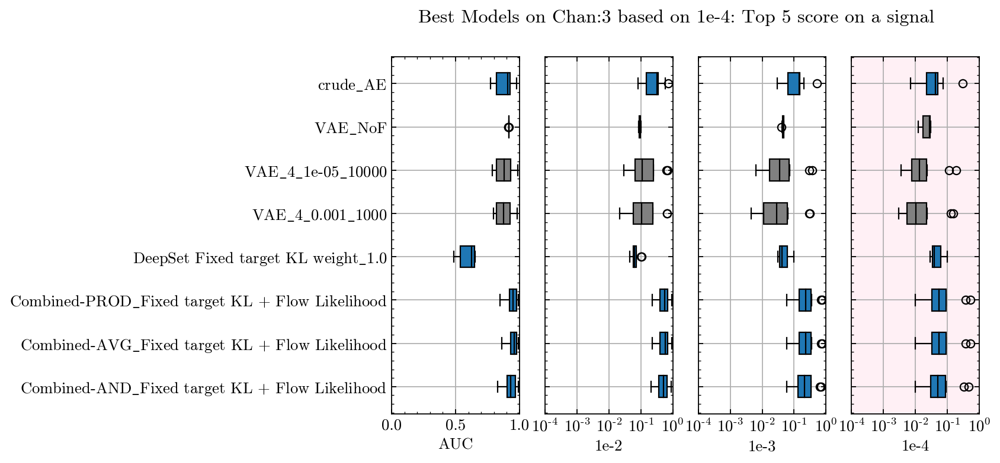

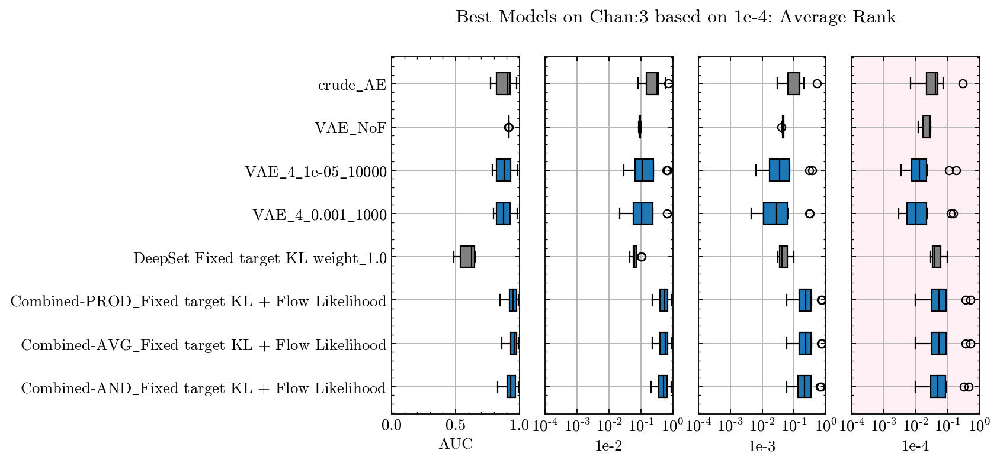

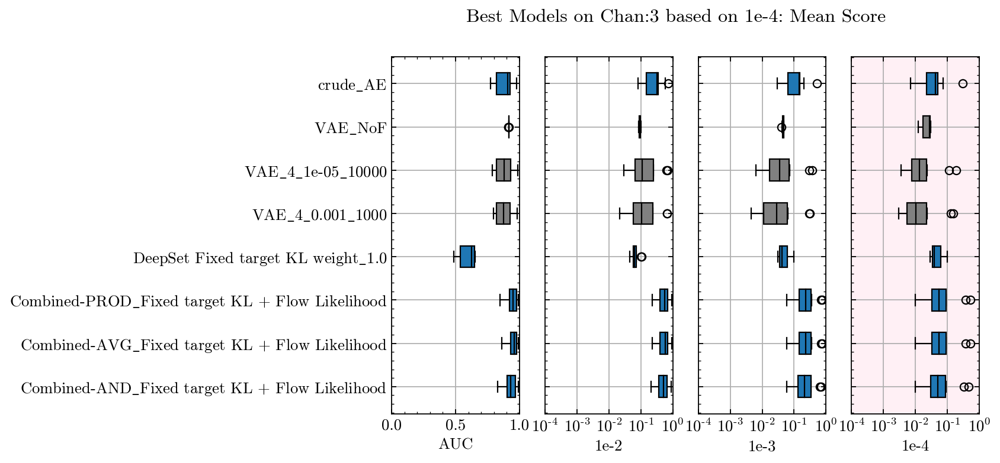

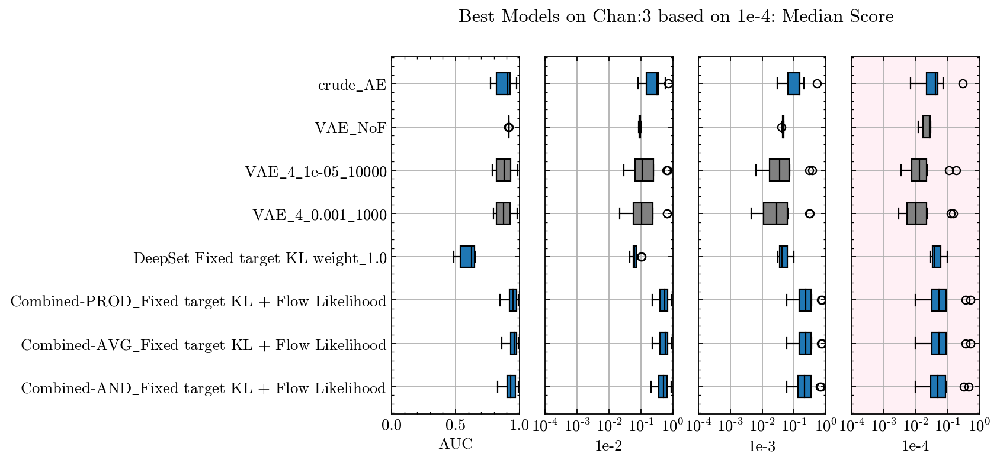

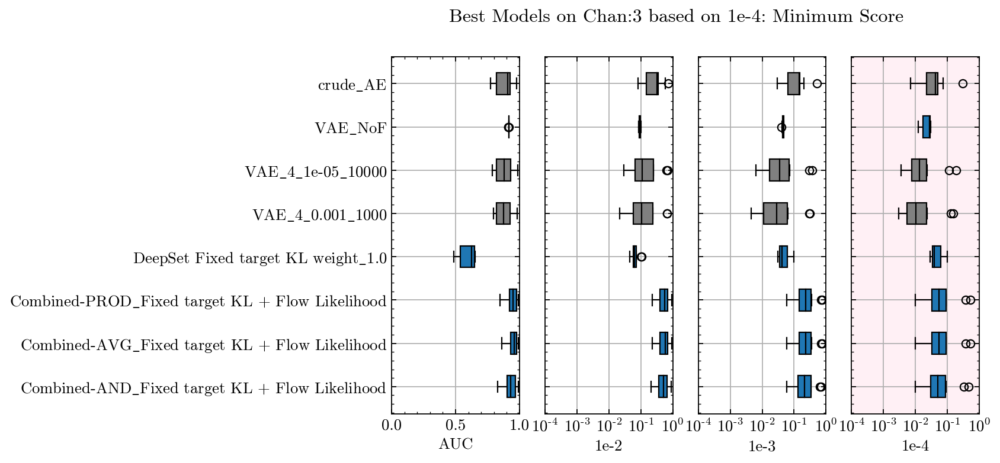

In [46]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## All Channels combined
### AUC

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=AUC sorted by top1
                                               Model  top1
290                               VAE_HouseholderSNF     6
291       

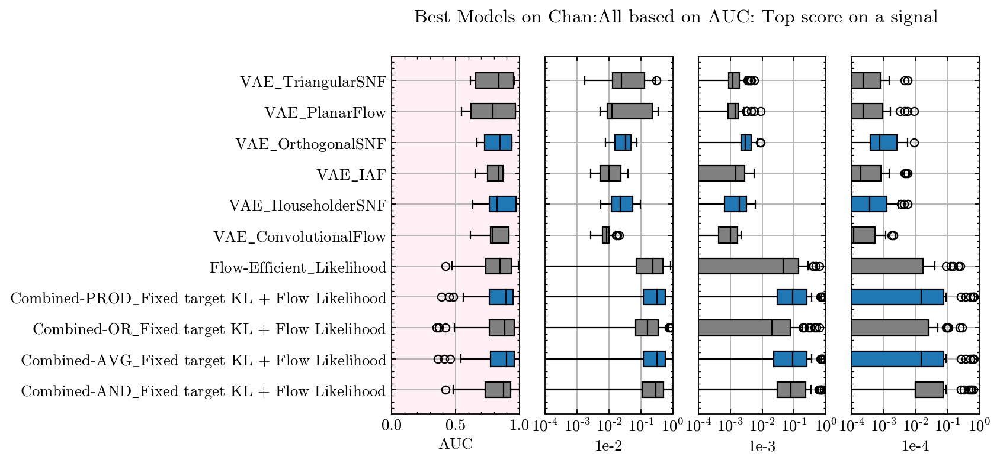

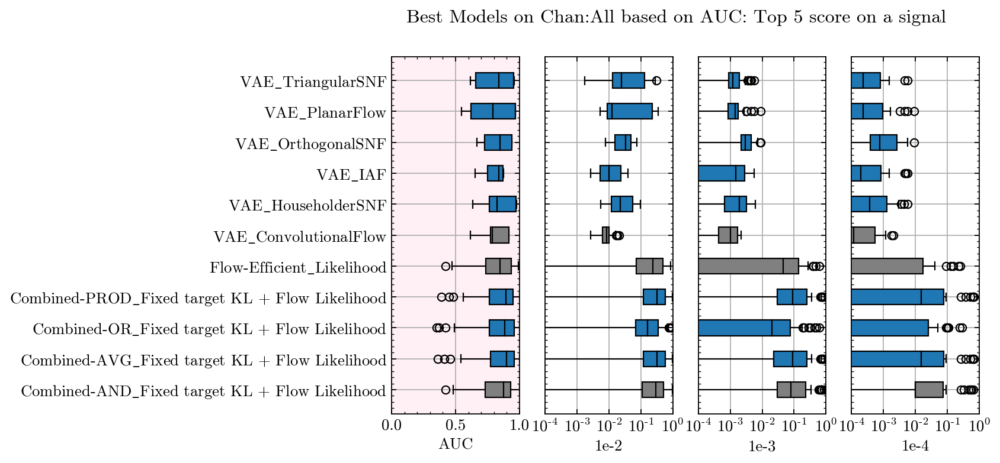

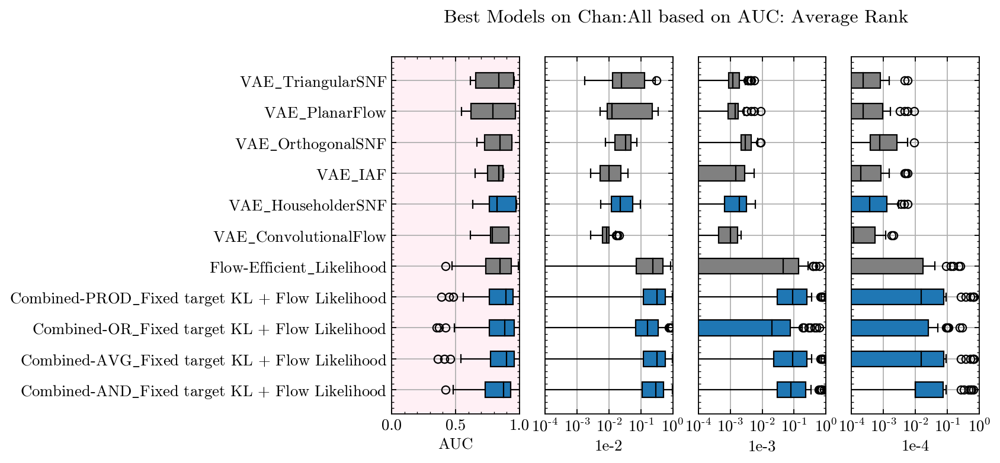

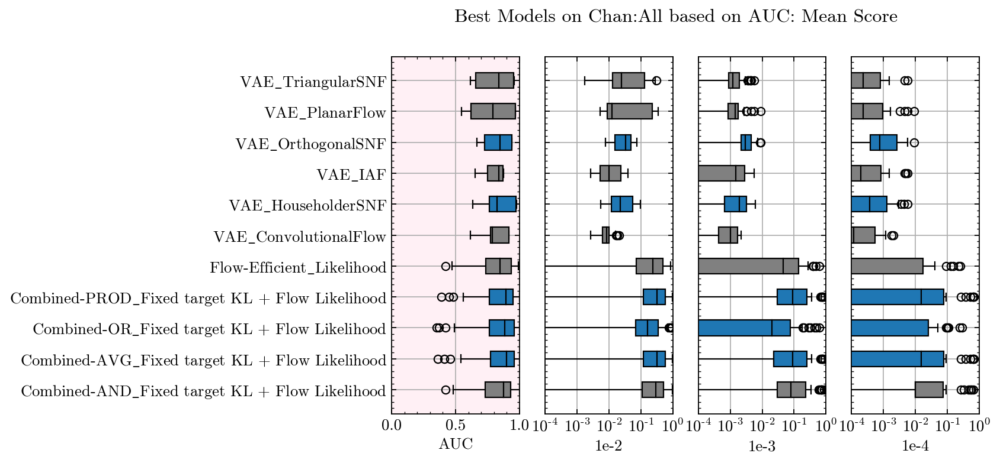

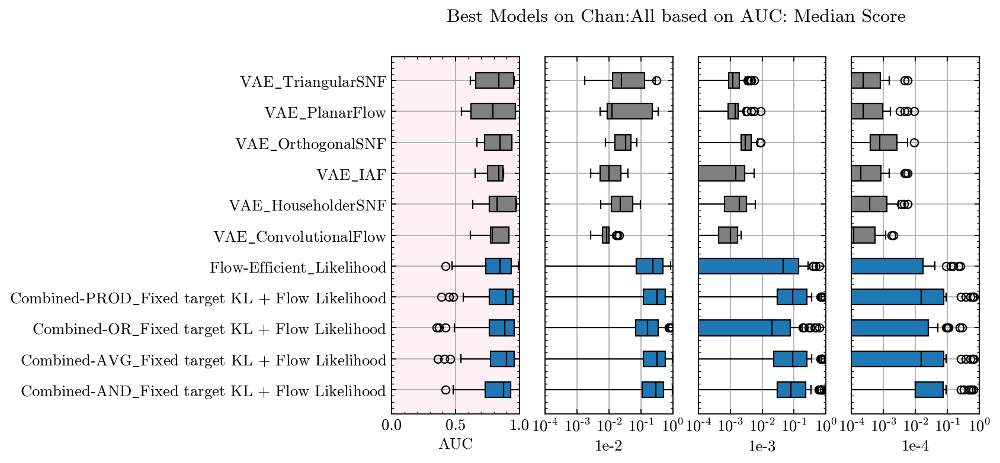

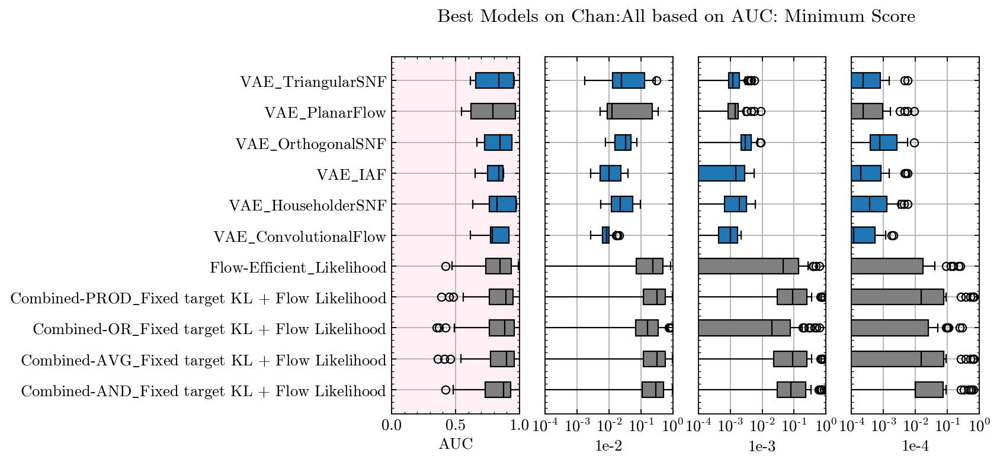

In [47]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='AUC',
        MetricNumberDict = {'top1': 4,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=1e-2 sorted by top1
                                               Model  top1
477   Combined-AVG_Fixed target KL + Flow Likelihood     8
476  Comb

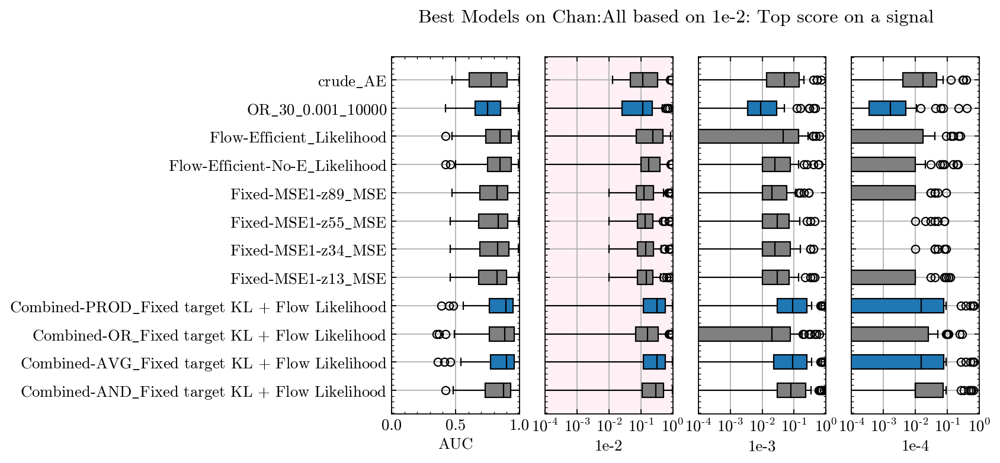

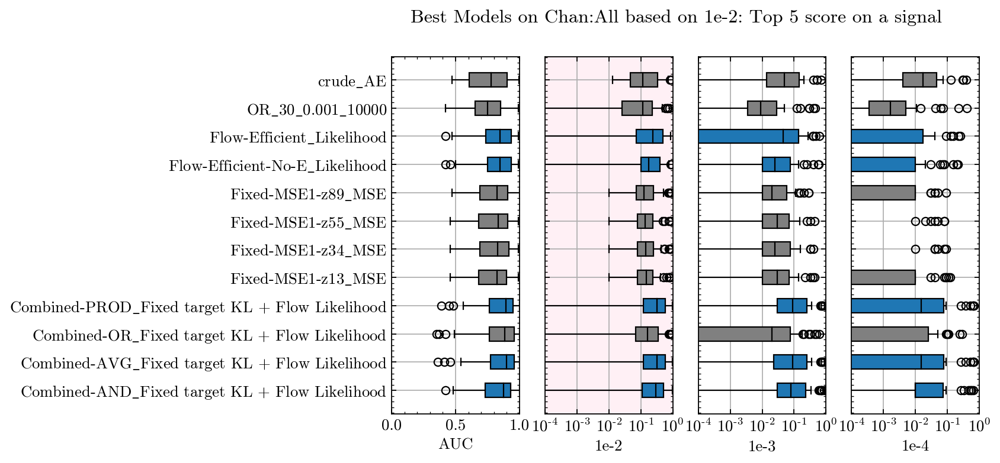

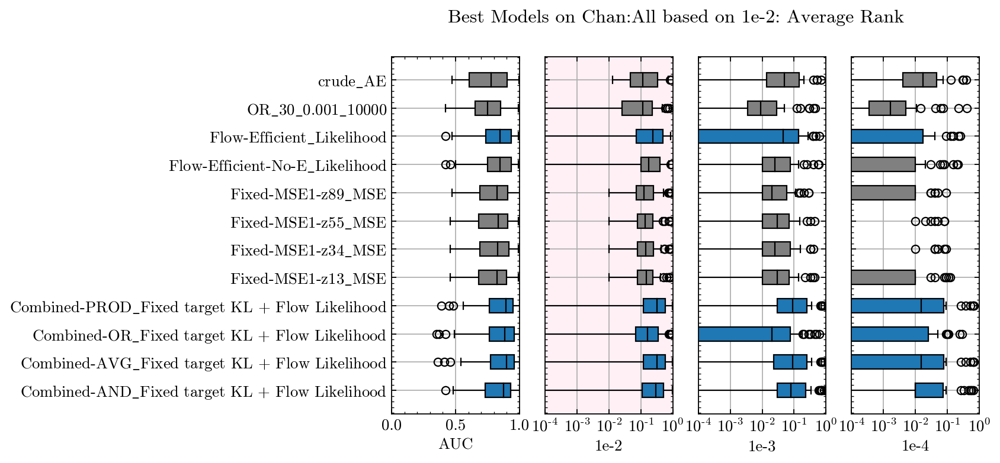

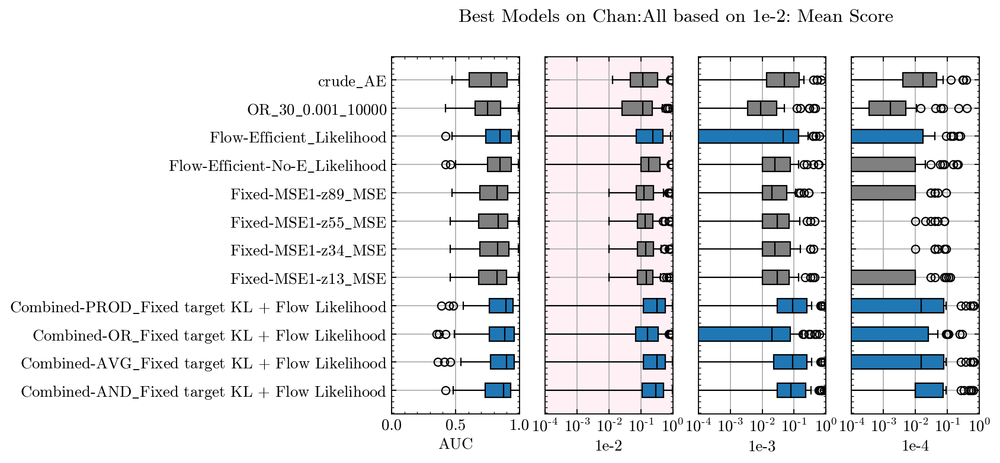

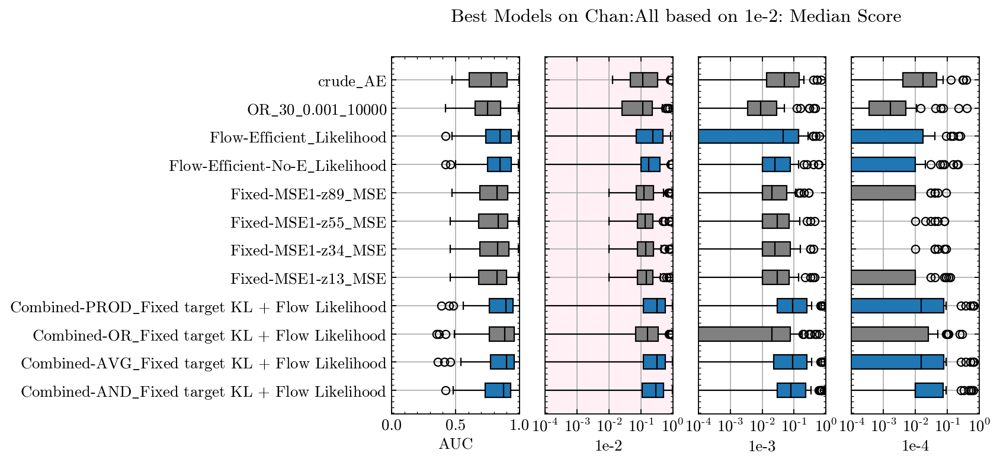

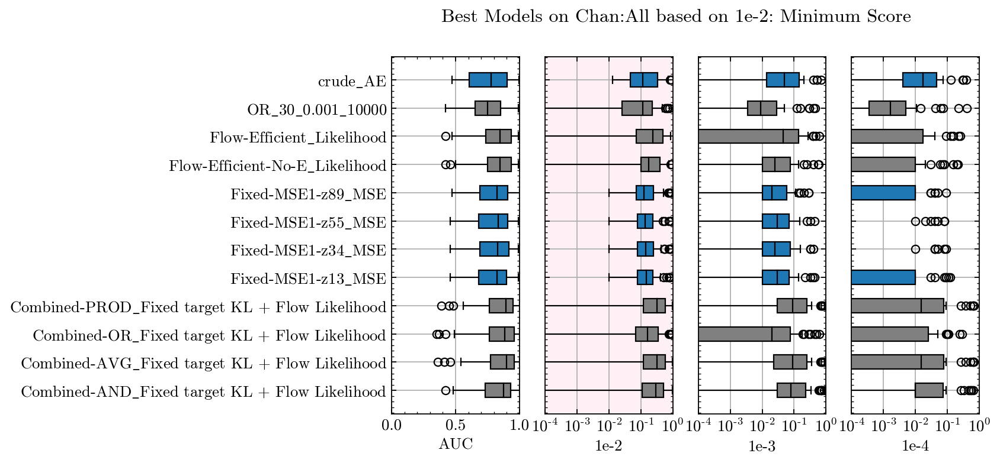

In [48]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 3,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=1e-3 sorted by top1
                                               Model  top1
477   Combined-AVG_Fixed target KL + Flow Likelihood     6
476  Comb

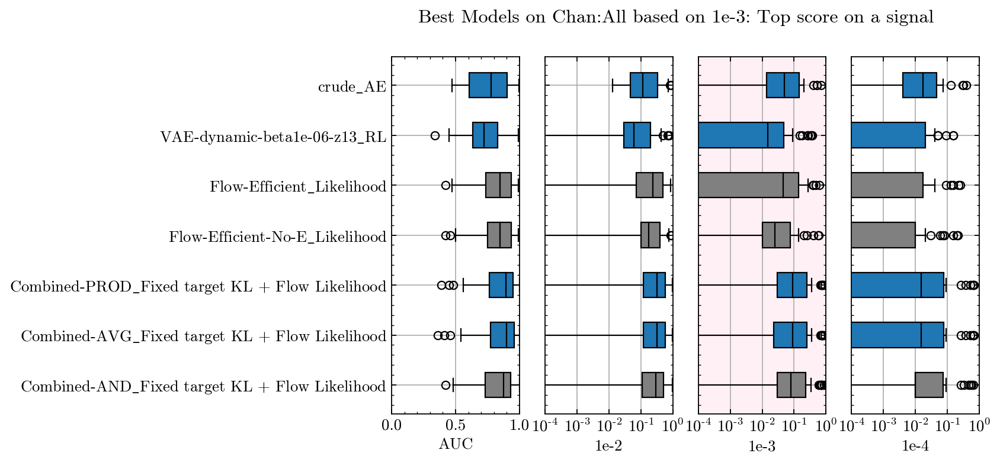

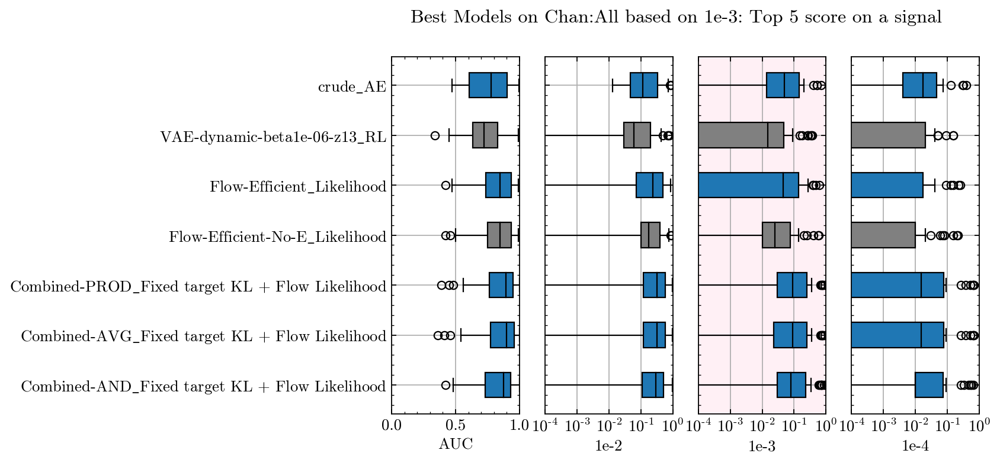

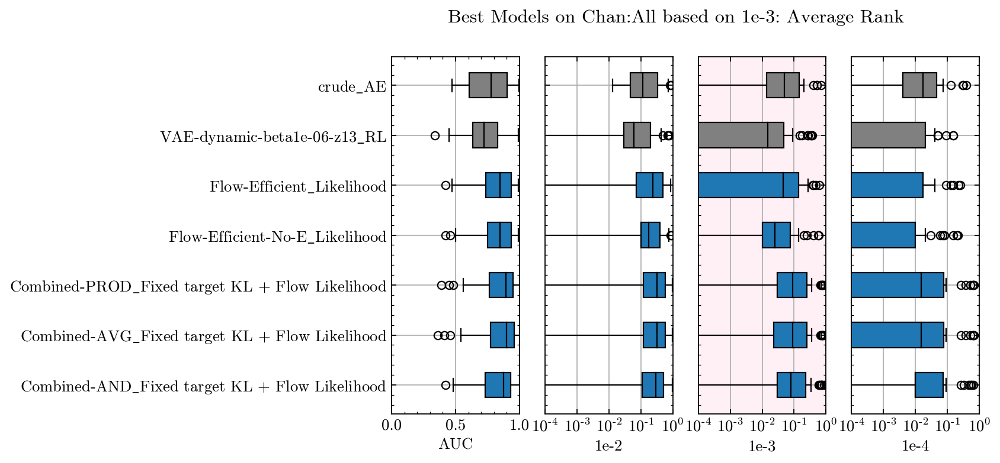

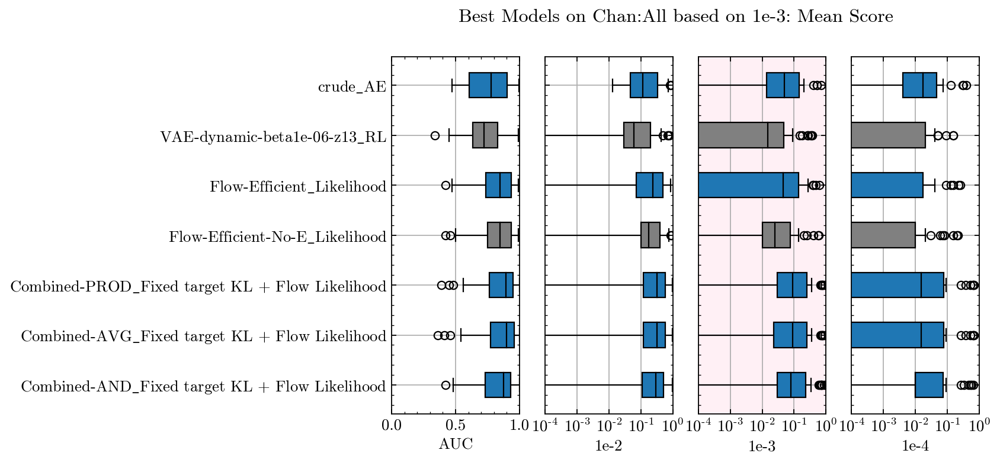

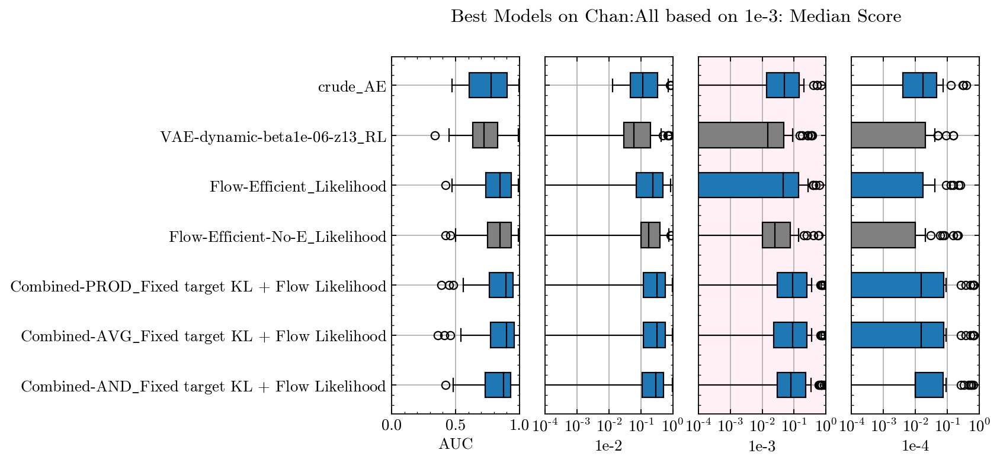

In [49]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

### 1e-4

1 glgl1400_neutralino1100
1 glgl1600_neutralino800
1 monojet_Zp2000.0_DM_50.0
1 monotop_200_A
1 sqsq1_sq1400_neut800
1 sqsq_sq1800_neut800
1 stlp_st1000
1 stop2b1000_neutralino300
2a chaneut_cha200_neut50
2a chaneut_cha250_neut150
2a chaneut_cha300_neut100
2a chaneut_cha400_neut200
2a gluino_1000.0_neutralino_1.0
2a pp23mt_50
2a pp24mt_50
2b chacha_cha300_neut140
2b chacha_cha400_neut60
2b chacha_cha600_neut200
2b chaneut_cha200_neut50
2b chaneut_cha250_neut150
2b gluino_1000.0_neutralino_1.0
2b pp23mt_50
2b pp24mt_50
2b stlp_st1000
3 glgl1400_neutralino1100
3 glgl1600_neutralino800
3 gluino_1000.0_neutralino_1.0
3 monoV_Zp2000.0_DM_1.0
3 monojet_Zp2000.0_DM_50.0
3 monotop_200_A
3 sqsq1_sq1400_neut800
3 sqsq_sq1800_neut800
3 stlp_st1000
3 stop2b1000_neutralino300
****************************************
Models from chan=All ranked by metric=1e-4 sorted by top1
                                   Model  top1
551  DeepSet Fixed target KL weight_10.0     6
554                             c

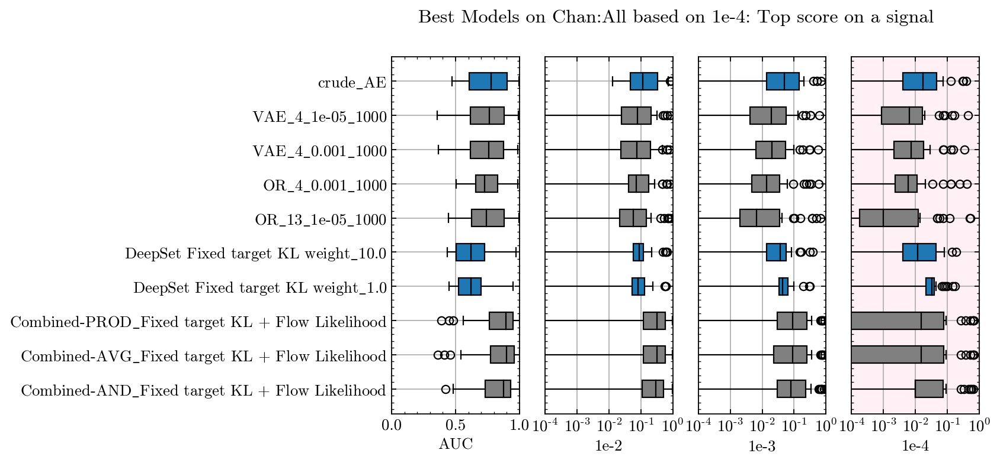

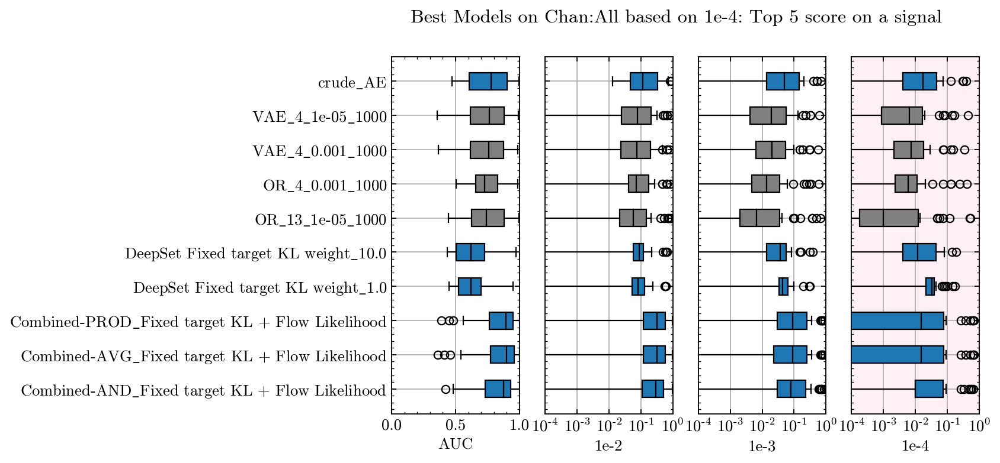

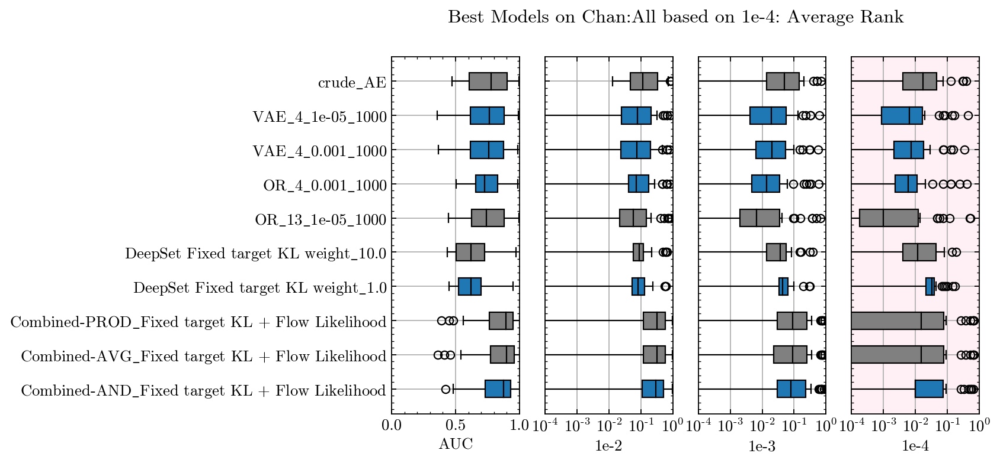

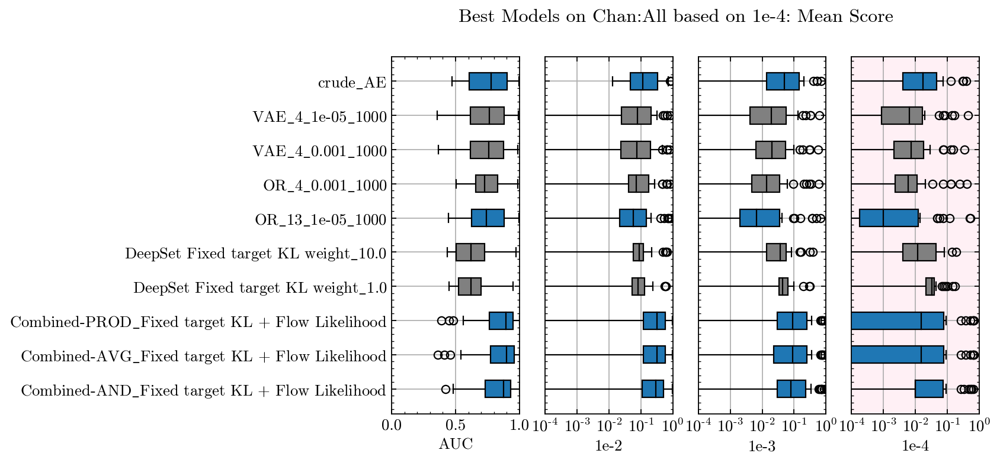

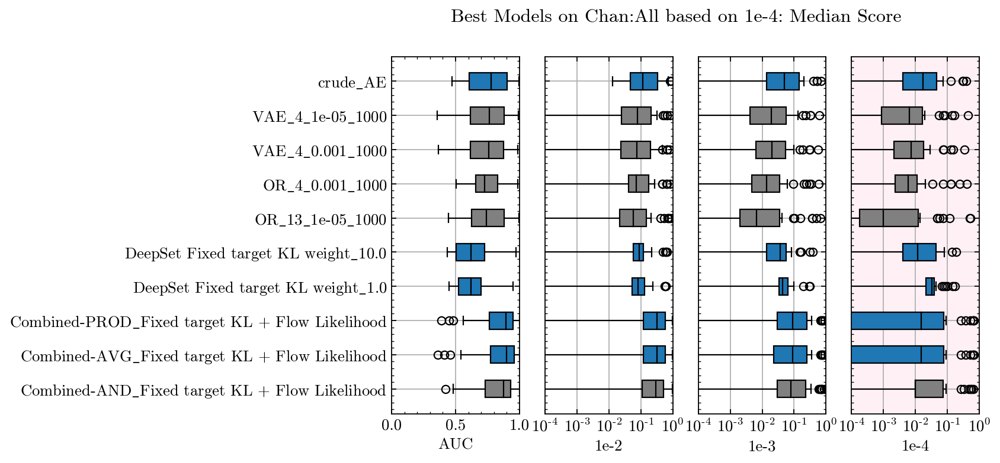

In [50]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 3,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

# Second combination
In the previous analysis, the models were grouped by how they did on the same metric, i.e. AUC or 1e-2. Each plot was then looking at a different ways of determining which models are best by that metric.

In the next analysis, the rolls will be flipped. The models will be grouped by the method of determining which does best, i.e. having the highest minimum or the highest average. The models which do best by this method for each metric will be shown on the same plot.

In [51]:
def AnalyzeByMethod(CombinedDataFrame, Chan, Method, MetricNumberDict, Plot):
    """
    Inputs:
        CombineedDataFrame: Pandas dataframe with columns ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
        Chan: String with which signal chanel is being analyzed. Must be one of ['1', '2a', '2b', '3', 'All']
        Method: String indicating the metric to use, must be one of ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']
        MetricNumberDict: The number of models to include for each sorting. Will usually include 5, 
            but some of the rankings need different numbers.
            example: MetricNumberDict = {'AUC': 5, 
                                         '1e-2': 5,
                                         '1e-3': 5,
                                         '1e-4': 5}
        Plot: Boolean if to make bar plots or not
        
    """
    for col in ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']:
        if col not in CombinedDataFrame.columns:
            print(f'CombinedDataFrame is missing column {col}')
            return 0
    if Chan not in ['1', '2a', '2b', '3', 'All']:
        print(f'Invalid "Chan" selection: {Chan}')
        return 0
    if Method not in ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']:
        print(f'Invalid "Method" selection: {Method}')
        return 0
    
    if Chan != 'All':
        AnalyzeFrame = CombinedDataFrame[CombinedDataFrame['Chan'] == Chan]
    else:
        AnalyzeFrame = CombinedDataFrame
    
    # This helper variable combines the channel and signal since some signals appear in multiple channels
    chansig = AnalyzeFrame['Chan'] + '/' + AnalyzeFrame['Signal']
    chansig = np.unique(chansig)
    sigs = AnalyzeFrame.Signal.unique()
    mods = AnalyzeFrame.Model.unique()
    SortedScores = pd.DataFrame()
    SortedScores['Model'] = mods
    
    SortedScores = {}
    BestC = []
    TopDict = {}
    for Metric in ['AUC', '1e-2', '1e-3', '1e-4']:
        SortedScores[Metric] = pd.DataFrame()
        SortedScores[Metric]['Model'] = mods
        
        # Go through each of the signals to find the ranking of the models for AUC

        for sig in chansig:
            chan, sig = sig.split('/')
            cs = AnalyzeFrame[(AnalyzeFrame['Signal'] == sig) & (AnalyzeFrame['Chan']==chan)]
            scorelist = cs[Metric]
            score_ranking = np.zeros_like(scorelist)
            for i, score in enumerate(np.argsort(-scorelist)):  # argsort gives the ordering to sort them, we want the orthogonal information
                score_ranking[score] = i
            SortedScores[Metric][sig] = score_ranking
        SortedScores[Metric]['AverageRank'] = SortedScores[Metric][[col for col in SortedScores[Metric].columns if 'Model' not in col]].mean(axis=1)
        SortedScores[Metric]['top1'] = (SortedScores[Metric][[col for col in SortedScores[Metric].columns if (('AverageRank' not in col)
                                                                                      and ('Model' not in col)
                                                                                     )]] < 1).sum(axis=1)
        SortedScores[Metric]['top5'] = (SortedScores[Metric][[col for col in SortedScores[Metric].columns if (('AverageRank' not in col) and 
                                                                                      ('top1' not in col) and
                                                                                      ('Model' not in col)
                                                                                     )]] < 5).sum(axis=1)

        meanscore = []
        medianscore = []
        minscore = []
        for m in mods:
            tmpdf = AnalyzeFrame[AnalyzeFrame['Model'] == m]
            tmpscores = tmpdf[Metric]
            meanscore.append(tmpscores.mean())
            medianscore.append(tmpscores.median())
            minscore.append(tmpscores.min())
        SortedScores[Metric]['MeanScore'] = meanscore
        SortedScores[Metric]['MedianScore'] = medianscore
        SortedScores[Metric]['MinScore'] = minscore
    
        num = MetricNumberDict[Metric]
        if num == 0: continue
        TopDict[Metric] = SortedScores[Metric].sort_values(by=Method,ascending=True if Method =='AverageRank' else False)[['Model']][:num].to_numpy().reshape(num)
        BestC += list(TopDict[Metric])
        print('*'*40)
        print(f'Models from chan={Chan} ranked by metric={Metric} sorted by {Method}')
        print(SortedScores[Metric].sort_values(by=Method,ascending=True if Method =='AverageRank' else False)[['Model', Method]][:num])
        print('*'*40)
        print()
        
    if Plot:
        nameddict = {'top1': 'Top score on a signal',
                     'top5': 'Top 5 score on a signal',
                     'AverageRank': 'Average Rank',
                     'MeanScore': 'Mean Score',
                     'MedianScore': 'Median Score',
                     'MinScore': 'Minimum Score'
                    }
        name = nameddict[Method]
        BestC = np.array(BestC).flatten()
        BestCU = np.unique(BestC)
        
        plt.figure(figsize=(8, 5))

        for colnum, col in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
            colors = ['grey' for m in BestCU]
            
            if col in TopDict:
                for bestnum, m in enumerate(TopDict[col]):
                    for mnum, mtop in enumerate(BestCU):
                        if m == mtop:
                            colors[mnum] = f'C{bestnum}'
            ax = plt.subplot(1, 4, colnum + 1)
            yvs=[]
            names = []
            data_all = []
            for i,m in enumerate(BestCU):
                tmp_data = []
                tmpdf = AnalyzeFrame[AnalyzeFrame['Model']==m].copy()
                for s in chansig:
                    chan, s = s.split('/')
                    tmpauc = tmpdf[(tmpdf['Signal'] == s) & (tmpdf['Chan']==chan)][col]
                    tmp_data.append(tmpauc)
                data_all.append(np.array(tmp_data).reshape(len(chansig)))
                yvs.append(i)
                names.append(m)
            databp = np.array(data_all).reshape(len(BestCU), len(chansig))
            databp[databp == 0] = 1e-10
            bbox1 = plt.boxplot(databp.T,
                        vert=False,
                        manage_ticks=False,
                        patch_artist=True,
                        medianprops={'color':'k'},
                        positions=yvs
                       )

            if colnum == 0:
                plt.yticks(yvs, [n.replace('_', r'$\_$') for n in names])
                plt.xlim(0, 1)
            else:
                plt.yticks(yvs, [])
                plt.xscale('log')
                plt.xlim(1e-4, 1)
                plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1e0])


            for patch, color, flier in zip(bbox1['boxes'], colors, bbox1['fliers']):
                patch.set_facecolor(color)
                flier.set_markerfacecolor(color)
                flier.set_markerfacecolor(color)
                flier.set_markeredgecolor(color)
            plt.minorticks_on()
            plt.grid()
            plt.xlabel(col)
            
        legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Best'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='2nd'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='3rd'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='4th'),
                   Patch(facecolor='C4', edgecolor='k',
                         label='5th')
                  ]
        plt.legend(handles=legend_elements, 
                   loc=(1.05,0.3), 
                   labelspacing=1,
#                    ncol=5,
                   facecolor='white',
                   framealpha=1,
        #            markerscale=100,
                   frameon=True)

        plt.suptitle(f'Best Models on Chan: {Chan}, based on {name}')
        plt.savefig(f'../reports/Plots/TopChan{Chan}_{name.replace(" ", "_")}_boxplot.pdf', bbox_inches='tight')   

## All Channels
### Top 1

****************************************
Models from chan=All ranked by metric=AUC sorted by top1
                                               Model  top1
290                               VAE_HouseholderSNF     6
291                                VAE_OrthogonalSNF     4
477   Combined-AVG_Fixed target KL + Flow Likelihood     3
476  Combined-PROD_Fixed target KL + Flow Likelihood     2
312                                  VAE_b=1e-5_D=10     1
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top1
                                               Model  top1
477   Combined-AVG_Fixed target KL + Flow Likelihood     8
476  Combined-PROD_Fixed target KL + Flow Likelihood     4
177                                OR_30_0.001_10000     2
496                                Fixed-MSE1-z5_MSE     1
10                                    IF_20_0.1_1000     1
****************************************

***********

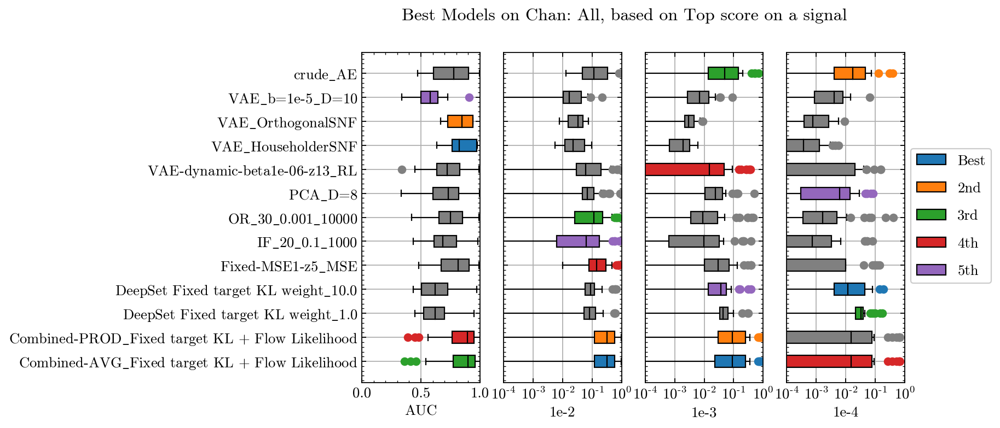

In [52]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='top1', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Top 5

****************************************
Models from chan=All ranked by metric=AUC sorted by top5
                                              Model  top5
292                               VAE_TriangularSNF    11
477  Combined-AVG_Fixed target KL + Flow Likelihood    11
290                              VAE_HouseholderSNF    10
291                               VAE_OrthogonalSNF    10
289                                  VAE_PlanarFlow     9
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top5
                                               Model  top5
476  Combined-PROD_Fixed target KL + Flow Likelihood    13
474   Combined-AND_Fixed target KL + Flow Likelihood    13
477   Combined-AVG_Fixed target KL + Flow Likelihood    13
471                        Flow-Efficient_Likelihood     9
472                   Flow-Efficient-No-E_Likelihood     9
****************************************

*****************

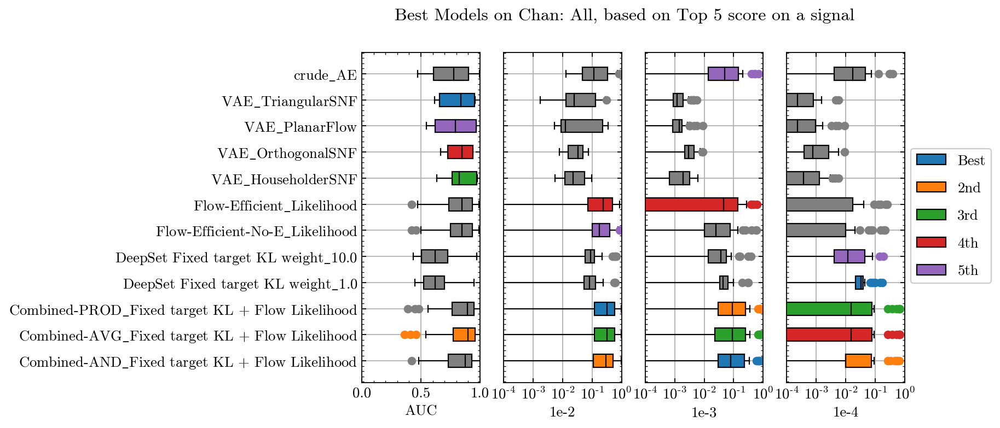

In [53]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='top5', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Average Rank

****************************************
Models from chan=All ranked by metric=AUC sorted by AverageRank
                                               Model  AverageRank
476  Combined-PROD_Fixed target KL + Flow Likelihood    17.789474
477   Combined-AVG_Fixed target KL + Flow Likelihood    18.000000
474   Combined-AND_Fixed target KL + Flow Likelihood    22.684211
290                               VAE_HouseholderSNF    30.052632
475    Combined-OR_Fixed target KL + Flow Likelihood    37.315789
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by AverageRank
                                               Model  AverageRank
477   Combined-AVG_Fixed target KL + Flow Likelihood    36.526316
476  Combined-PROD_Fixed target KL + Flow Likelihood    37.052632
474   Combined-AND_Fixed target KL + Flow Likelihood    41.210526
471                        Flow-Efficient_Likelihood    49.578947
475    Combined-OR_Fi

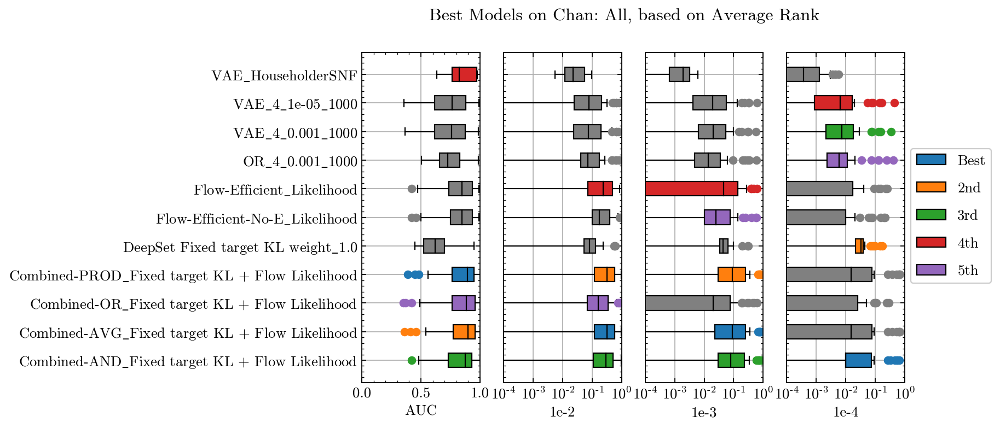

In [54]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='AverageRank', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Mean Score

****************************************
Models from chan=All ranked by metric=AUC sorted by MeanScore
                                               Model  MeanScore
477   Combined-AVG_Fixed target KL + Flow Likelihood   0.831471
476  Combined-PROD_Fixed target KL + Flow Likelihood   0.827941
290                               VAE_HouseholderSNF   0.820322
475    Combined-OR_Fixed target KL + Flow Likelihood   0.816176
291                                VAE_OrthogonalSNF   0.815963
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MeanScore
                                               Model  MeanScore
477   Combined-AVG_Fixed target KL + Flow Likelihood   0.372941
476  Combined-PROD_Fixed target KL + Flow Likelihood   0.371471
474   Combined-AND_Fixed target KL + Flow Likelihood   0.350588
471                        Flow-Efficient_Likelihood   0.291471
475    Combined-OR_Fixed target KL + Flow Likel

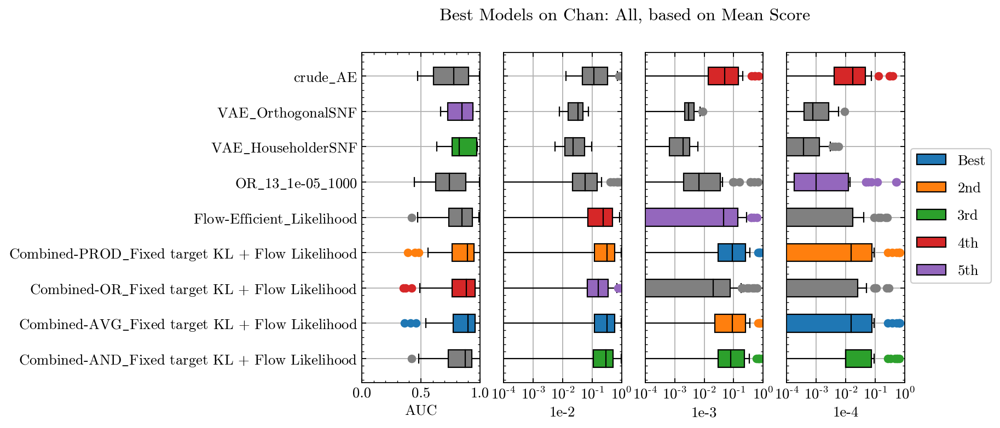

In [55]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MeanScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Median Score

****************************************
Models from chan=All ranked by metric=AUC sorted by MedianScore
                                               Model  MedianScore
477   Combined-AVG_Fixed target KL + Flow Likelihood        0.900
476  Combined-PROD_Fixed target KL + Flow Likelihood        0.895
475    Combined-OR_Fixed target KL + Flow Likelihood        0.885
474   Combined-AND_Fixed target KL + Flow Likelihood        0.875
471                        Flow-Efficient_Likelihood        0.850
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MedianScore
                                               Model  MedianScore
476  Combined-PROD_Fixed target KL + Flow Likelihood        0.315
477   Combined-AVG_Fixed target KL + Flow Likelihood        0.315
474   Combined-AND_Fixed target KL + Flow Likelihood        0.300
471                        Flow-Efficient_Likelihood        0.235
472                  

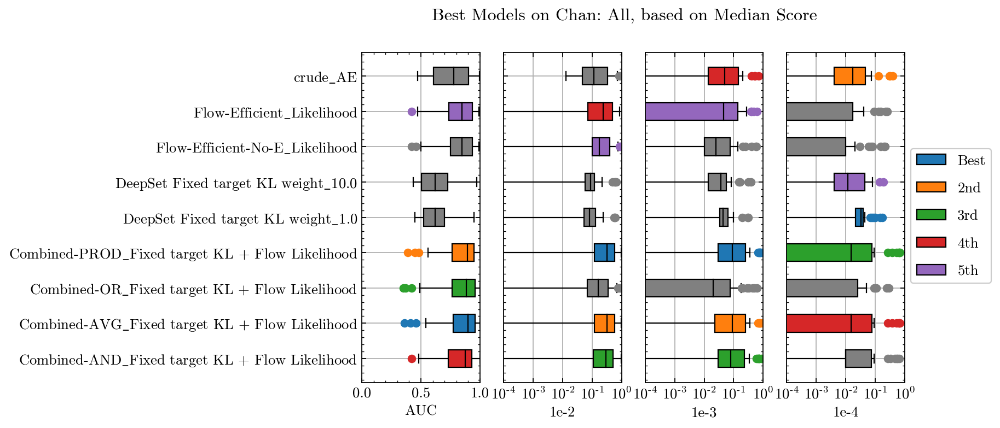

In [56]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MedianScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Best Minimum Score

****************************************
Models from chan=All ranked by metric=AUC sorted by MinScore
                     Model  MinScore
291      VAE_OrthogonalSNF  0.666274
293                VAE_IAF  0.655265
290     VAE_HouseholderSNF  0.634438
292      VAE_TriangularSNF  0.617532
294  VAE_ConvolutionalFlow  0.615684
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MinScore
                  Model  MinScore
554            crude_AE  0.013274
498  Fixed-MSE1-z13_MSE  0.010000
500  Fixed-MSE1-z34_MSE  0.010000
501  Fixed-MSE1-z55_MSE  0.010000
502  Fixed-MSE1-z89_MSE  0.010000
****************************************



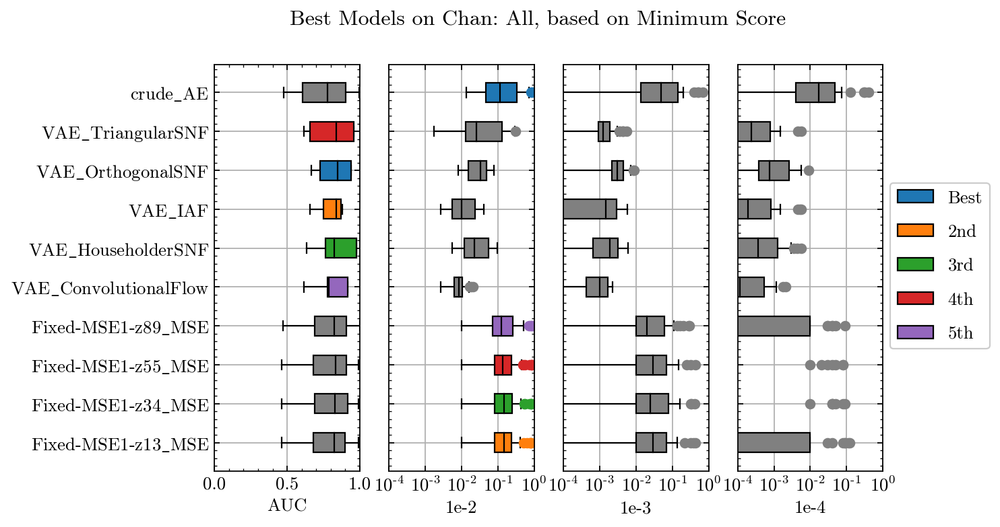

In [57]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 0,
                                  '1e-4': 0}, 
                Plot=True
               )

## Scan through individual channels
### Chan 1

****************************************
Models from chan=1 ranked by metric=AUC sorted by MinScore
                            Model  MinScore
294         VAE_ConvolutionalFlow  0.770178
290            VAE_HouseholderSNF  0.746779
293                       VAE_IAF  0.731834
470  VAE-dynamic-beta1-z34_Radius  0.730000
291             VAE_OrthogonalSNF  0.720097
****************************************

****************************************
Models from chan=1 ranked by metric=1e-2 sorted by MinScore
                                              Model  MinScore
303                                        PCA_D=10  0.111111
554                                        crude_AE  0.106000
302                                         PCA_D=9  0.098765
550              DeepSet Fixed target KL weight_1.0  0.081416
477  Combined-AVG_Fixed target KL + Flow Likelihood  0.080000
****************************************

****************************************
Models from chan=1 ranked by metric=1e

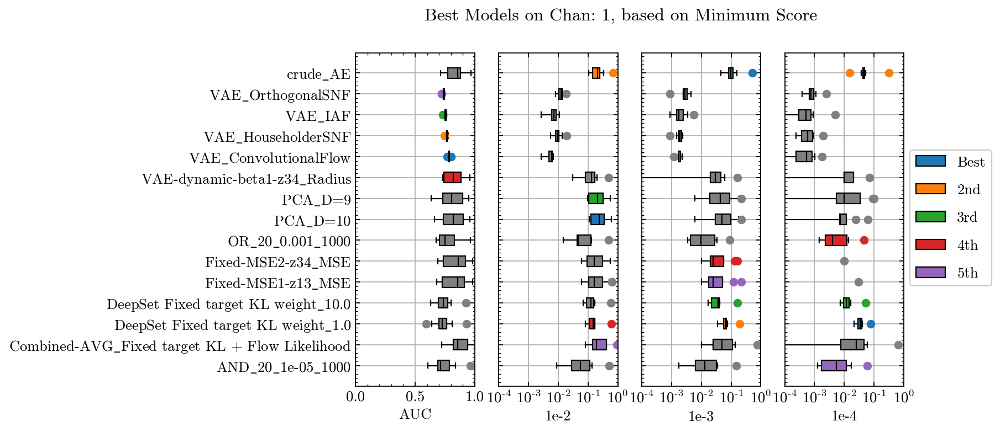

In [58]:
AnalyzeByMethod(AllCombined, 
                Chan='1', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Chan 2a

****************************************
Models from chan=2a ranked by metric=AUC sorted by MinScore
                  Model  MinScore
291   VAE_OrthogonalSNF  0.666274
293             VAE_IAF  0.655265
292   VAE_TriangularSNF  0.655265
290  VAE_HouseholderSNF  0.634438
288             VAE_NoF  0.632343
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by MinScore
                 Model  MinScore
291  VAE_OrthogonalSNF  0.013410
554           crude_AE  0.013274
292  VAE_TriangularSNF  0.012903
293            VAE_IAF  0.012903
505  Fixed-MSE2-z5_MSE  0.010000
****************************************

****************************************
Models from chan=2a ranked by metric=1e-3 sorted by MinScore
             Model  MinScore
188  OR_4_1.0_1000  0.003099
****************************************



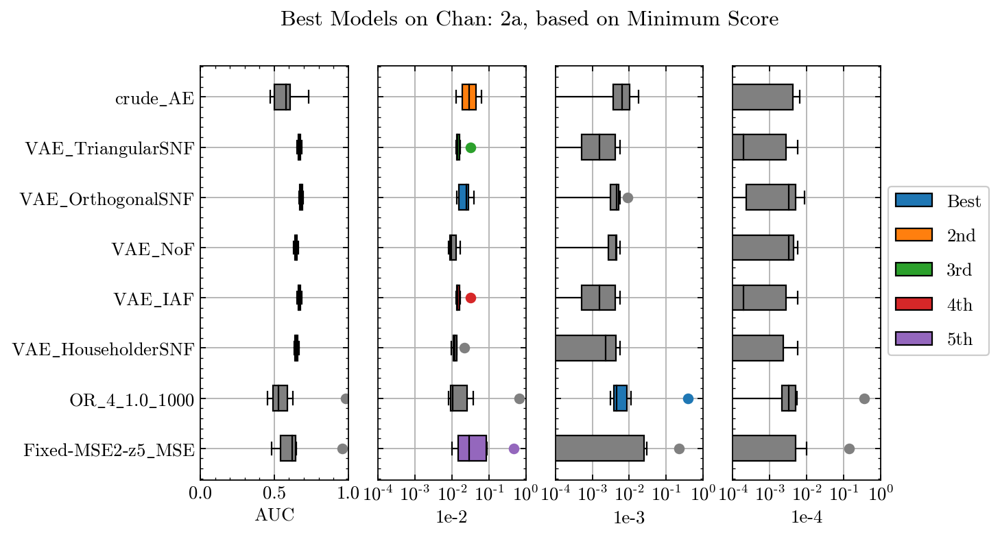

In [59]:
AnalyzeByMethod(AllCombined, 
                Chan='2a', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 1,
                                  '1e-4': 0}, 
                Plot=True
               )

### Chan 2b

****************************************
Models from chan=2b ranked by metric=AUC sorted by MinScore
                  Model  MinScore
291   VAE_OrthogonalSNF  0.845863
292   VAE_TriangularSNF  0.836889
293             VAE_IAF  0.836889
290  VAE_HouseholderSNF  0.822277
289      VAE_PlanarFlow  0.787935
****************************************

****************************************
Models from chan=2b ranked by metric=1e-2 sorted by MinScore
                                               Model  MinScore
476  Combined-PROD_Fixed target KL + Flow Likelihood      0.12
477   Combined-AVG_Fixed target KL + Flow Likelihood      0.12
471                        Flow-Efficient_Likelihood      0.12
472                   Flow-Efficient-No-E_Likelihood      0.11
474   Combined-AND_Fixed target KL + Flow Likelihood      0.11
****************************************

****************************************
Models from chan=2b ranked by metric=1e-3 sorted by MinScore
                             

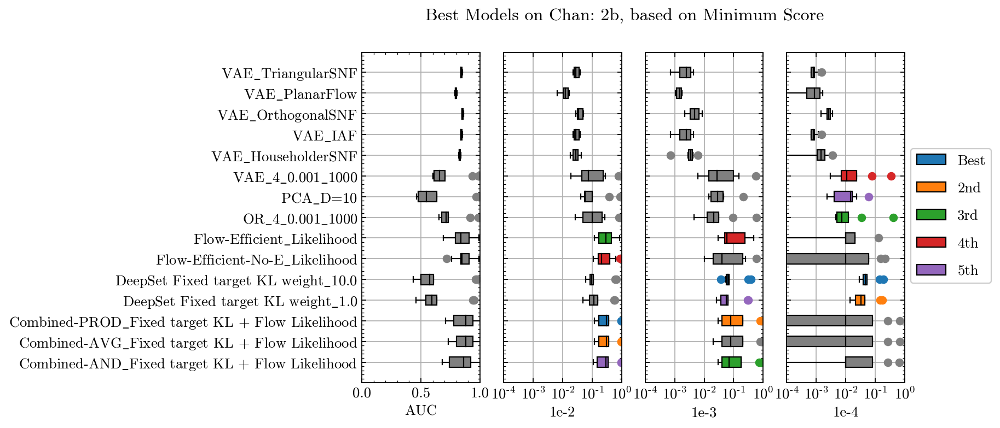

In [60]:
AnalyzeByMethod(AllCombined, 
                Chan='2b', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Chan 3

****************************************
Models from chan=3 ranked by metric=AUC sorted by MinScore
                     Model  MinScore
290     VAE_HouseholderSNF  0.974891
289         VAE_PlanarFlow  0.966551
292      VAE_TriangularSNF  0.956197
291      VAE_OrthogonalSNF  0.938686
294  VAE_ConvolutionalFlow  0.914184
****************************************

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by MinScore
                                               Model  MinScore
477   Combined-AVG_Fixed target KL + Flow Likelihood  0.230000
476  Combined-PROD_Fixed target KL + Flow Likelihood  0.230000
289                                   VAE_PlanarFlow  0.228353
474   Combined-AND_Fixed target KL + Flow Likelihood  0.210000
137                               VAE_20_0.001_10000  0.162512
****************************************

****************************************
Models from chan=3 ranked by metric=1e-3 sorted by MinScore
              

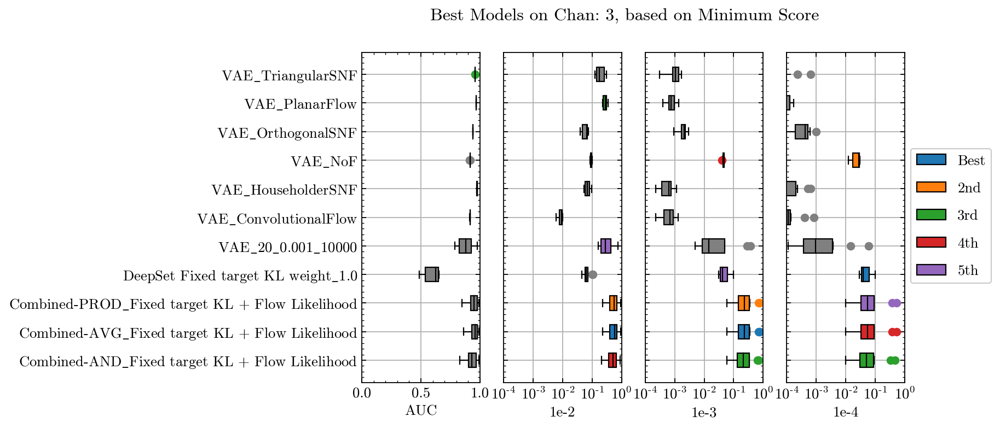

In [61]:
AnalyzeByMethod(AllCombined, 
                Chan='3', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

# Analysis of the Physics Signals

The goal of this part of the analysis is to determine which signals are easy for _most_ models to get and which ones are the most challenging for the unsupervised methods.

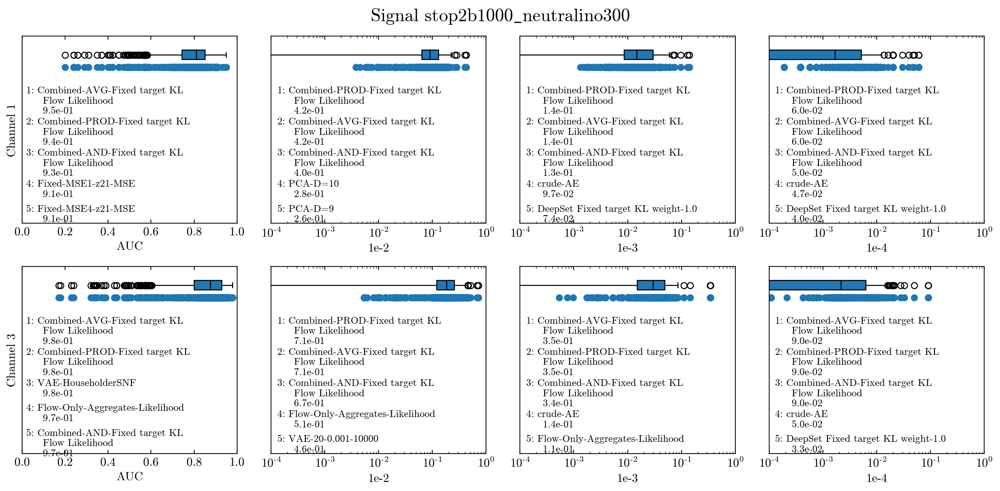

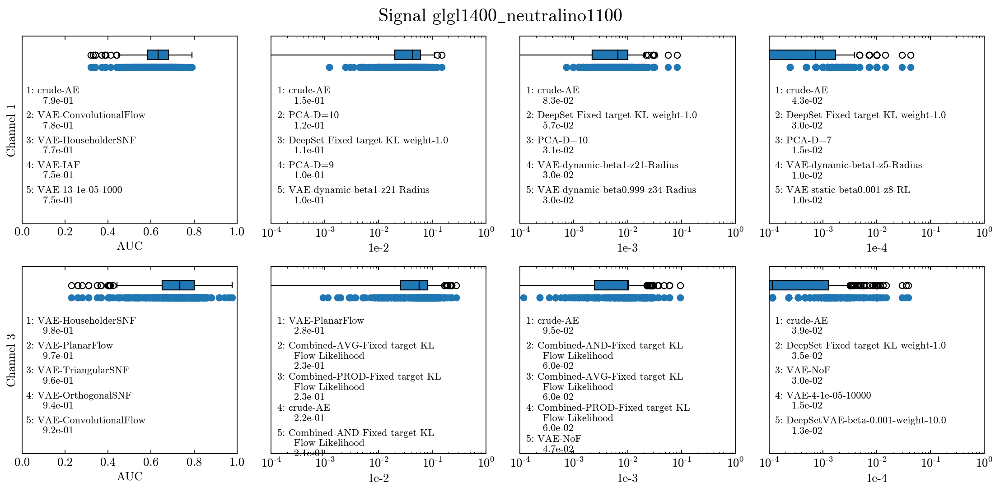

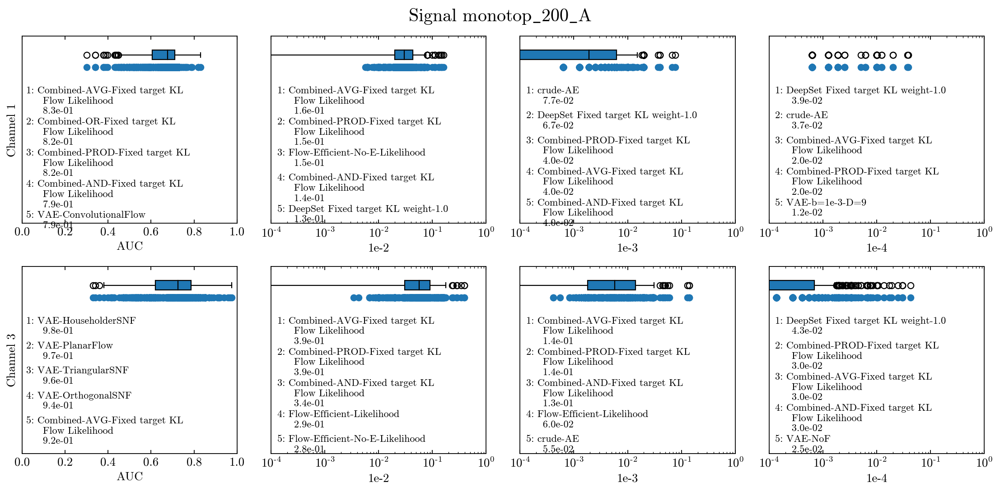

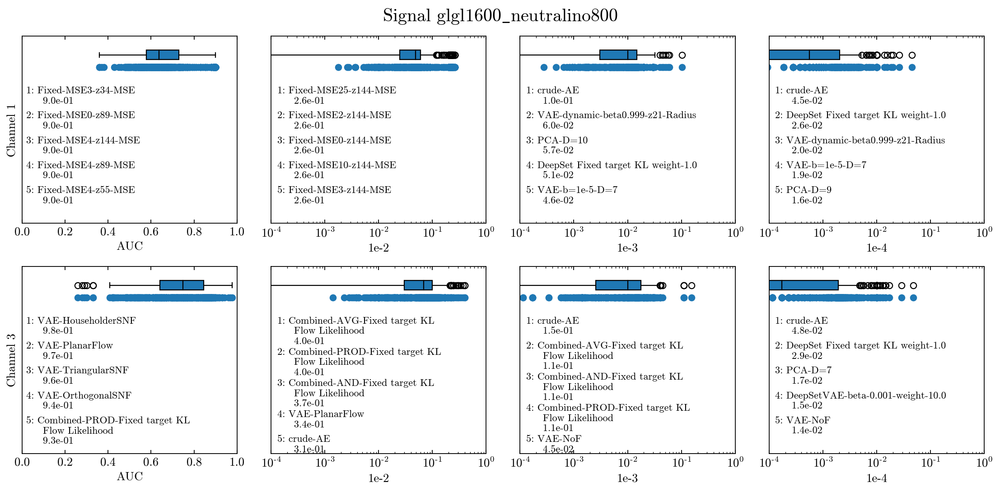

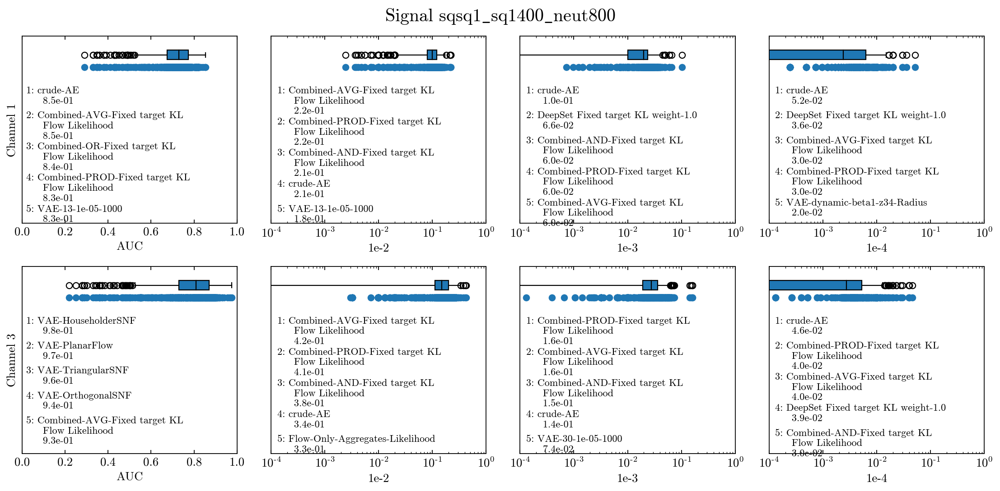

...

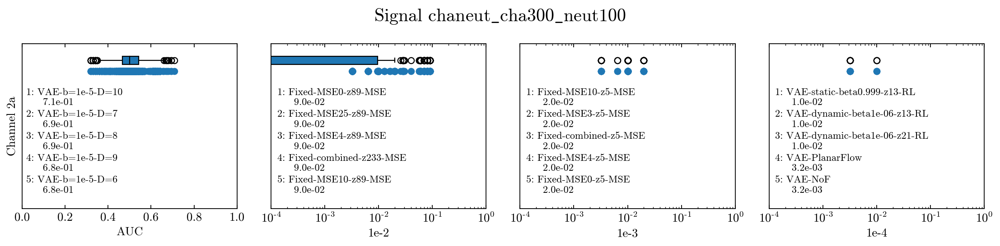

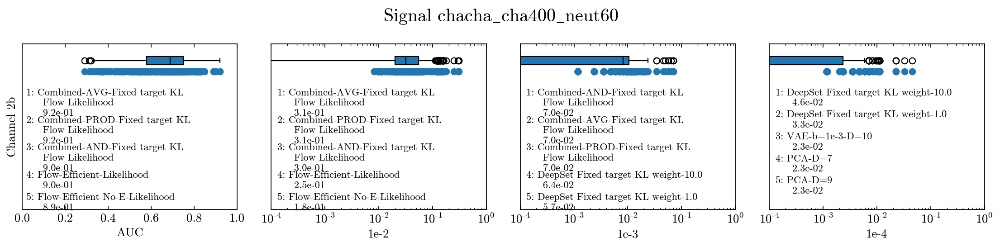

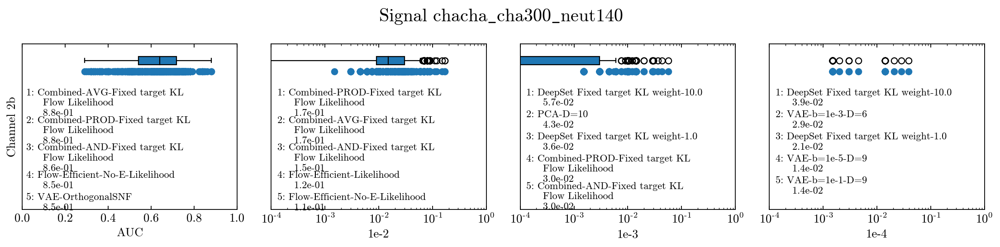

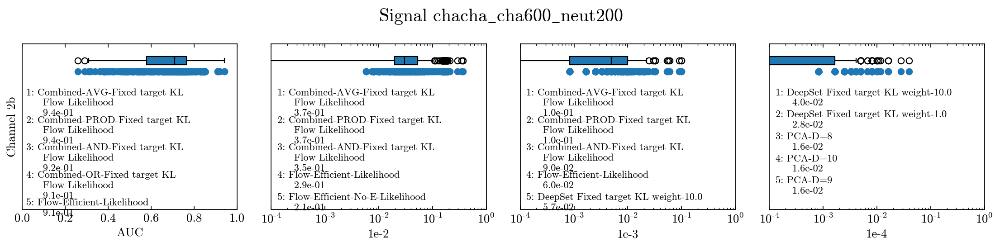

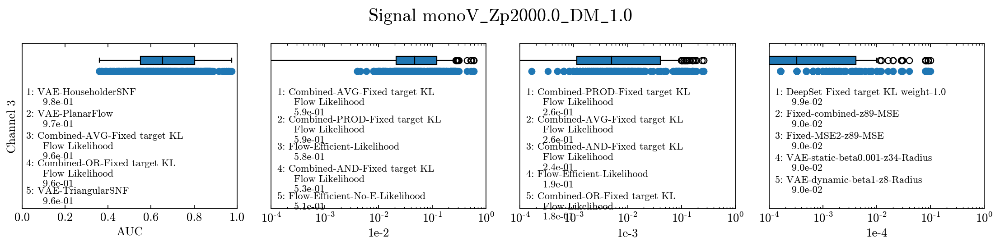

In [62]:
AllSigs = list(AllCombined['Signal'].unique())
for sig in AllSigs:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    plt.figure(figsize=(3.5*4, 3.5*lc))
    
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        for j, metric in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
            plt.subplot(lc, 4, (i*4)+j+1)
            myones = np.ones(len(tmp_df))
            plt.scatter(tmp_df[metric], myones, rasterized=True)
            plt.boxplot(np.array(tmp_df[metric]).reshape(-1, 1),
                        vert=False,
                        manage_ticks=False,
                        patch_artist=True,
                        medianprops={'color':'k'},
                        positions=[1.2]
                       )
            top_models = list(tmp_df.sort_values(by=metric, ascending=False)['Model'][:5])
            plt.ylim(-1.5, 1.5)
            base = 0.7
            for mn in range(5):
                change = 0.4
                mod = top_models[mn]
                if len(mod.split('+')) == 2:
                    change+=0.1
                    
                    
                plt.text(0.02 if metric == 'AUC' else (np.log10(20))*1e-4,
                         base,
                         (f'{mn + 1}: {top_models[mn]}'.replace('+', '\n    ').replace('_','-')) + '\n    ' f" {float(tmp_df[tmp_df['Model']==top_models[mn]][metric]):.1e}",
                         fontsize=10,
                         ha='left',
                         va='top'
                        )
                base -= change
            if metric == 'AUC':
                plt.xlim(0, 1)
                plt.ylabel(f'Channel {chan}')
            else:
                plt.xlim(1e-4, 1)
                plt.xscale('log')
                plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1])
            plt.yticks([])
            plt.xlabel(metric)
    plt.suptitle(f'Signal {sig}'.replace("_", r"$\_$"), fontsize=18, y=0.97)
    plt.tight_layout()
    
    plt.savefig(f'IndividualSignal_{sig}.pdf', bbox_inches='tight')
    plt.show()


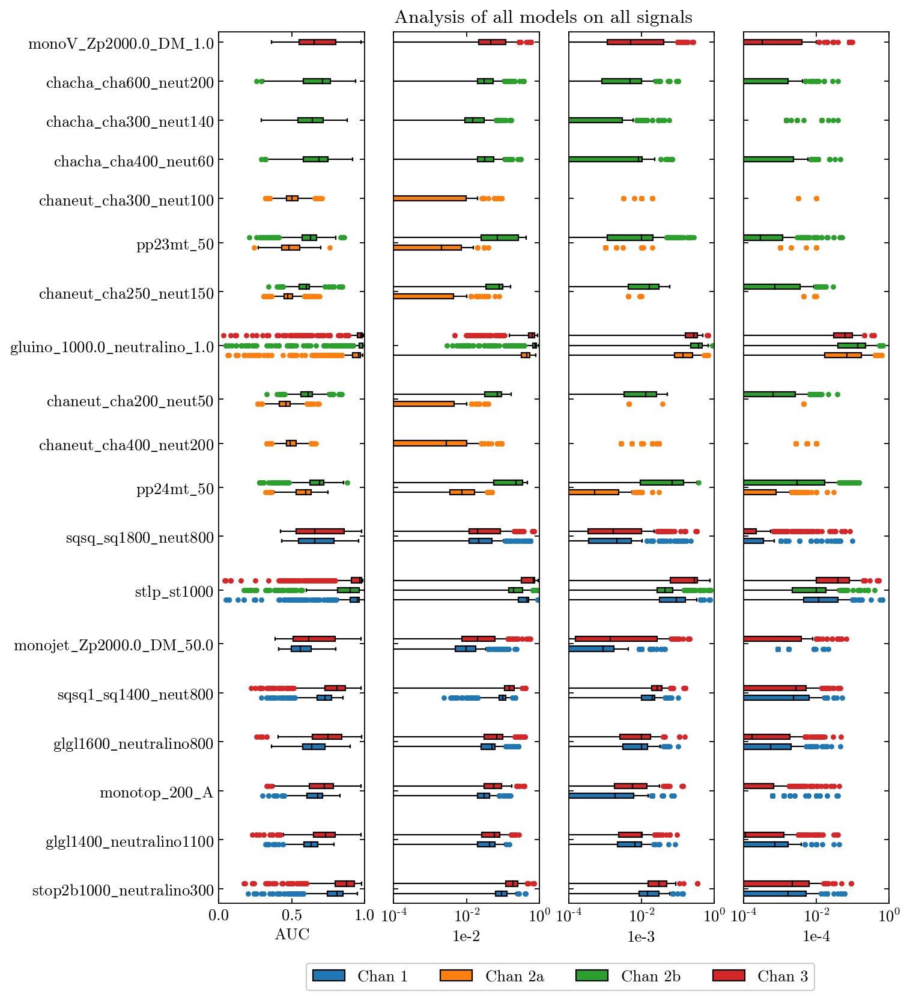

In [63]:
counter = 0
yvs = []
ListAUC = []
List1m2 = []
List1m3 = []
List1m4 = []
my_yticks = []
my_ynames = []
mycolors = []
colordict = {'1': 'C0', '2a': 'C1', '2b': 'C2', '3': 'C3'}
plt.figure(figsize=(9, 12))
for sig in AllSigs:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    
    tmp_yn = []
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        
        ListAUC.append(tmp_df['AUC'])
        List1m2.append(tmp_df['1e-2'])
        List1m3.append(tmp_df['1e-3'])
        List1m4.append(tmp_df['1e-4'])
        yvs.append(counter)
        tmp_yn.append(counter)
        counter += 1
        mycolors.append(colordict[chan])
    counter += 3
    my_yticks.append(np.mean(tmp_yn))
    my_ynames.append(sig.replace('_', '$\_$'))
plt.subplot(1, 4, 1)    
bbox1 = plt.boxplot(np.array(ListAUC).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xlim(0, 1)
plt.yticks(my_yticks, my_ynames)
plt.xlabel('AUC')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 2)    
bbox1 = plt.boxplot(np.array(List1m2).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
plt.xlabel('1e-2')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 3)    
bbox1 = plt.boxplot(np.array(List1m3).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
plt.xlabel('1e-3')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 4)    
bbox1 = plt.boxplot(np.array(List1m4).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.xlabel('1e-4')
plt.ylim(min(yvs)-1, max(yvs)+1)
    
    
legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Chan 1'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='Chan 2a'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='Chan 2b'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='Chan 3')
                  ]
plt.legend(handles=legend_elements, 
           loc=(-3, -0.1), 
           labelspacing=1,
           ncol=4,
           facecolor='white',
           framealpha=1,
#            markerscale=100,
           frameon=True)
    
plt.suptitle('Analysis of all models on all signals', y=0.9)
plt.savefig('../reports/Plots/AllModelsAllSignals.pdf', bbox_inches='tight')
plt.show()


# Summary of the summaries
To this point, it is still not obvious what the best model or metric is. To this end, we now define the significance improvement as 

$\rm{Base~Significance} = \frac{N_S }{N_B} = \frac{\sigma_S}{\sqrt{\sigma_B}}$

$\rm{Significance} = \rm{Significance~Improvement}\times\rm{Base~Significance} = \frac{N_S^{\rm{cut}}}{N_B^{\rm{cut}}} = \frac{\epsilon_S * \sigma_S}{\sqrt{\epsilon_B * \sigma_B}} = \frac{\epsilon_S }{\sqrt{\epsilon_B }} \times \rm{Base~Significance}$

In [66]:
AllCombined['SI_1e-2'] = AllCombined['1e-2'] / np.sqrt(1e-2)
AllCombined['SI_1e-3'] = AllCombined['1e-3'] / np.sqrt(1e-3)
AllCombined['SI_1e-4'] = AllCombined['1e-4'] / np.sqrt(1e-4)

AllCombined['SI_All'] = AllCombined[['SI_1e-2', 'SI_1e-3', 'SI_1e-4']].max(axis=1)

In [67]:
AllCombined.sort_values(by='SI_All', ascending=False)

,Signal,Model,Chan,AUC,1e-2,1e-3,1e-4,SI_1e-2,SI_1e-3,SI_1e-4,SI_All
16207,gluino_1000.0_neutralino_1.0,Combined-AVG_Fixed target KL + Flow Likelihood,2b,1,0.98,0.91,0.68,9.8,28.7767,68,68.0
16206,gluino_1000.0_neutralino_1.0,Combined-PROD_Fixed target KL + Flow Likelihood,2b,1,0.98,0.91,0.68,9.8,28.7767,68,68.0
16204,gluino_1000.0_neutralino_1.0,Combined-AND_Fixed target KL + Flow Likelihood,2b,1,0.97,0.88,0.66,9.7,27.828,66,66.0
16139,stlp_st1000,Combined-AVG_Fixed target KL + Flow Likelihood,1,1,0.93,0.76,0.64,9.3,24.0333,64,64.0
16138,stlp_st1000,Combined-PROD_Fixed target KL + Flow Likelihood,1,0.99,0.92,0.76,0.64,9.2,24.0333,64,64.0
...,...,...,...,...,...,...,...,...,...,...,...
13328,chaneut_cha300_neut100,VAE-dynamic-beta0.999-z21_RL,2a,0.54,0,0,0,0,0,0,0.0
16168,chaneut_cha200_neut50,Combined-AND_Fixed target KL + Flow Likelihood,2a,0.48,0,0,0,0,0,0,0.0
16169,chaneut_cha200_neut50,Combined-OR_Fixed target KL + Flow Likelihood,2a,0.37,0,0,0,0,0,0,0.0
16170,chaneut_cha200_neut50,Combined-PROD_Fixed target KL + Flow Likelihood,2a,0.45,0,0,0,0,0,0,0.0


In [68]:
AllMods = list(AllCombined['Model'].unique())
SI_DF = pd.DataFrame()
SI_DF['Model'] = AllMods

for sig in AllSigs:
    si_list = []
    for mod in AllMods:
        tmp_df = AllCombined[(AllCombined['Model'] == mod)]
        si_list.append(tmp_df[tmp_df['Signal'] == sig]['SI_All'].max())
    SI_DF[sig] = si_list
#     plt.scatter(np.min(si_list), np.max(si_list))
# plt.show()

In [69]:
SI_DF['MinSigI'] = SI_DF[[col for col in SI_DF if 'Model' not in col]].min(axis=1)
SI_DF['MaxSigI'] = SI_DF[[col for col in SI_DF if (('Model' not in col) and ('MinSigI' not in col))]].max(axis=1)
SI_DF['MedianSigI'] = SI_DF[[col for col in SI_DF if (('Model' not in col) and ('MinSigI' not in col) and ('MaxSigI' not in col))]].median(axis=1)

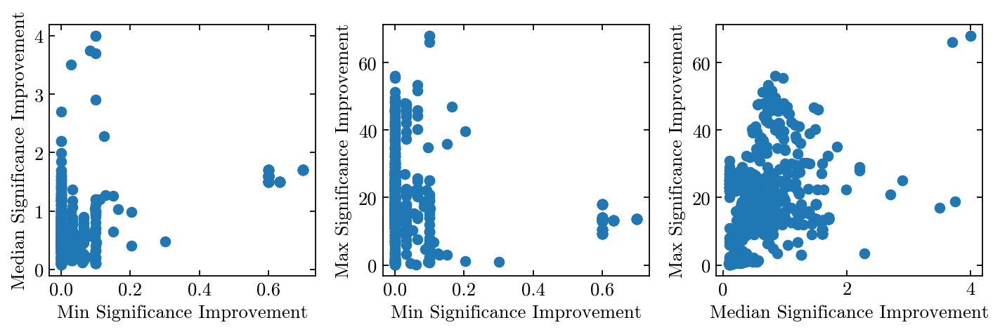

In [70]:
plt.figure(figsize=(9, 3))

plt.subplot(1, 3, 1)
plt.scatter(SI_DF['MinSigI'], SI_DF['MedianSigI'])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')

plt.subplot(1, 3, 2)
plt.scatter(SI_DF['MinSigI'], SI_DF['MaxSigI'])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.subplot(1, 3, 3)
plt.scatter(SI_DF['MedianSigI'], SI_DF['MaxSigI'])
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.tight_layout()

In [71]:
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import MinMaxScaler

In [72]:
normed_data=SI_DF[['MinSigI', 'MedianSigI', 'MaxSigI']].copy()
mms = MinMaxScaler()
normed_data = mms.fit_transform(normed_data)

In [103]:
kmint = 6
km = KMeans(n_clusters=kmint, random_state=0)

In [104]:
SI_DF['km4'] = km.fit_predict(normed_data)

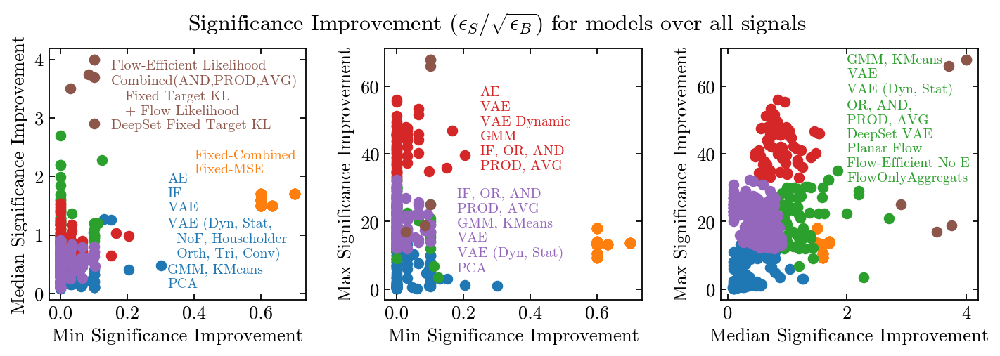

In [108]:
plt.figure(figsize=(9, 3))

plt.subplot(1, 3, 1)
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km4']==i]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MedianSigI'], color=f'C{i}', rasterized=True)
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')
plt.text(0.4, 2, 'Fixed-Combined\nFixed-MSE', ha='left', va='bottom', fontsize=9, color='C1')
plt.text(0.15, 4, 'Flow-Efficient Likelihood\nCombined(AND,PROD,AVG)\n   Fixed Target KL\n   + Flow Likelihood'+\
         '\nDeepSet Fixed Target KL'
         , ha='left', va='top', fontsize=9, color='C5')
plt.text(0.32, 0.05, 'AE\nIF\nVAE\nVAE (Dyn, Stat,\n  NoF, Householder\n  Orth, Tri, Conv)\nGMM, KMeans\nPCA', ha='left', va='bottom', fontsize=9, color='C0')

plt.subplot(1, 3, 2)
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km4']==i]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MaxSigI'], color=f'C{i}', rasterized=True)
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')
plt.text(0.25, 60, 'AE\nVAE\nVAE Dynamic\nGMM\nIF, OR, AND\nPROD, AVG', ha='left', va='top', fontsize=9, color='C3')
plt.text(0.18, 30, 'IF, OR, AND\nPROD, AVG\nGMM, KMeans\nVAE\nVAE (Dyn, Stat)\nPCA', ha='left', va='top', fontsize=9, color='C4')


plt.subplot(1, 3, 3)
for i in range(kmint):
    tmpdf=SI_DF[SI_DF['km4']==i]
    plt.scatter(tmpdf['MedianSigI'], tmpdf['MaxSigI'], color=f'C{i}', rasterized=True)
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')
plt.text(2.0 , 31, 'GMM, KMeans\nVAE\nVAE (Dyn, Stat)\nOR, AND,\nPROD, AVG\nDeepSet VAE\nPlanar Flow\nFlow-Efficient No E\nFlowOnlyAggregats', ha='left', va='bottom', fontsize=9, color='C2')


plt.tight_layout()
plt.suptitle('Significance Improvement' + ' $(\epsilon_S / \sqrt{\epsilon_B})$' + ' for models over all signals' , y=1.05)

plt.savefig('SummaryOfSummaries.pdf', bbox_inches='tight')
plt.show()

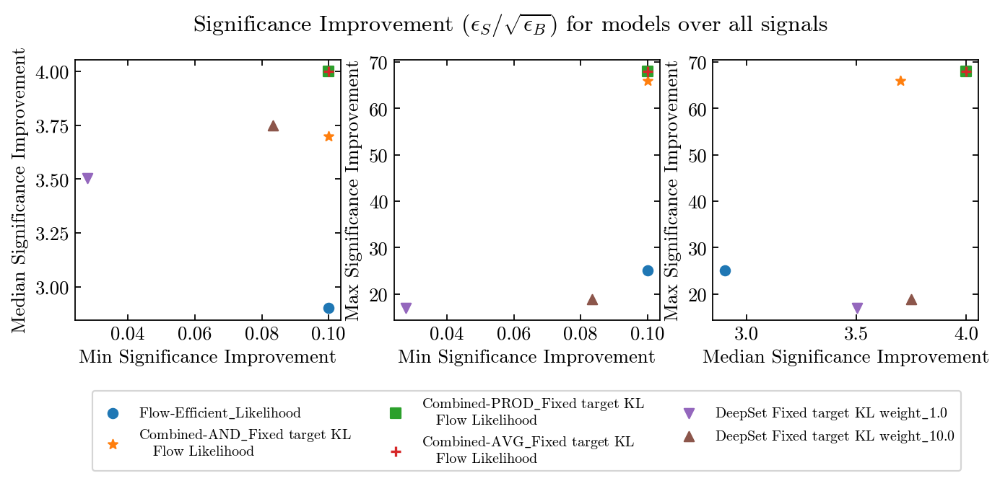

In [109]:
plt.figure(figsize=(9, 4))
gs0 = gs.GridSpec(2, 1, height_ratios=[3, 1])
gs00 = gs.GridSpecFromSubplotSpec(1, 3, gs0[0])
i=5
plt.subplot(gs00[0])
markerdict = {0: 'o',
              1: '*',
              2: 's',
              3: '+',
              4: 'v',
              5: '^'
             }

tmpdf=SI_DF[SI_DF['km4']==i]
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter(tmpdf2['MinSigI'], tmpdf2['MedianSigI'], color=f'C{kk}',
                marker=markerdict[kk]
               )
#     plt.text(tmpdf2['MinSigI'], tmpdf2['MedianSigI'], mod.replace('VAE_beta_1.0', 'Fixed KL').replace('+', '\n'),
#              fontsize=8,
#              ha='left' if float(tmpdf2['MinSigI']) < 0.04 else 'right'
#             )
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')

plt.subplot(gs00[1])

tmpdf=SI_DF[SI_DF['km4']==i]
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter(tmpdf2['MinSigI'], tmpdf2['MaxSigI'], color=f'C{kk}', label=mod.replace('VAE_beta_1.0', '-Fixed KL').replace('_', r'$\_$').replace('+', '\n'),
               marker=markerdict[kk])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')

# legend_elements = [Patch(facecolor='C0', edgecolor='k',
#                          label=),
#                    Patch(facecolor='C1', edgecolor='k',
#                          label='Chan 2a'),
#                    Patch(facecolor='C2', edgecolor='k',
#                          label='Chan 2b'),
#                    Patch(facecolor='C3', edgecolor='k',
#                          label='Chan 3')
#                   ]
# plt.legend(labelspacing=1,
# #            ncol=1,
#            facecolor='white',
#            framealpha=1,
#            fontsize=9,
# #            markerscale=100,
#            frameon=True)

plt.subplot(gs00[2])

tmpdf=SI_DF[SI_DF['km4']==i]
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter(tmpdf2['MedianSigI'], tmpdf2['MaxSigI'], 
                color=f'C{kk}',
                marker=markerdict[kk]
               )
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.subplot(gs0[1])
for kk, mod in enumerate(list(tmpdf['Model'])):
    tmpdf2=tmpdf[tmpdf['Model'] == mod]
    plt.scatter([], [], color=f'C{kk}',
                marker=markerdict[kk],
                label=mod.replace('VAE_beta_1.0', '-Fixed KL').replace('_', r'$\_$').replace('+', '\n  '),
               )
plt.legend(fontsize=9,
           loc='center',
           ncol=3
          )
plt.axis('off')

plt.tight_layout()
plt.suptitle('Significance Improvement' + ' $(\epsilon_S / \sqrt{\epsilon_B})$' + ' for models over all signals' , y=1.05)

plt.savefig('SummaryOfSummaries_best.pdf', bbox_inches='tight')
plt.show()

In [98]:
list(SI_DF[SI_DF['km4']==1]['Model'])

['IF_20_1e-05_10000',
 'IF_4_0.001_10000',
 'IF_4_1e-05_1000',
 'GMM_30_0.1_1000',
 'GMM_4_0.1_10000',
 'AE_4_1e-05_1000',
 'KMeans_13_0.1_1000',
 'KMeans_20_0.1_1000',
 'KMeans_30_0.1_1000',
 'KMeans_30_0.1_10000',
 'KMeans_4_0.1_1000',
 'KMeans_4_0.1_10000',
 'KMeans_4_1e-05_10000',
 'VAE_13_0.1_1000',
 'VAE_13_0.1_10000',
 'VAE_20_0.1_1000',
 'VAE_20_0.1_10000',
 'VAE_30_0.1_1000',
 'VAE_4_0.1_1000',
 'VAE_4_0.1_10000',
 'VAE_NoF',
 'VAE_HouseholderSNF',
 'VAE_OrthogonalSNF',
 'VAE_TriangularSNF',
 'VAE_IAF',
 'VAE_ConvolutionalFlow',
 'PCA_D=2',
 'PCA_D=3',
 'VAE_b=1e-5_D=2',
 'VAE_b=1e-5_D=3',
 'VAE_b=1e-5_D=4',
 'VAE_b=1e-5_D=5',
 'VAE_b=1e-5_D=6',
 'VAE_b=1e-5_D=7',
 'VAE_b=1e-5_D=8',
 'VAE_b=1e-5_D=9',
 'VAE_b=1e-5_D=10',
 'VAE_b=1e-3_D=2',
 'VAE_b=1e-3_D=3',
 'VAE_b=1e-3_D=4',
 'VAE_b=1e-3_D=5',
 'VAE_b=1e-3_D=6',
 'VAE_b=1e-3_D=7',
 'VAE_b=1e-3_D=8',
 'VAE_b=1e-3_D=9',
 'VAE_b=1e-3_D=10',
 'VAE_b=1e-1_D=2',
 'VAE_b=1e-1_D=3',
 'VAE_b=1e-1_D=4',
 'VAE_b=1e-1_D=5',
 'VAE_b=1e-1

Check to see if another clustering algorithm will help

4 clusters found


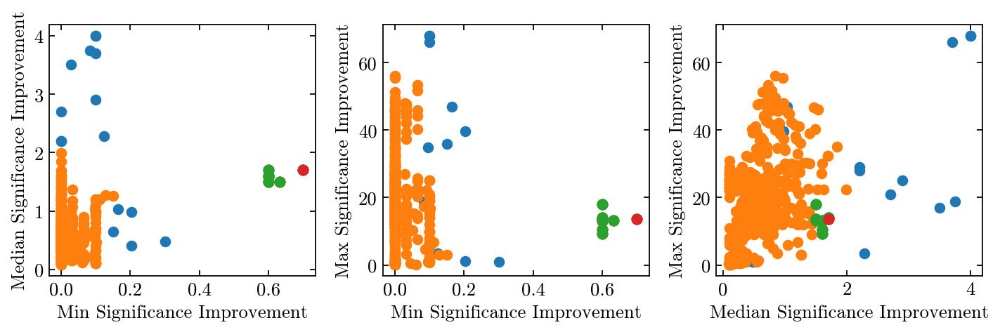

In [110]:
db = DBSCAN(min_samples=5, eps=0.1)
SI_DF['db'] = db.fit_predict(normed_data)
lendb = len(SI_DF['db'].unique())
print(f'{lendb} clusters found')
plt.figure(figsize=(9, 3))

plt.subplot(1, 3, 1)
for i in range(-1, lendb):
    tmpdf=SI_DF[SI_DF['db']==i]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MedianSigI'])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Median Significance Improvement')

plt.subplot(1, 3, 2)
for i in range(-1, lendb):
    tmpdf=SI_DF[SI_DF['db']==i]
    plt.scatter(tmpdf['MinSigI'], tmpdf['MaxSigI'])
plt.xlabel('Min Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.subplot(1, 3, 3)
for i in range(-1, lendb):
    tmpdf=SI_DF[SI_DF['db']==i]
    plt.scatter(tmpdf['MedianSigI'], tmpdf['MaxSigI'])
plt.xlabel('Median Significance Improvement')
plt.ylabel('Max Significance Improvement')

plt.tight_layout()